## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---

## Packages

In [4]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from ipywidgets import interact, interactive, fixed

%matplotlib inline

## Compute the camera calibration using chessboard images

The images are in the `./camera_cal` folder. Use the CV2 `findChessboardCorners` function to find the corners and add them to the image points list. We can then use this list and the list of object points in the CV2 `calibrateCamera` function to get the camera distortion coefficients.

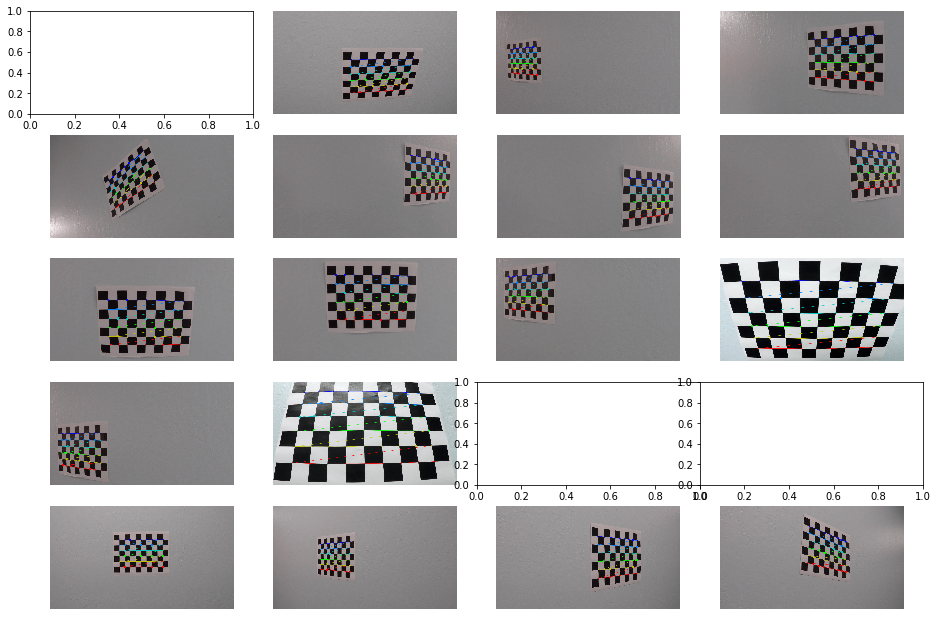

In [5]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

fig, axs = plt.subplots(5,4, figsize=(16, 11))
fig.subplots_adjust(hspace = .2, wspace=.001)
axs = axs.ravel()

# Step through the list and search for chessboard corners

for i, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        
        axs[i].axis('off')
        axs[i].imshow(img)

*** Note that some of the images do not show because the chessboard corners were not found (ret == False).

### Calculate the disortion coefficients

In [50]:
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

print("Camera Matrix")
print(mtx)
print("Distortion Coeffs")
print(dist)

Camera Matrix
[[  1.15396093e+03   0.00000000e+00   6.69705357e+02]
 [  0.00000000e+00   1.14802496e+03   3.85656234e+02]
 [  0.00000000e+00   0.00000000e+00   1.00000000e+00]]
Distortion Coeffs
[[ -2.41017956e-01  -5.30721173e-02  -1.15810355e-03  -1.28318856e-04
    2.67125290e-02]]


### Helper function to apply the distortion correction to an image

In [7]:
def undistort(img, mtx, dist):
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

### Example of applying distortion correction to an image

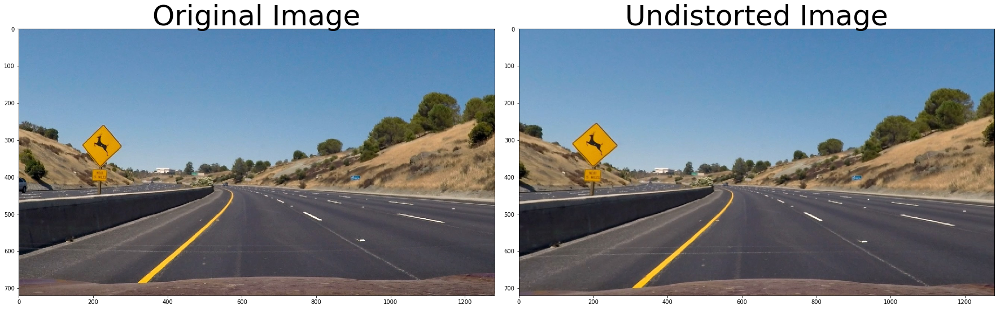

In [5]:
fname = './test_images/test2.jpg'

img = mpimg.imread(fname)

# Use the undistort function, with the mtx and dist calculated above
undist = undistort(img, mtx, dist)

### print an example plot of a comparison of a distorted and undistorted image
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undist)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

The undistorted image looks different around the sign and on the hood of the car.

# Perspective Transform

#### Helper function to add lines to an image
this will help us view the prospective transforms

In [8]:
def add_points(img, src):
    img2 = np.copy(img)
    color = [255, 0, 0] # Red
    thickness = 2
    x0, y0 = src[0]
    x1, y1 = src[1]
    x2, y2 = src[2]
    x3, y3 = src[3]
    cv2.line(img2, (x0, y0), (x1, y1), color, thickness)
    cv2.line(img2, (x1, y1), (x2, y2), color, thickness)
    cv2.line(img2, (x2, y2), (x3, y3), color, thickness)
    cv2.line(img2, (x3, y3), (x0, y0), color, thickness)
    return img2

#### Function to warp images based on source and destination points

In [9]:
def warper(img):

    # Points for the original image
    src = np.float32([
        [250, 675],
        [590, 450], 
        [690, 450], 
        [1055, 675]
    ])

    # Points for the new image
    dst = np.float32([
        [250, 750],
        [250, 0], 
        [1035, 0], 
        [1035, 750]
    ])
    
    # Compute and apply perpective transform
    img_size = (img.shape[1], img.shape[0])
    M = cv2.getPerspectiveTransform(src, dst)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_NEAREST)  # keep same size as input image

    return warped

#### Generate warped perspectives for the straight lines to calibrate the points

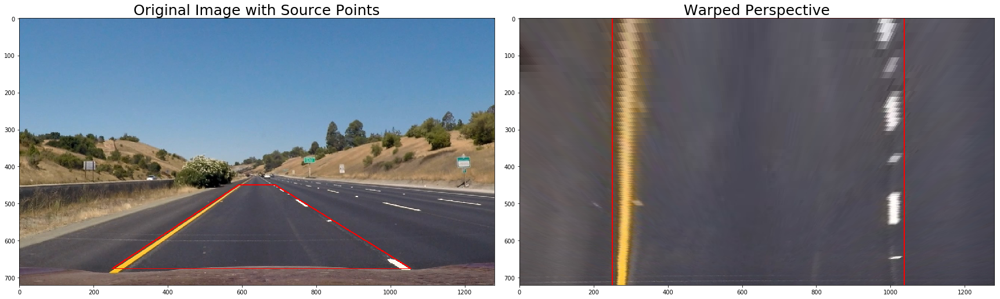

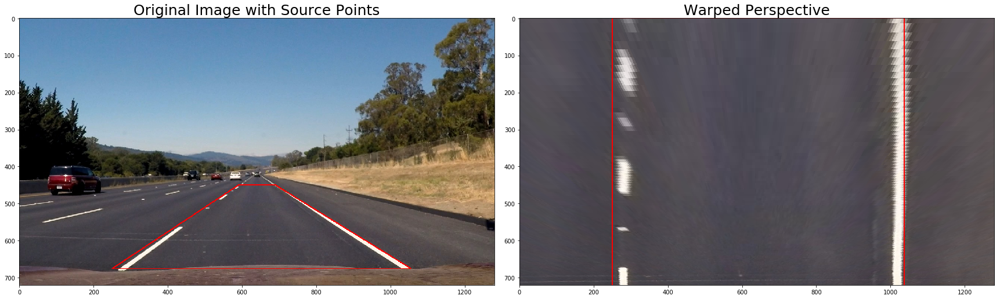

In [20]:
### get the straight test images from the test_images folder
images = glob.glob('./test_images/straight*.jpg')

for fname in images:
    
    img = mpimg.imread(fname)
    
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)
    
    # warp the image
    warped = warper(undist)

    # add the points to the og and warped images 
    src_points_img = add_points(img, src)
    dst_points_warped = add_points(warped, dst)

    ### Plot the source points on the original image and the warped image
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(src_points_img)
    ax1.set_title('Original Image with Source Points', fontsize=25)
    ax2.imshow(dst_points_warped)
    ax2.set_title('Warped Perspective', fontsize=25)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


#### Run these settings over all the images and take a look

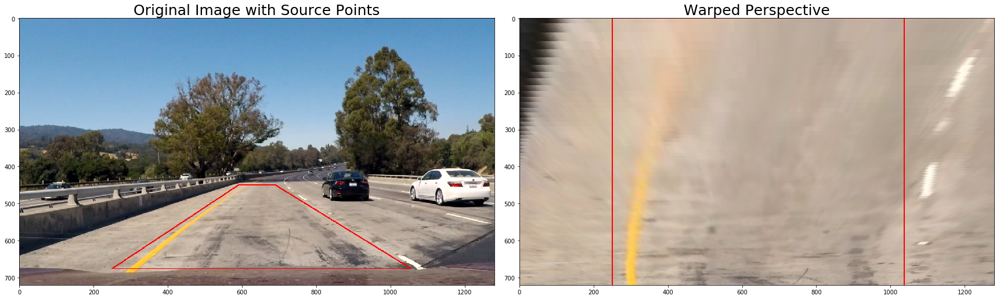

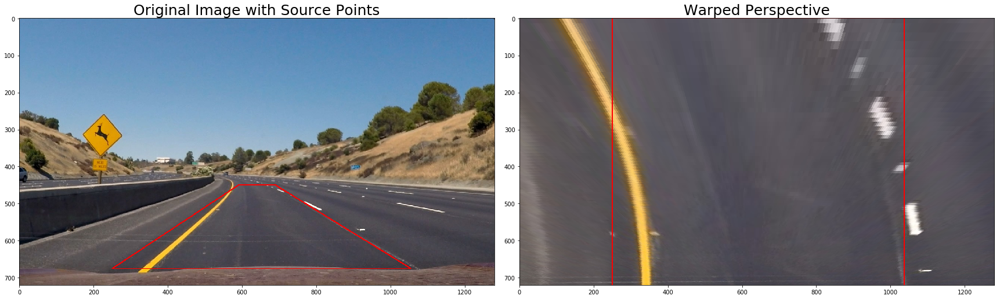

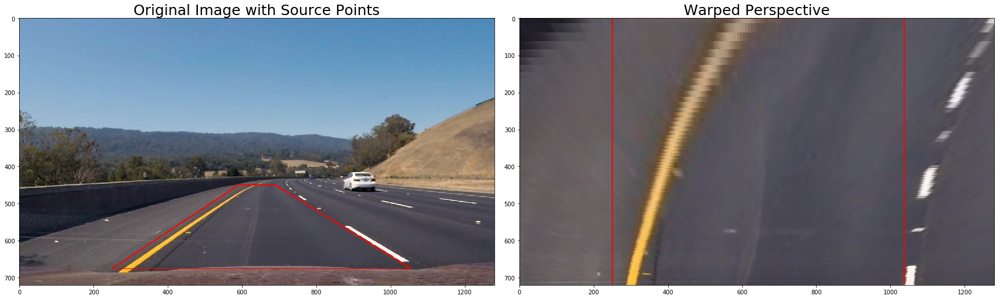

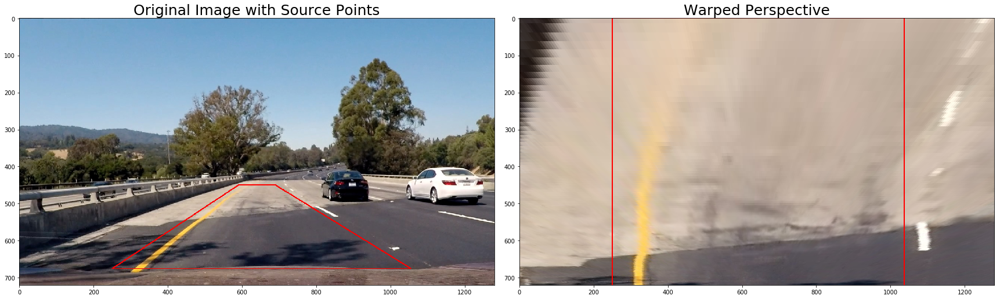

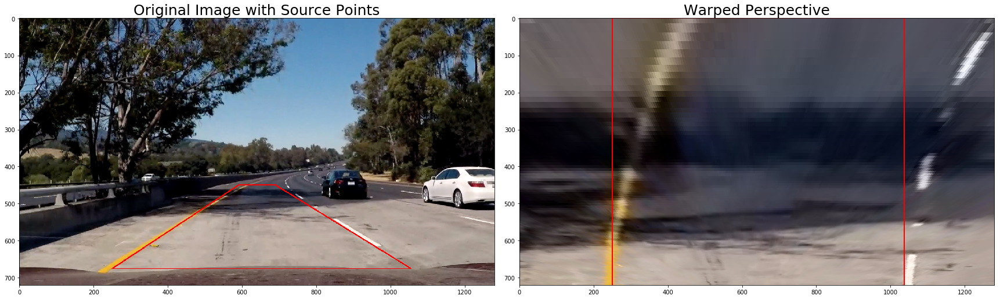

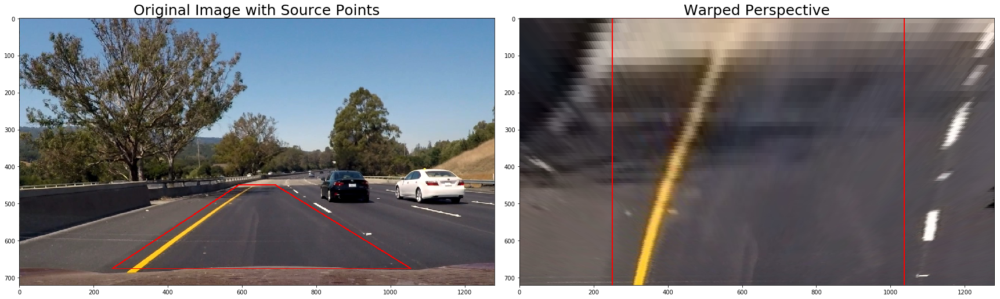

In [21]:
### get the straight test images from the test_images folder
images = glob.glob('./test_images/test*.jpg')

for fname in images:
    
    img = mpimg.imread(fname)
    
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)

    # warp the image
    warped = warper(undist)

    # add the points to the og and warped images 
    src_points_img = add_points(img, src)
    dst_points_warped = add_points(warped, dst)

    ### Plot the source points on the original image and the warped image
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(src_points_img)
    ax1.set_title('Original Image with Source Points', fontsize=25)
    ax2.imshow(dst_points_warped)
    ax2.set_title('Warped Perspective', fontsize=25)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

That looks pretty good! We're capturing most of the line information with the transform

# Investigation for binary threshold images

Loop through all the test images and take a look at the different channels for each type of color (RGB, HLS, HSV) to try and see which ones might work best for the binary thresholding

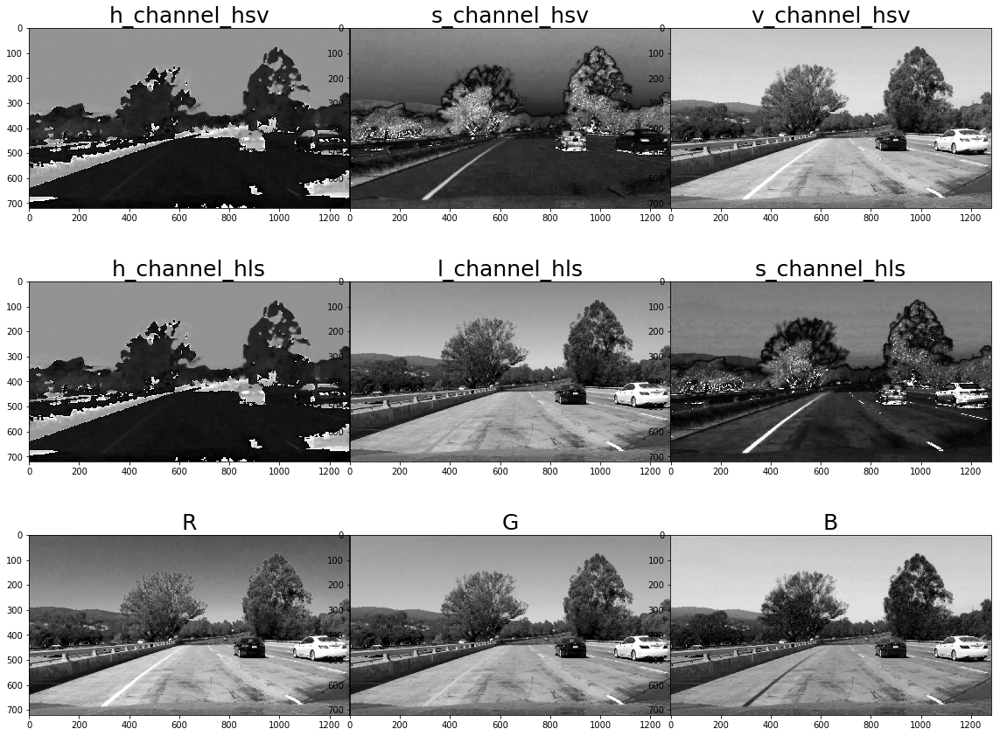

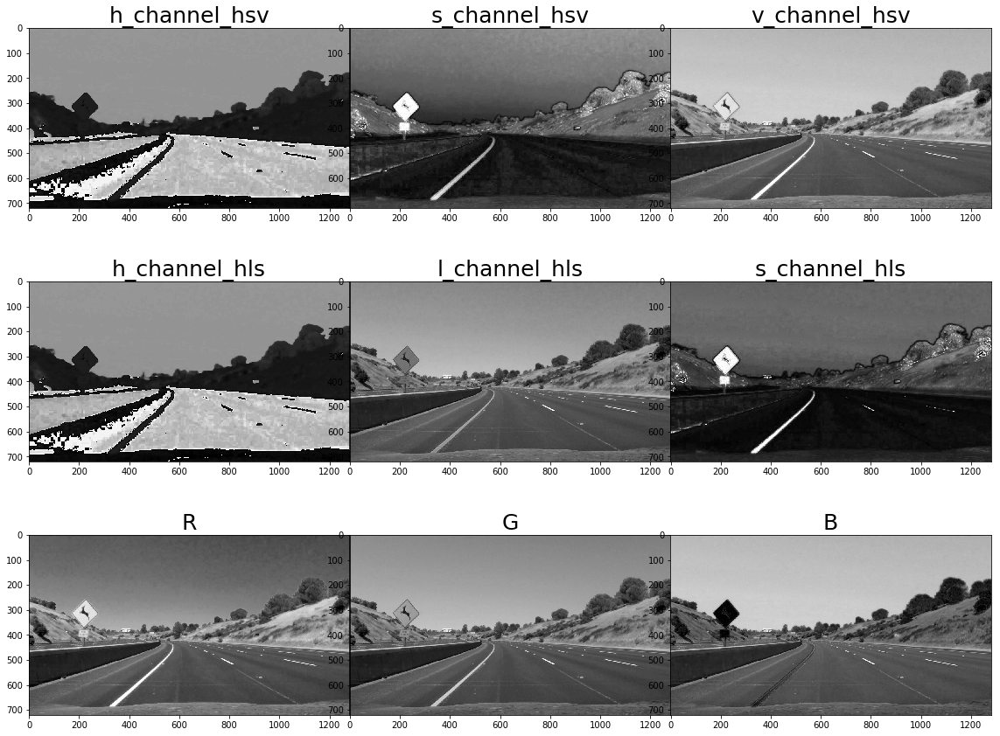

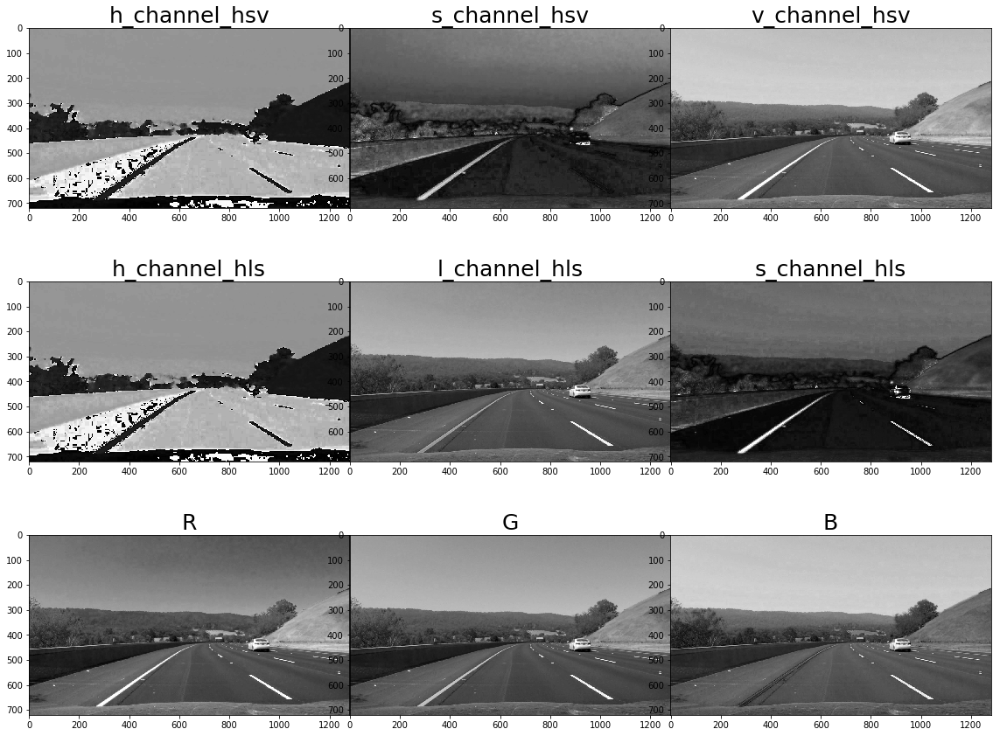

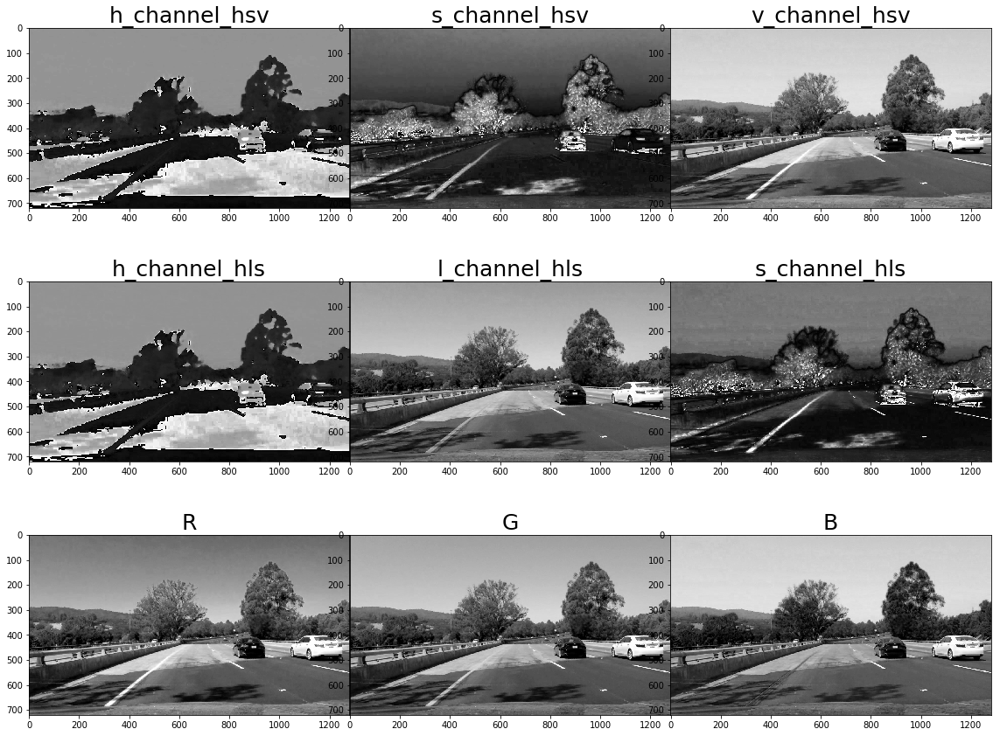

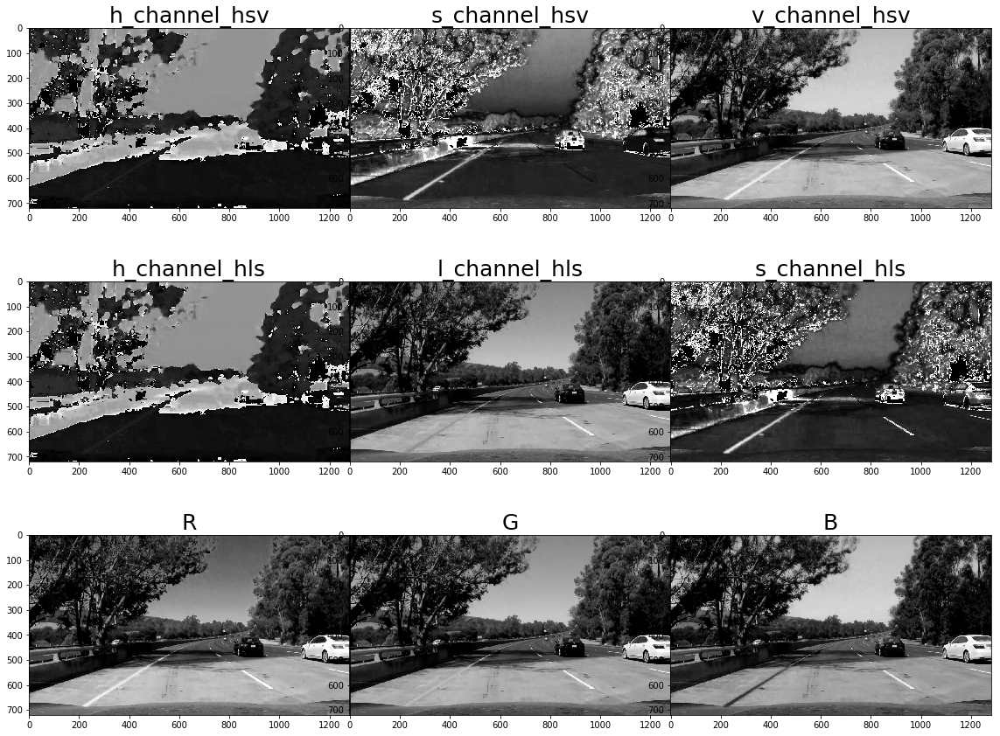

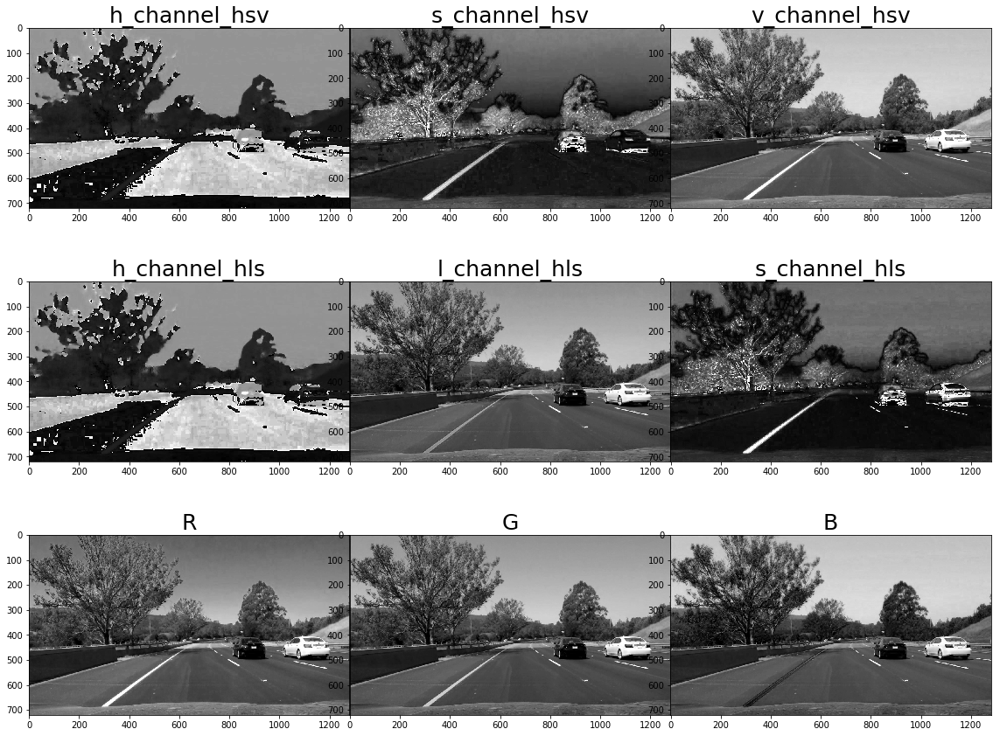

In [12]:
### get the test images from the test_images folder
images = glob.glob('./test_images/test*.jpg')

### Loop through each image and send it to the pipeline
for fname in images:
    
    img = mpimg.imread(fname)

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY).astype(np.float)

    # Separate the RGB
    R = img[:,:,0]
    G = img[:,:,1]
    B = img[:,:,2]

    # Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    h_channel_hls = hls[:,:,0]
    l_channel_hls = hls[:,:,1]
    s_channel_hls = hls[:,:,2]

    # Convert to HSV color space
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV).astype(np.float)
    h_channel_hsv = hsv[:,:,0]
    s_channel_hsv = hsv[:,:,1]
    v_channel_hsv = hsv[:,:,2]

    ### Plot the source points on the original image and the warped image
    f, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3, 3, figsize=(16, 12))
    f.tight_layout()

    # Plot HSV colors
    ax1.imshow(h_channel_hsv, cmap='gray')
    ax1.set_title('h_channel_hsv', fontsize=25)
    ax2.imshow(s_channel_hsv, cmap='gray')
    ax2.set_title('s_channel_hsv', fontsize=25)
    ax3.imshow(v_channel_hsv, cmap='gray')
    ax3.set_title('v_channel_hsv', fontsize=25)
    
    # Plot HLS colors
    ax4.imshow(h_channel_hls, cmap='gray')
    ax4.set_title('h_channel_hls', fontsize=25)
    ax5.imshow(l_channel_hls, cmap='gray')
    ax5.set_title('l_channel_hls', fontsize=25)
    ax6.imshow(s_channel_hls, cmap='gray')
    ax6.set_title('s_channel_hls', fontsize=25)

    # Plot RGB
    ax7.imshow(R, cmap='gray')
    ax7.set_title('R', fontsize=25)
    ax8.imshow(G, cmap='gray')
    ax8.set_title('G', fontsize=25)
    ax9.imshow(B, cmap='gray')
    ax9.set_title('B', fontsize=25)

    plt.subplots_adjust(hspace = .2, wspace=.001)


From these images, it looks like the saturation channels could provide good data, also the V from HSV and the L from HLS. The Red channel from RGB could be promising as well.

### Do the same thing, but look at images with perspective transform

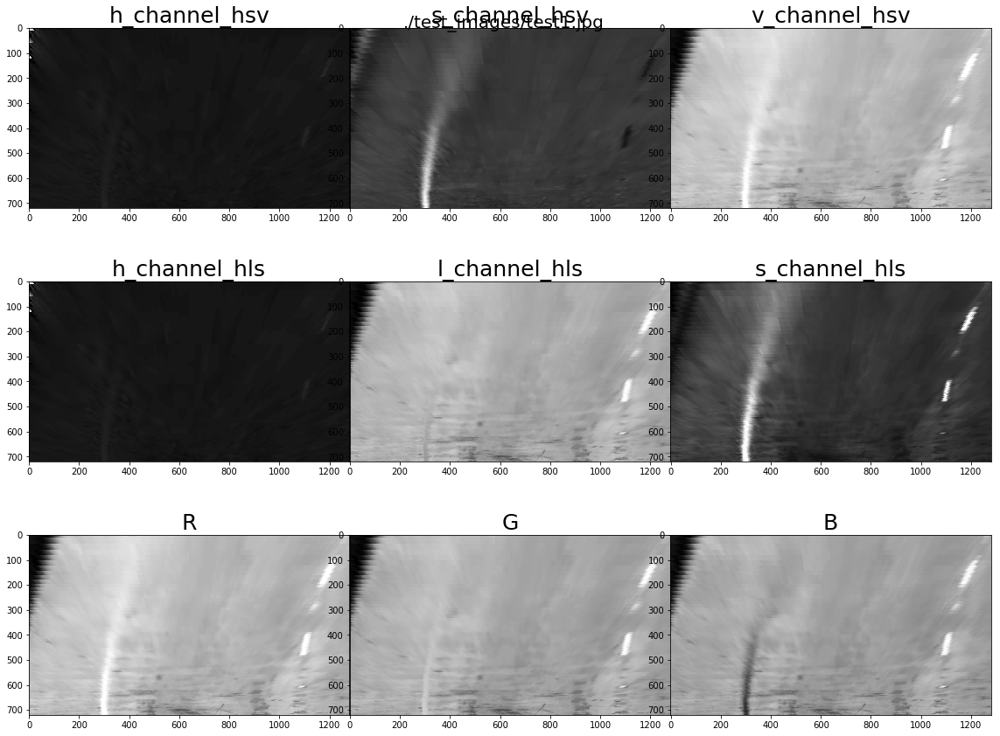

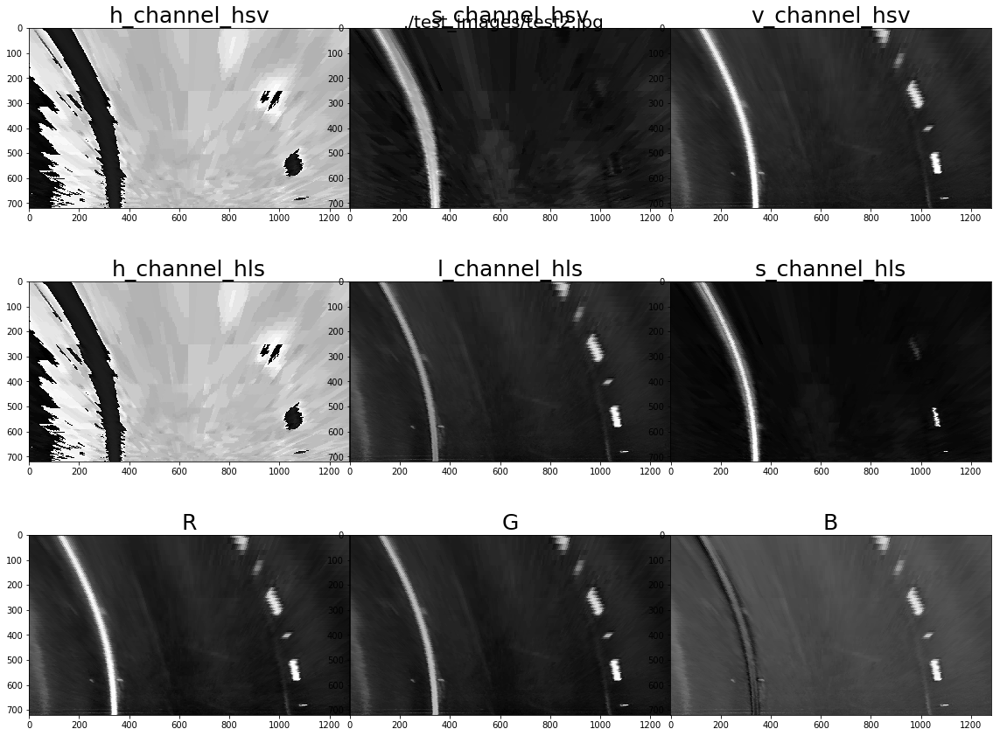

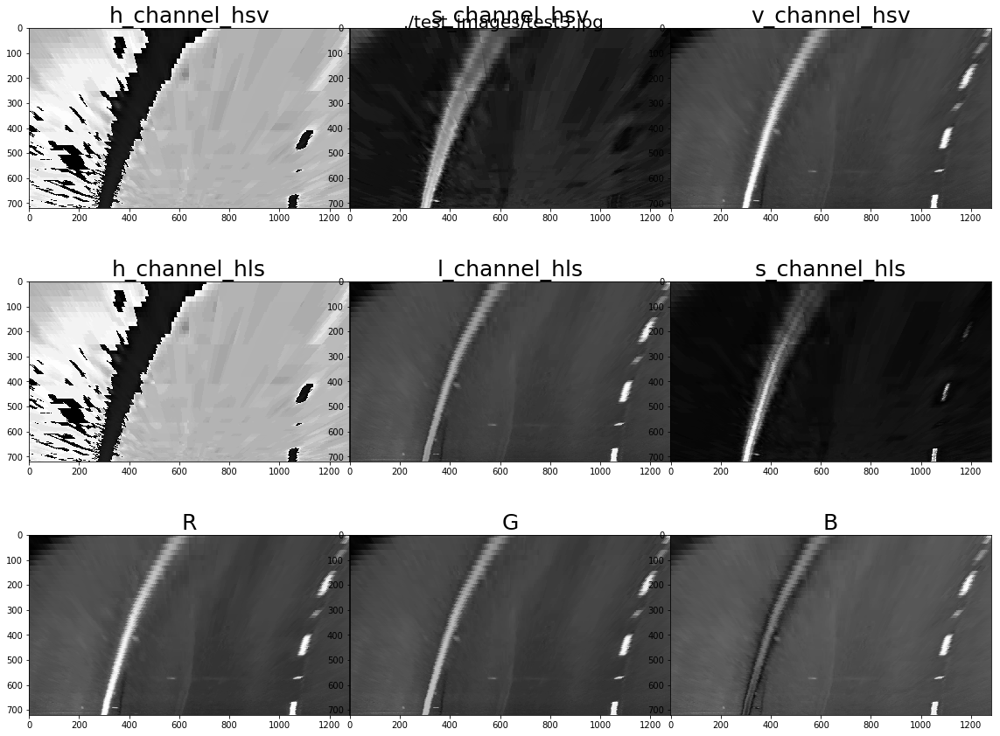

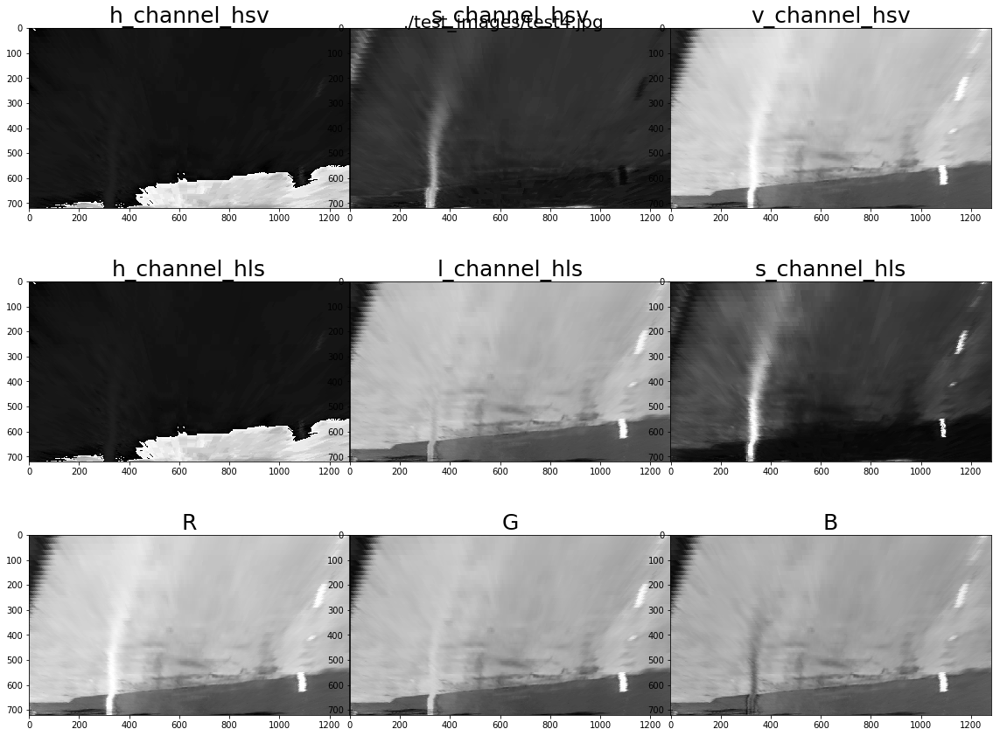

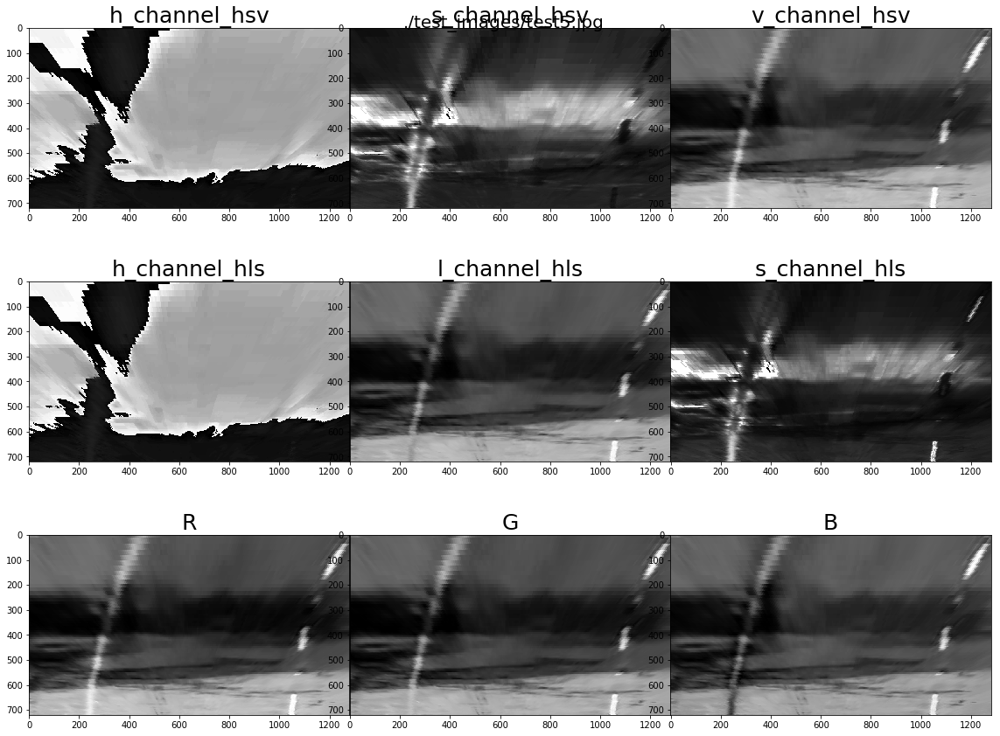

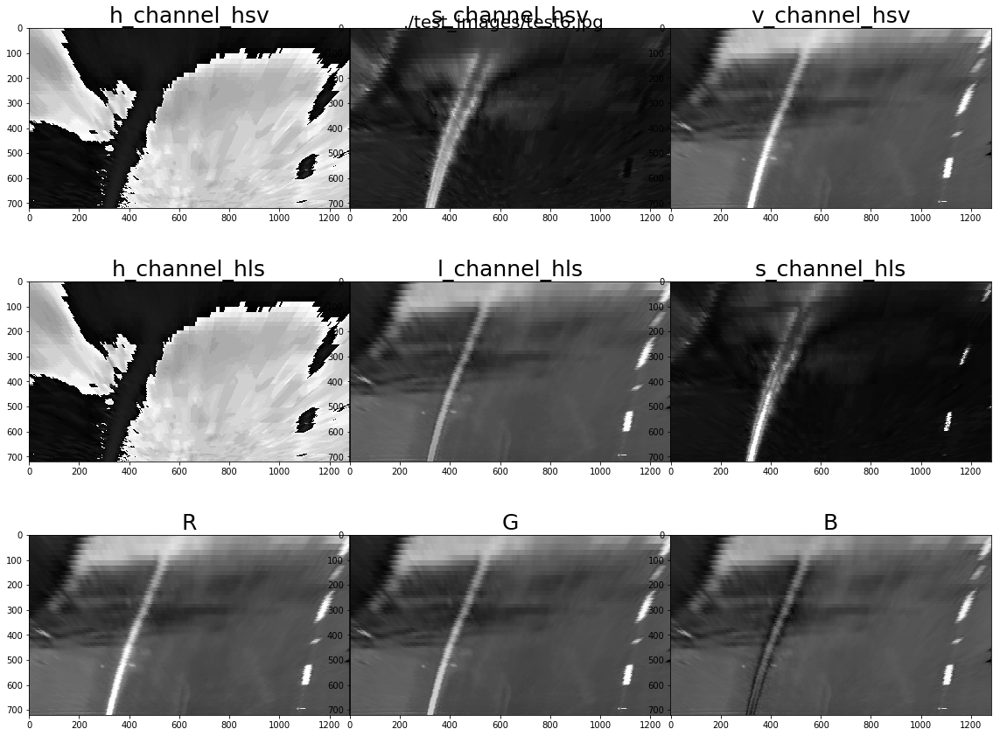

In [41]:
### get the test images from the test_images folder
images = glob.glob('./test_images/test*.jpg')

### Loop through each image and send it to the pipeline
for fname in images:
    
    img = mpimg.imread(fname)
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)
    # warp the image
    warped = warper(undist)

    # Separate the RGB
    R = warped[:,:,0]
    G = warped[:,:,1]
    B = warped[:,:,2]

    # Convert to HLS color space
    hls = cv2.cvtColor(warped, cv2.COLOR_RGB2HLS).astype(np.float)
    h_channel_hls = hls[:,:,0]
    l_channel_hls = hls[:,:,1]
    s_channel_hls = hls[:,:,2]

    # Convert to HSV color space
    hsv = cv2.cvtColor(warped, cv2.COLOR_RGB2HSV).astype(np.float)
    h_channel_hsv = hsv[:,:,0]
    s_channel_hsv = hsv[:,:,1]
    v_channel_hsv = hsv[:,:,2]

    ### Plot the source points on the original image and the warped image
    f, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3, 3, figsize=(16, 12))
    f.tight_layout()
    f.suptitle(fname, fontsize=20)
    
    # Plot HSV colors
    ax1.imshow(h_channel_hsv, cmap='gray')
    ax1.set_title('h_channel_hsv', fontsize=25)
    ax2.imshow(s_channel_hsv, cmap='gray')
    ax2.set_title('s_channel_hsv', fontsize=25)
    ax3.imshow(v_channel_hsv, cmap='gray')
    ax3.set_title('v_channel_hsv', fontsize=25)
    
    # Plot HLS colors
    ax4.imshow(h_channel_hls, cmap='gray')
    ax4.set_title('h_channel_hls', fontsize=25)
    ax5.imshow(l_channel_hls, cmap='gray')
    ax5.set_title('l_channel_hls', fontsize=25)
    ax6.imshow(s_channel_hls, cmap='gray')
    ax6.set_title('s_channel_hls', fontsize=25)

    # Plot RGB
    ax7.imshow(R, cmap='gray')
    ax7.set_title('R', fontsize=25)
    ax8.imshow(G, cmap='gray')
    ax8.set_title('G', fontsize=25)
    ax9.imshow(B, cmap='gray')
    ax9.set_title('B', fontsize=25)

    plt.subplots_adjust(hspace = .2, wspace=.001)

### Look at binary outputs from these different channels on one of the images, and fiddle with the thresholds

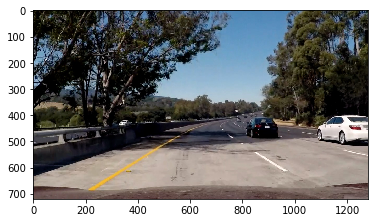

In [170]:
fname = glob.glob('./test_images/test5.jpg')
img = mpimg.imread(fname[0])

# Undistort the image based on the camera calibration
undist = undistort(img, mtx, dist)

# warp the image
warped = warper(undist)

fname

plt.imshow(img)

#### Helper function to apply the given thresholds to a gvien image color channel

In [10]:
def applyThreshold(channel, thresh):
    # 2) Apply a threshold to the S channel
    binary_output = np.zeros_like(channel)
    
    # Inclusive thresholds 
    binary_output[(channel >= thresh[0]) & (channel <= thresh[1])] = 1
    
    # 3) Return a binary image of threshold result
    return binary_output

#### HLS Saturation Channel 

In [11]:

def hls_sthresh(img, thresh=(125, 255)):
    # Convert to HLS
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # Pull out the S channelc
    s_channel = hls[:,:,2]
    # Return the applied threshold binary image
    return applyThreshold(s_channel, thresh)
    

In [12]:
def hls_sthresh_update(min_thresh, max_thresh):
    
    img_sthresh = hls_sthresh(warped, (min_thresh, max_thresh))
    
    # Plot the warped image and the result of the thresholding
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(warped)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(img_sthresh, cmap='gray')
    ax2.set_title('HLS S-Channel', fontsize=30)

interact(hls_sthresh_update,
         min_thresh=(0,255), 
         max_thresh=(0,255))

NameError: name 'warped' is not defined

<function __main__.hls_sthresh_update>

#### HLS L Channel

In [13]:
def hls_lthresh(img, thresh=(125, 255)):
    # Convert to HLS
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # Pull out the L channelc
    channel = hls[:,:,1]
    # Return the applied threshold binary image
    return applyThreshold(channel, thresh)
    

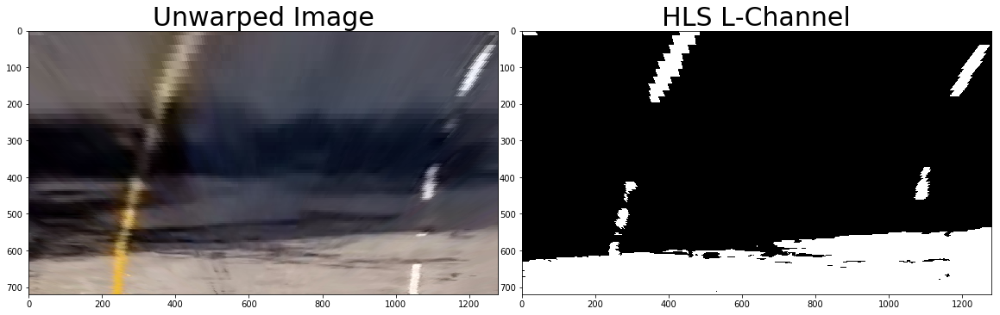

In [172]:
def hls_lthresh_update(min_thresh, max_thresh):
    
    img_lthresh = hls_lthresh(warped, (min_thresh, max_thresh))
    
    # Plot the warped image and the result of the thresholding
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(warped)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(img_lthresh, cmap='gray')
    ax2.set_title('HLS L-Channel', fontsize=30)

interact(hls_lthresh_update,
         min_thresh=(0,255), 
         max_thresh=(0,255))

#### HSV V channel

In [14]:
def hsv_vthresh(img, thresh=(125, 255)):
    # Convert to HSV
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    # Pull out the V channelc
    channel = hsv[:,:,1]
    # Return the applied threshold binary image
    return applyThreshold(channel, thresh)

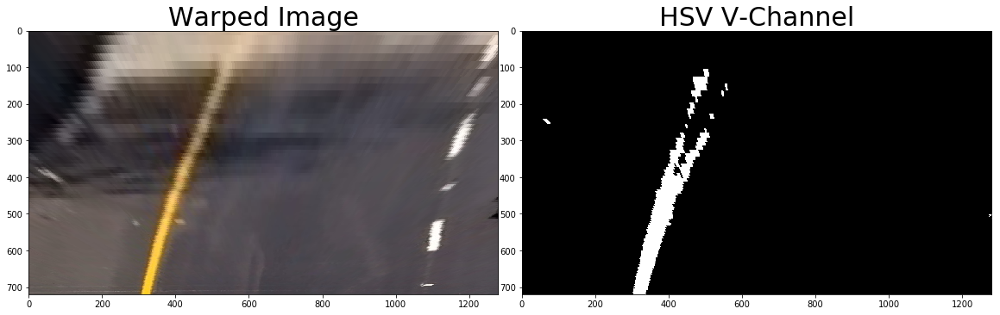

In [45]:
def hsv_vthresh_update(min_thresh, max_thresh):
    
    thresh_img = hsv_vthresh(warped, (min_thresh, max_thresh))
    
    # Plot the warped image and the result of the thresholding
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(warped)
    ax1.set_title('Warped Image', fontsize=30)
    ax2.imshow(thresh_img, cmap='gray')
    ax2.set_title('HSV V-Channel', fontsize=30)

interact(hsv_vthresh_update,
         min_thresh=(0,255), 
         max_thresh=(0,255))

### RGB Red Channel

In [15]:
def rgb_rthresh(img, thresh=(125, 255)):
    # Pull out the R channelc
    channel = img[:,:,0]
    # Return the applied threshold binary image
    return applyThreshold(channel, thresh)

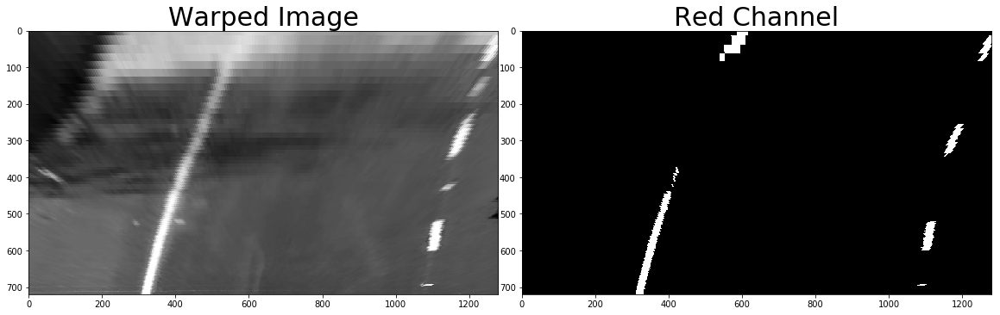

In [53]:
def rgb_rthresh_update(min_thresh, max_thresh):
    
    thresh_img = rgb_rthresh(warped, (min_thresh, max_thresh))
    
    # Plot the warped image and the result of the thresholding
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(warped[:,:,0], cmap='gray')
    ax1.set_title('Warped Image', fontsize=30)
    ax2.imshow(thresh_img, cmap='gray')
    ax2.set_title('Red Channel', fontsize=30)

interact(rgb_rthresh_update,
         min_thresh=(0,255), 
         max_thresh=(0,255))

#### Loop thorugh each image with some of the settings we've found here, and see how we do

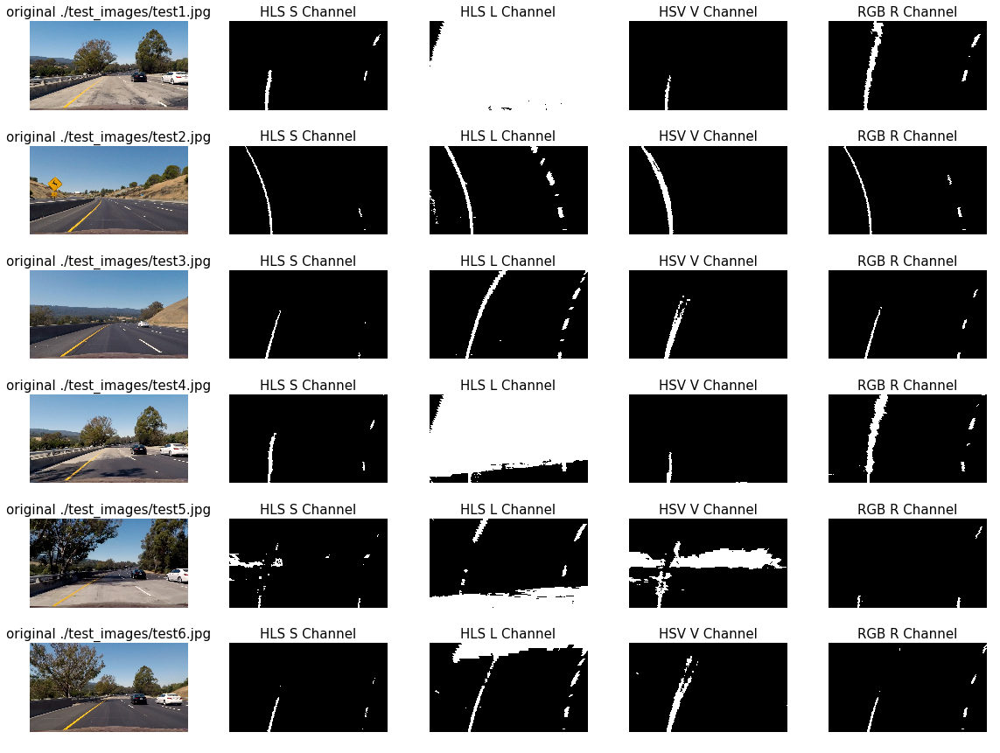

In [167]:
images = glob.glob('./test_images/test*.jpg')

f, axs = plt.subplots(6, 5, figsize=(16, 12))
f.tight_layout()
axs = axs.ravel()

i = 0
for fname in images:
    img = mpimg.imread(fname)

    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)

    # warp the image
    warped = warper(undist)
    
    S = hls_sthresh(warped, thresh=(175, 255))
    L = hls_lthresh(warped, thresh=(125, 255))
    V = hsv_vthresh(warped, thresh=(125, 255))
    R = rgb_rthresh(warped, thresh=(225, 255))
    
    axs[i].axis('off')
    axs[i].imshow(undist)
    axs[i].set_title('original ' + str(fname) , fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(S, cmap='gray')
    axs[i].set_title('HLS S Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(L, cmap='gray')
    axs[i].set_title('HLS L Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(V, cmap='gray')
    axs[i].set_title('HSV V Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(R, cmap='gray')
    axs[i].set_title('RGB R Channel', fontsize=15)
    i += 1

Looking at this, the S and the R channel probably do the best on these example images.

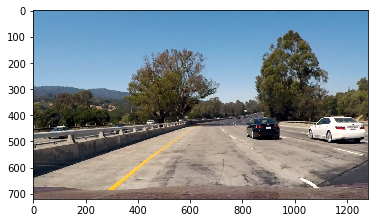

In [131]:
fname = glob.glob('./test_images/test1.jpg')
img = mpimg.imread(fname[0])

# Undistort the image based on the camera calibration
undist = undistort(img, mtx, dist)

# warp the image
warped = warper(undist)

plt.imshow(img)

In [16]:
# Define a function that applies Sobel x and y, 
# then computes the magnitude of the gradient
# and applies a threshold
def calc_sobel(img, sobel_kernel=25, mag_thresh=(25, 255)):
    
    # Convert to grayscale - sobel can only have one color channel
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    L = hls[:,:,1]
    
    # Take the sobel gradient in x and y
    sobelx = cv2.Sobel(L, cv2.CV_64F, 1, 0)
    sobely = cv2.Sobel(L, cv2.CV_64F, 0, 1)
    
    # Calculate the magnitude 
#     mag_sobel = np.sqrt(np.square(sobelx) + np.square(sobely))
    
    # Scale to 8-bit (0 - 255) and convert to type = np.uint8
#     scaled_sobel = np.uint8(255*mag_sobel/np.max(mag_sobel))
    scaled_sobel = np.uint8(255*sobelx/np.max(sobelx))
    
    # Create a binary mask where mag thresholds are met
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= mag_thresh[0]) & (scaled_sobel <= mag_thresh[1])] = 1
    
    return sxbinary


<function __main__.update>

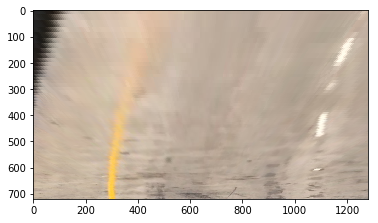

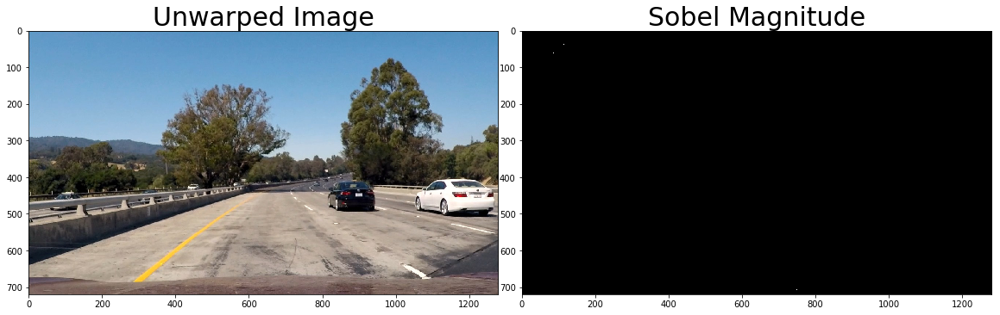

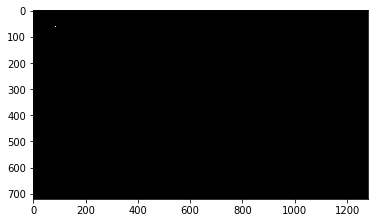

In [175]:



def update(kernel_size, min_thresh, max_thresh):
    plt.imshow(warped)
    sobel = calc_sobel(warped, kernel_size, (min_thresh, max_thresh))
    # Visualize sobel magnitude threshold
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(img)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(sobel, cmap='gray')
    ax2.set_title('Sobel Magnitude', fontsize=30)
    
#     warped_sobel = warper(sobel)
    warped_sobel = sobel
    
    plt.figure()
    plt.imshow(warped_sobel, cmap='gray')

interact(update, kernel_size=(1,31,2), 
                 min_thresh=(0,255), 
                 max_thresh=(0,255))

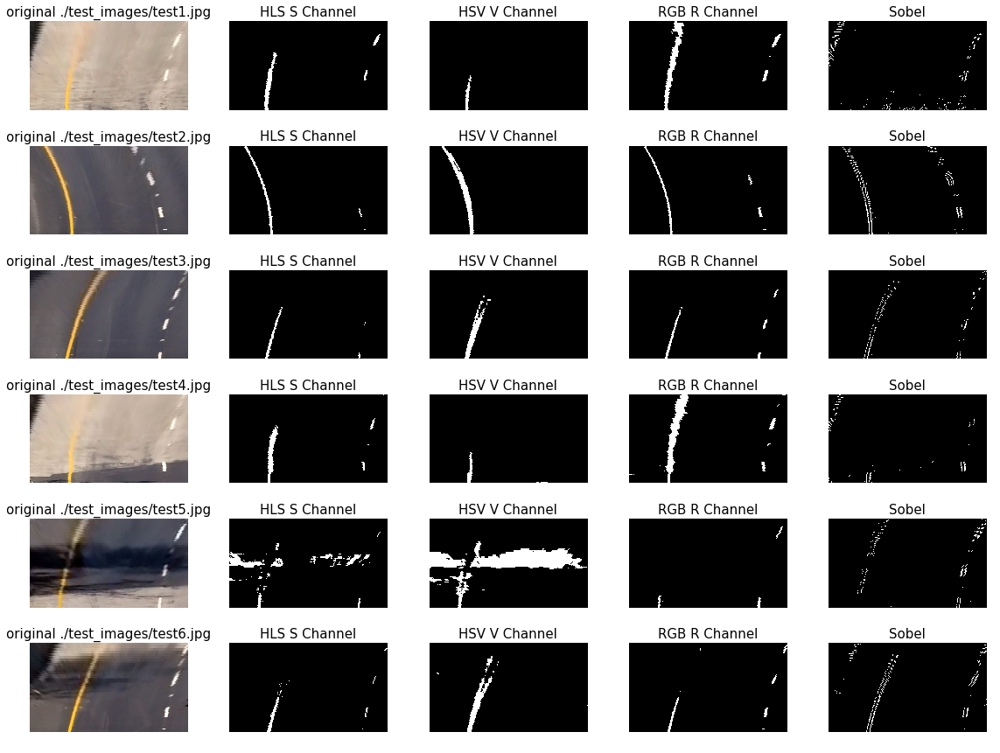

In [142]:
images = glob.glob('./test_images/test*.jpg')

f, axs = plt.subplots(6, 5, figsize=(16, 12))
f.tight_layout()
axs = axs.ravel()

i = 0
for fname in images:
    img = mpimg.imread(fname)

    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)

    # warp the image
    warped = warper(undist)
    
    S = hls_sthresh(warped, thresh=(175, 255))
    L = hls_lthresh(warped, thresh=(200,255))
    V = hsv_vthresh(warped, thresh=(125, 255))
    R = rgb_rthresh(warped, thresh=(225, 255))
    
    # Calc the sobel stuffs
    sobel = calc_sobel(warped, sobel_kernel=15,  mag_thresh=(50, 220))
    
    axs[i].axis('off')
    axs[i].imshow(warped)
    axs[i].set_title('original ' + str(fname) , fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(S, cmap='gray')
    axs[i].set_title('HLS S Channel', fontsize=15)
    i += 1
#     axs[i].axis('off')
#     axs[i].imshow(L, cmap='gray')
#     axs[i].set_title('HLS L Channel', fontsize=15)
#     i += 1
    axs[i].axis('off')
    axs[i].imshow(V, cmap='gray')
    axs[i].set_title('HSV V Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(R, cmap='gray')
    axs[i].set_title('RGB R Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(sobel, cmap='gray')
    axs[i].set_title('Sobel', fontsize=15)
    i += 1

## Image Pipeline

In [41]:

def binaryPipe(img):
    
    # Copy the image
    img = np.copy(img)

    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)

    # warp the image based on our perspective transform
    warped = warper(undist)
    
    # Get the Red and saturation images
    red = rgb_rthresh(warped, thresh=(225, 255))
#     sat = hls_sthresh(warped, thresh=(175, 255))
    
    # Run the sobel magnitude calculation
    sobel = calc_sobel(warped, sobel_kernel=15,  mag_thresh=(50, 220))
    
    # combine these layers
    combined_binary = np.zeros_like(sobel)
    combined_binary[ (red == 1) | sobel == 1] = 1 #(sat == 1) |
    
    return combined_binary

### Test the image pipeline, and print the intermediate images along with the final one

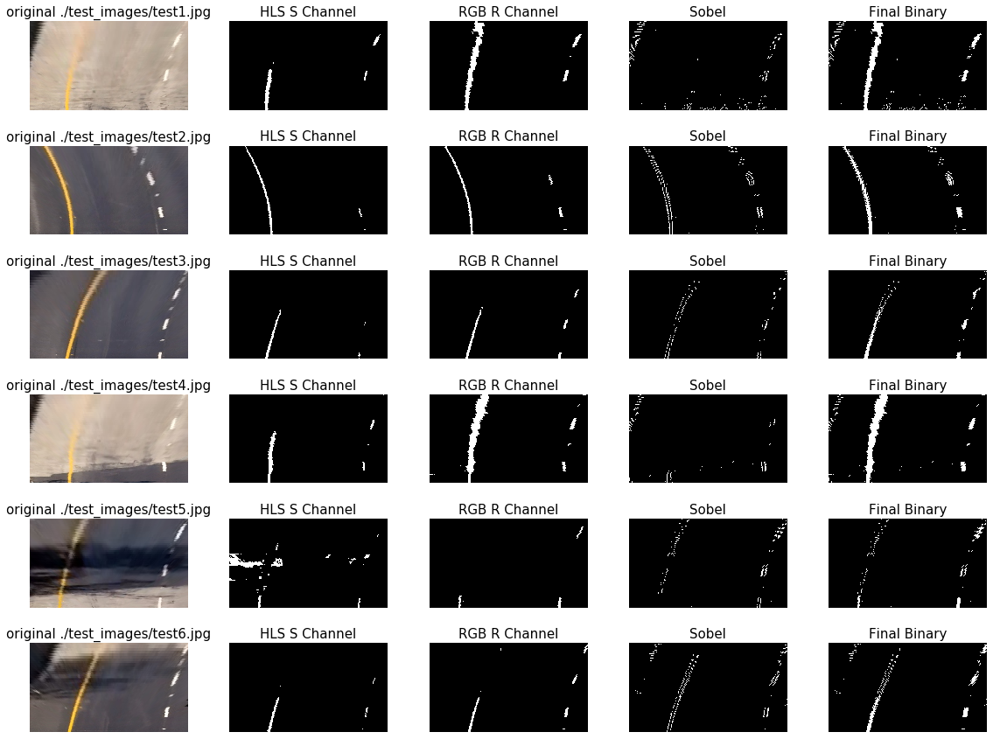

In [54]:
images = glob.glob('./test_images/test*.jpg')

f, axs = plt.subplots(6, 4, figsize=(16, 12))
f.tight_layout()
axs = axs.ravel()

i = 0
for fname in images:
    img = mpimg.imread(fname)
    
    # Run this through our binary pipeline
    binary_img = binaryPipe(img)
    
    ### The below is just so we can see the makeup of the binary pipeline
    
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)

    # warp the image
    warped = warper(undist)
    
    S = hls_sthresh(warped, thresh=(150, 255))
    L = hls_lthresh(warped, thresh=(200,255))
    V = hsv_vthresh(warped, thresh=(125, 255))
    R = rgb_rthresh(warped, thresh=(225, 255))
    
    # Calc the sobel stuffs
    sobel = calc_sobel(warped, sobel_kernel=15,  mag_thresh=(50, 220))
    
    axs[i].axis('off')
    axs[i].imshow(warped)
    axs[i].set_title('original ' + str(fname) , fontsize=15)
    i += 1
#     axs[i].axis('off')
#     axs[i].imshow(S, cmap='gray')
#     axs[i].set_title('HLS S Channel', fontsize=15)
#     i += 1
    axs[i].axis('off')
    axs[i].imshow(R, cmap='gray')
    axs[i].set_title('RGB R Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(sobel, cmap='gray')
    axs[i].set_title('Sobel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(binary_img, cmap='gray')
    axs[i].set_title('Final Binary', fontsize=15)
    i += 1

This seems pretty good. The shadows in the test5 image aren't perfect, but it's looks like it's going to probably be good enough (TM). 

## Finding and fitting the lane line pixels

To find the lane lines we'll use the histogram and window technique that was described in the lectures.

In [61]:
def calc_line_fits(img):

    ### Settings
    # Choose the number of sliding windows (for these images, the height is 450)
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Set the meters per pixel in both dimensions
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Take a histogram of the bottom half of the image
    histogram = np.sum(img[img.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((img, img, img))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Set height of windows
    window_height = np.int(img.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = img.shape[0] - (window+1)*window_height
        win_y_high = img.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2)
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2)
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Fit a second order polynomial to each
    left_fit_m = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_m = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    return left_fit, right_fit, left_fit_m, right_fit_m, out_img


In [62]:
### get the test images from the test_images folder
images = glob.glob('./test_images/test*.jpg')


### Loop through each image and send it to the pipeline
for fname in images:
    
    img = mpimg.imread(fname)
    img_og = np.copy(img)
    
    # Run this through our binary pipeline
    binary_warped = binaryPipe(img)
    
    # Run the warped, binary image from the pipeline through the fitter
    left_fit, right_fit, out_img = calc_line_fits(binary_warped)

    ### Plot the original image, the binary warped image, and the visualization from the fitter
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image with Source Points')
    
    ax2.imshow(binary_warped, cmap='gray')
    ax2.set_title('Warped Perspective')
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    ax3.imshow(out_img)
    ax3.plot(left_fitx, ploty, color='yellow')
    ax3.plot(right_fitx, ploty, color='yellow')
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)



ValueError: too many values to unpack (expected 3)

These plots and fits are looking pretty good!

### Calculate lines using previous lines

We can find lines faster if we know where to look, by using the fit from the last frame.

In [57]:

def calc_line_fits_from_prev(img, left_fit, right_fit):

    ### Settings
    margin = 100 # Width on either side of the fitted line to search
    
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  
    print("left_lane_inds")
    print(left_lane_inds)
    print("right_lane_inds")
    print(right_lane_inds)
    
    
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Fit a second order polynomial to each in meters
    left_fit_m = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_m = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)

    return left_fit, right_fit, left_fit_m, right_fit_m , result

Looking at the test images, it looks like the test6 > test4 > test5 are taken roughly right after one another from a video, so let's use these to test our fits

left_lane_inds
[19432 19433 19434 ...,  1576  1577  1578]
right_lane_inds
[20948 20949 20979 ...,  2150  2151  2152]
left_lane_inds
[False False False ...,  True  True  True]
right_lane_inds
[False False False ..., False False False]
left_lane_inds
[False False  True ..., False False False]
right_lane_inds
[False False False ...,  True  True  True]


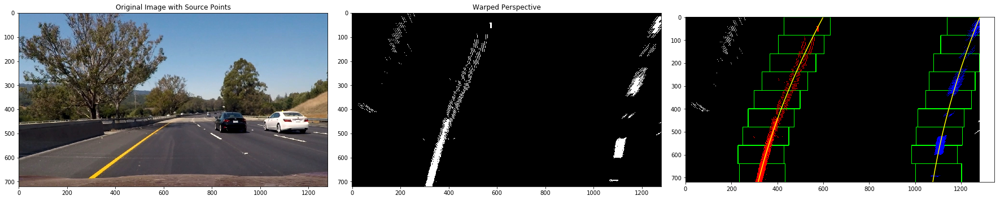

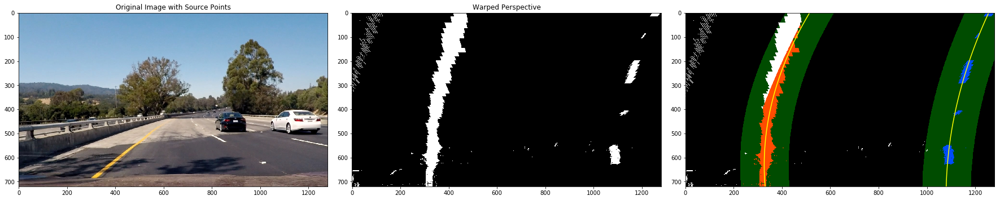

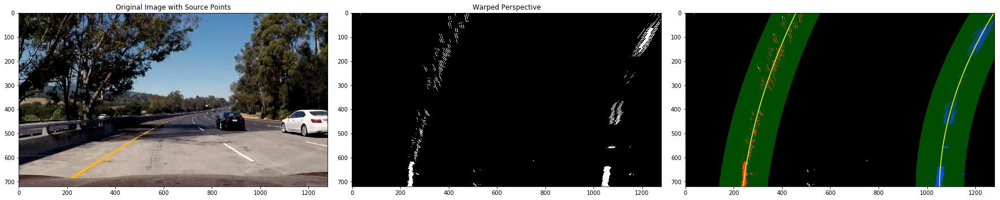

In [59]:


images = ['./test_images/test6.jpg', './test_images/test4.jpg', './test_images/test5.jpg']

left_fit = np.array([])
right_fit = np.array([])

### Loop through each image and send it to the pipeline
for fname in images:
    
    img = mpimg.imread(fname)
    img_og = np.copy(img)
    
    # Run this through our binary pipeline
    binary_warped = binaryPipe(img)
    
    ## I know that test 6 is the first image, so use the calc_line_fits on that image,
    ## otherwise use the calc_line_fits_from_prev function to test it.
    if fname == './test_images/test6.jpg':
    
        # Run the warped, binary image from the pipeline through the fitter
        left_fit, right_fit, out_img = calc_line_fits(binary_warped)

        ### Plot the original image, the binary warped image, and the visualization from the fitter
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(img)
        ax1.set_title('Original Image with Source Points')

        ax2.imshow(binary_warped, cmap='gray')
        ax2.set_title('Warped Perspective')

        # Generate x and y values for plotting
        ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

        ax3.imshow(out_img)
        ax3.plot(left_fitx, ploty, color='yellow')
        ax3.plot(right_fitx, ploty, color='yellow')

        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

    else:
    
        left_fit, right_fit, left_inds, right_inds, result = calc_line_fits_from_prev(binary_warped, left_fit, right_fit)
        
        
        
        ### Plot the original image, the binary warped image, and the visualization from the fitter
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(img)
        ax1.set_title('Original Image with Source Points')

        ax2.imshow(binary_warped, cmap='gray')
        ax2.set_title('Warped Perspective')

        ax3.imshow(result)
        ax3.plot(left_fitx, ploty, color='yellow')
        ax3.plot(right_fitx, ploty, color='yellow')

        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        

Well that looks okay...we'll go with it!

## Calculating Curvature

We need to calculate the radius of curvature, in real units of distance, so we know how much to turn the steering wheel. Here are the calculations for that.

In [125]:
def calc_radius(y_eval, left_fit, right_fit_cr):
    """
    left_fit and right_fit are assumed to have already been converted to meters
    """
    
    # Define conversions in x and y from pixels space to meters (not necessary)
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    
    # Now our radius of curvature is in meters
#     print(left_curverad, 'm', right_curverad, 'm')
    
    return left_curverad, right_curverad

def calc_center_dist(y_eval, midx, left_fit, right_fit):
    
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    # Calculate the distance from the center
    x_left_line = left_fit[0]*(y_eval**2) + left_fit[1]*y_eval + left_fit[2]
    x_right_line = right_fit[0]*(y_eval**2) + right_fit[1]*y_eval + right_fit[2]
    
    position_from_center = ((x_left_line + x_right_line)/2 - midx) * xm_per_pix
    
#     print("position from center:", position_from_center)
    
    return position_from_center


In [74]:
images = glob.glob('./test_images/test*.jpg')

### Loop through each image and send it to the pipeline
for fname in images:
    
    img = mpimg.imread(fname)
    img_og = np.copy(img)
    
    # Run this through our binary pipeline
    binary_warped = binaryPipe(img)
    
    
    # Run the warped, binary image from the pipeline through the fitter
    left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(binary_warped)
    
    y_eval = binary_warped.shape[0]
    midx = binary_warped.shape[1] / 2
    left_curerad, right_curverad = calc_radius(y_eval, left_fit_m, right_fit_m)
    center = calc_center_dist(y_eval, midx, left_fit, right_fit)


8015.84469586 m 1094.23279897 m
position from center: 0.232669200761
3340.31290197 m 1108.09508619 m
position from center: 0.358092687179
2206.60170369 m 1494.66470464 m
position from center: 0.191377196469
1928.41857197 m 1666.97985287 m
position from center: 0.321490022067
1936.97648646 m 1222.88580921 m
position from center: 0.0273505108123
1743.52525679 m 3138.64303457 m
position from center: 0.300954278853


### Drawing the lane area

6971.34531441 m 5846.47922609 m
position from center: -9.86641280612e-05
6328.4406808 m 10958.180993 m
position from center: 0.0369976180636
8015.84469586 m 1094.23279897 m
position from center: 0.232669200761
3340.31290197 m 1108.09508619 m
position from center: 0.358092687179
2206.60170369 m 1494.66470464 m
position from center: 0.191377196469
1928.41857197 m 1666.97985287 m
position from center: 0.321490022067
1936.97648646 m 1222.88580921 m
position from center: 0.0273505108123
1743.52525679 m 3138.64303457 m
position from center: 0.300954278853


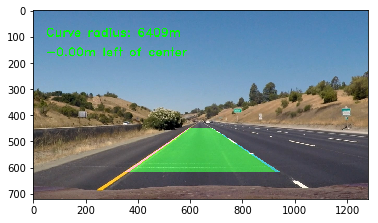

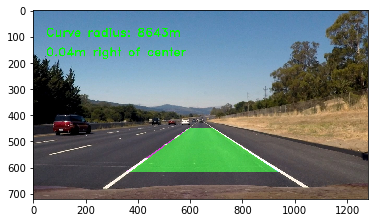

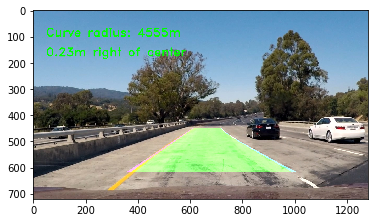

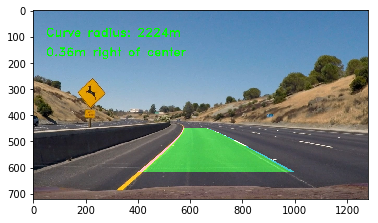

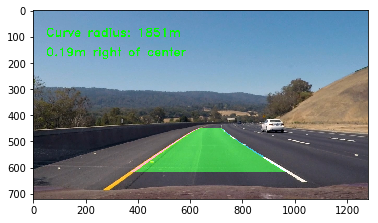

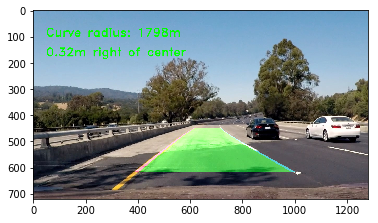

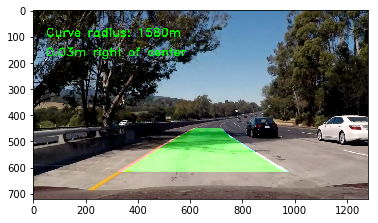

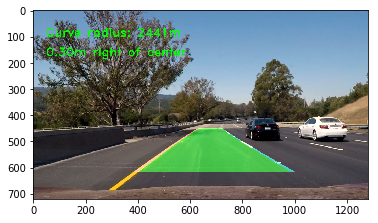

In [114]:

images = glob.glob('./test_images/*.jpg')

### Loop through each image and send it to the pipeline
for fname in images:
    
    img = mpimg.imread(fname)
    img_og = np.copy(img)
    
    # warp the image based on our perspective transform
    warped = warper(undist)
    
    # Run this through our binary pipeline
    binary_warped = binaryPipe(img)
    
    # Run the warped, binary image from the pipeline through the fitter
    left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(binary_warped)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    y_eval = binary_warped.shape[0]
    midx = binary_warped.shape[1] / 2
    
    # calc the radius and center distance
    left_curverad, right_curverad = calc_radius(y_eval, left_fit_m, right_fit_m)
    center = calc_center_dist(y_eval, midx, left_fit, right_fit)

    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_img).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Points for the original image
    src = np.float32([
        [250, 675],
        [590, 450], 
        [690, 450], 
        [1055, 675]
    ])

    # Points for the new image
    dst = np.float32([
        [250, 750],
        [250, 0], 
        [1035, 0], 
        [1035, 750]
    ])
    
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    h,w = binary_warped.shape
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    cv2.polylines(color_warp, np.int32([pts_left]), isClosed=False, color=(255,0,255), thickness=20)
    cv2.polylines(color_warp, np.int32([pts_right]), isClosed=False, color=(0,255,255), thickness=20)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (w, h)) 
    # Combine the result with the original image
    result = cv2.addWeighted(img_og, 1, newwarp, 0.5, 0)
    
    curve_rad = (left_curverad + right_curverad) / 2.
    
    # Add the radius and center
    font = cv2.FONT_HERSHEY_DUPLEX
    text = 'Curve radius: ' + '{:04.0f}'.format(curve_rad) + 'm'
    cv2.putText(result, text, (50,100), font, 1.5, (0,255, 0), 2, cv2.LINE_AA)
    if center < 0:
        dir = 'left'
    else:
        dir = 'right'
    text = '{:03.2f}'.format(center) + 'm '+ dir + ' of center'
    cv2.putText(result, text, (50,175), font, 1.5, (0,255, 0), 2, cv2.LINE_AA)

    plt.figure()
    plt.imshow(result)
    name = fname.split('/')[-1][:-4]
    plt.imsave('./output_images/' + name + '-output.jpg', result)
    

## Final Image Pipeline

In [123]:

def final_pipeline(img):

    img_og = np.copy(img)
    
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)
    
    # warp the image based on our perspective transform
    warped = warper(undist)
    
    # Run this through our binary pipeline
    binary_warped = binaryPipe(img)
    
    # Run the warped, binary image from the pipeline through the fitter
    left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(binary_warped)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    y_eval = binary_warped.shape[0]
    midx = binary_warped.shape[1] / 2
    
    # calc the radius and center distance
    left_curverad, right_curverad = calc_radius(y_eval, left_fit_m, right_fit_m)
    center = calc_center_dist(y_eval, midx, left_fit, right_fit)

    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_img).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Points for the original image
    src = np.float32([
        [250, 675],
        [590, 450], 
        [690, 450], 
        [1055, 675]
    ])

    # Points for the new image
    dst = np.float32([
        [250, 750],
        [250, 0], 
        [1035, 0], 
        [1035, 750]
    ])
    
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    cv2.polylines(color_warp, np.int32([pts_left]), isClosed=False, color=(255,0,255), thickness=20)
    cv2.polylines(color_warp, np.int32([pts_right]), isClosed=False, color=(0,255,255), thickness=20)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (w, h)) 
    # Combine the result with the original image
    result = cv2.addWeighted(img_og, 1, newwarp, 0.5, 0)
    
    curve_rad = (left_curverad + right_curverad) / 2.
    
    # Add the radius and center
    font = cv2.FONT_HERSHEY_DUPLEX
    text = 'Curve radius: ' + '{:04.0f}'.format(curve_rad) + 'm'
    cv2.putText(result, text, (50,100), font, 1.5, (0,255, 0), 2, cv2.LINE_AA)
    if center < 0:
        dir = 'left'
    else:
        dir = 'right'
    text = '{:03.2f}'.format(center) + 'm '+ dir + ' of center'
    cv2.putText(result, text, (50,175), font, 1.5, (0,255, 0), 2, cv2.LINE_AA)

    return result

## Line Class

Before we move forward, I'm going to create a line class to keep track of the current and past line data.

In [ ]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        
        # was the line detected in the last iteration?
        self.detected = False  
        
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        
        # polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float')
        
        #x values for detected line pixels
        self.allx = None  
        
        #y values for detected line pixels
        self.ally = None
        
    def add_new_fit(self, new_fit):
        pass
        
        

## Video!

In [115]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [124]:

output = 'output_video/project_video_output.mp4'
clip1 = VideoFileClip("test_videos/project_video.mp4")
clip = clip1.fl_image(final_pipeline)
%time clip.write_videofile(output, audio=False)
    

3469.44317695 m 3138.64303457 m
position from center: 0.378235224127
[MoviePy] >>>> Building video output_video/project_video_output.mp4
[MoviePy] Writing video output_video/project_video_output.mp4


  0%|          | 1/1261 [00:00<03:33,  5.91it/s]

3469.44317695 m 3138.64303457 m
position from center: 0.378235224127


  0%|          | 2/1261 [00:00<03:36,  5.82it/s]

3415.42882745 m 3138.64303457 m
position from center: 0.379461359298


  0%|          | 3/1261 [00:00<03:34,  5.88it/s]

3230.81363231 m 3138.64303457 m
position from center: 0.388674764016


  0%|          | 4/1261 [00:00<03:33,  5.88it/s]

3135.66971363 m 3138.64303457 m
position from center: 0.394543133403


  0%|          | 5/1261 [00:00<03:33,  5.89it/s]

3006.05868125 m 3138.64303457 m
position from center: 0.399350474074


  0%|          | 6/1261 [00:01<03:34,  5.84it/s]

2951.48443328 m 3138.64303457 m
position from center: 0.400160131109


  1%|          | 7/1261 [00:01<03:34,  5.84it/s]

2771.51614717 m 3138.64303457 m
position from center: 0.418785123145


  1%|          | 8/1261 [00:01<03:36,  5.78it/s]

2712.40919477 m 3138.64303457 m
position from center: 0.42653097307


  1%|          | 9/1261 [00:01<03:37,  5.76it/s]

2564.58590473 m 3138.64303457 m
position from center: 0.426870656403
2552.25387546 m 3138.64303457 m
position from center: 0.420332914643


  1%|          | 11/1261 [00:01<03:38,  5.72it/s]

2469.15496385 m 3138.64303457 m
position from center: 0.418456353449


  1%|          | 12/1261 [00:02<03:36,  5.77it/s]

2311.3338433 m 3138.64303457 m
position from center: 0.41312078828


  1%|          | 13/1261 [00:02<03:36,  5.77it/s]

2368.07809109 m 3138.64303457 m
position from center: 0.407996469077


  1%|          | 14/1261 [00:02<03:33,  5.84it/s]

2366.72676609 m 3138.64303457 m
position from center: 0.399418321596


  1%|          | 15/1261 [00:02<03:32,  5.87it/s]

2532.39083697 m 3138.64303457 m
position from center: 0.38726681711


  1%|▏         | 16/1261 [00:02<03:32,  5.87it/s]

2637.5404099 m 3138.64303457 m
position from center: 0.374559980265


  1%|▏         | 17/1261 [00:02<03:34,  5.80it/s]

2662.99002394 m 3138.64303457 m
position from center: 0.362827085346
2707.72682456 m 3138.64303457 m
position from center: 0.351304139652


  1%|▏         | 18/1261 [00:03<03:36,  5.75it/s]

2511.65965909 m 3138.64303457 m
position from center: 0.320523540789


  2%|▏         | 20/1261 [00:03<03:35,  5.76it/s]

2458.73661746 m 3138.64303457 m
position from center: 0.321156759991


  2%|▏         | 21/1261 [00:03<03:36,  5.74it/s]

2394.86716607 m 3138.64303457 m
position from center: 0.327006840299


  2%|▏         | 22/1261 [00:03<03:34,  5.78it/s]

2334.10847937 m 3138.64303457 m
position from center: 0.323458974364


  2%|▏         | 23/1261 [00:03<03:30,  5.87it/s]

2355.08587093 m 3138.64303457 m
position from center: 0.31292496525


  2%|▏         | 24/1261 [00:04<03:28,  5.94it/s]

2640.22351708 m 3138.64303457 m
position from center: 0.307527845781


  2%|▏         | 25/1261 [00:04<03:29,  5.90it/s]

2860.82189131 m 3138.64303457 m
position from center: 0.308744210062


  2%|▏         | 26/1261 [00:04<03:28,  5.92it/s]

2876.07206562 m 3138.64303457 m
position from center: 0.305304695603


  2%|▏         | 27/1261 [00:04<03:27,  5.93it/s]

3072.65194113 m 3138.64303457 m
position from center: 0.301929037236


  2%|▏         | 28/1261 [00:04<03:26,  5.96it/s]

2937.85043735 m 3138.64303457 m
position from center: 0.304794325924


  2%|▏         | 29/1261 [00:04<03:27,  5.94it/s]

3230.45350546 m 3138.64303457 m
position from center: 0.305615465575


  2%|▏         | 30/1261 [00:05<03:27,  5.94it/s]

3717.11233721 m 3138.64303457 m
position from center: 0.302341018643


  2%|▏         | 31/1261 [00:05<03:27,  5.92it/s]

4065.07476419 m 3138.64303457 m
position from center: 0.304294952467


  3%|▎         | 32/1261 [00:05<03:28,  5.91it/s]

4451.7502733 m 3138.64303457 m
position from center: 0.279907575981


  3%|▎         | 33/1261 [00:05<03:27,  5.92it/s]

4290.126124 m 3138.64303457 m
position from center: 0.294194670203


  3%|▎         | 34/1261 [00:05<03:25,  5.97it/s]

4654.75830414 m 3138.64303457 m
position from center: 0.305856392367


  3%|▎         | 35/1261 [00:05<03:26,  5.95it/s]

4788.11445271 m 3138.64303457 m
position from center: 0.308759151977


  3%|▎         | 36/1261 [00:06<03:28,  5.87it/s]

4905.69705013 m 3138.64303457 m
position from center: 0.314131321875


  3%|▎         | 37/1261 [00:06<03:29,  5.83it/s]

5077.18497268 m 3138.64303457 m
position from center: 0.312672930264


  3%|▎         | 38/1261 [00:06<03:29,  5.83it/s]

5144.63871597 m 3138.64303457 m
position from center: 0.311598118738


  3%|▎         | 39/1261 [00:06<03:29,  5.82it/s]

5331.74020618 m 3138.64303457 m
position from center: 0.311909322417


  3%|▎         | 40/1261 [00:06<03:29,  5.84it/s]

5225.00094453 m 3138.64303457 m
position from center: 0.315864358155


  3%|▎         | 41/1261 [00:07<03:27,  5.87it/s]

4819.57120307 m 3138.64303457 m
position from center: 0.325417325499


  3%|▎         | 42/1261 [00:07<03:28,  5.85it/s]

4534.60118409 m 3138.64303457 m
position from center: 0.331214284178


  3%|▎         | 43/1261 [00:07<03:26,  5.90it/s]

4155.35111716 m 3138.64303457 m
position from center: 0.343308486978


  3%|▎         | 44/1261 [00:07<03:26,  5.90it/s]

3847.58740697 m 3138.64303457 m
position from center: 0.340003953365


  4%|▎         | 45/1261 [00:07<03:26,  5.88it/s]

3437.12803018 m 3138.64303457 m
position from center: 0.339815331696


  4%|▎         | 46/1261 [00:07<03:27,  5.86it/s]

3267.31609094 m 3138.64303457 m
position from center: 0.349744911363
3037.6001568 m 3138.64303457 m
position from center: 0.35774711648


  4%|▎         | 47/1261 [00:08<03:30,  5.78it/s]

2912.63381824 m 3138.64303457 m
position from center: 0.356403529347


  4%|▍         | 48/1261 [00:08<03:33,  5.68it/s]

2693.45459791 m 3138.64303457 m
position from center: 0.358991563886


  4%|▍         | 50/1261 [00:08<03:33,  5.68it/s]

2612.93366411 m 3138.64303457 m
position from center: 0.365118001069


  4%|▍         | 51/1261 [00:08<03:33,  5.66it/s]

2561.53517837 m 3138.64303457 m
position from center: 0.3590089043


  4%|▍         | 52/1261 [00:08<03:32,  5.68it/s]

2674.58618467 m 3138.64303457 m
position from center: 0.35004236694


  4%|▍         | 53/1261 [00:09<03:31,  5.72it/s]

2684.25218908 m 3138.64303457 m
position from center: 0.344232969567


  4%|▍         | 54/1261 [00:09<03:32,  5.69it/s]

2604.79564595 m 3138.64303457 m
position from center: 0.34062499368


  4%|▍         | 55/1261 [00:09<03:30,  5.74it/s]

2522.18251095 m 3138.64303457 m
position from center: 0.33866693942


  4%|▍         | 56/1261 [00:09<03:28,  5.78it/s]

2480.38091935 m 3138.64303457 m
position from center: 0.337630837468


  5%|▍         | 57/1261 [00:09<03:26,  5.82it/s]

2441.95050691 m 3138.64303457 m
position from center: 0.347363520087


  5%|▍         | 58/1261 [00:09<03:27,  5.81it/s]

2364.85573912 m 3138.64303457 m
position from center: 0.341987723779


  5%|▍         | 59/1261 [00:10<03:23,  5.91it/s]

2524.71627064 m 3138.64303457 m
position from center: 0.333003407737
2645.33045442 m 3138.64303457 m
position from center: 0.314974930426


  5%|▍         | 61/1261 [00:10<03:26,  5.81it/s]

2793.50780273 m 3138.64303457 m
position from center: 0.295529000759


  5%|▍         | 62/1261 [00:10<03:27,  5.79it/s]

2918.30709653 m 3138.64303457 m
position from center: 0.286774713095


  5%|▍         | 63/1261 [00:10<03:26,  5.79it/s]

2852.28102023 m 3138.64303457 m
position from center: 0.273669010408


  5%|▌         | 64/1261 [00:10<03:24,  5.86it/s]

2976.95754176 m 3138.64303457 m
position from center: 0.265593699132


  5%|▌         | 65/1261 [00:11<03:24,  5.86it/s]

2926.73650793 m 3138.64303457 m
position from center: 0.2596998818


  5%|▌         | 66/1261 [00:11<03:23,  5.88it/s]

2890.16426301 m 3138.64303457 m
position from center: 0.256663765643


  5%|▌         | 67/1261 [00:11<03:22,  5.89it/s]

2859.69739878 m 3138.64303457 m
position from center: 0.250447678028


  5%|▌         | 68/1261 [00:11<03:22,  5.90it/s]

2763.15442476 m 3138.64303457 m
position from center: 0.241672808397


  5%|▌         | 69/1261 [00:11<03:23,  5.87it/s]

2686.90719592 m 3138.64303457 m
position from center: 0.213534437425


  6%|▌         | 70/1261 [00:12<03:23,  5.85it/s]

2435.65750053 m 3138.64303457 m
position from center: 0.219048515049


  6%|▌         | 71/1261 [00:12<03:26,  5.77it/s]

2379.18397189 m 3138.64303457 m
position from center: 0.214118459751


  6%|▌         | 72/1261 [00:12<03:25,  5.77it/s]

2320.89682683 m 3138.64303457 m
position from center: 0.21821778949


  6%|▌         | 73/1261 [00:12<03:26,  5.74it/s]

2300.01225794 m 3138.64303457 m
position from center: 0.215528429264
2226.22046132 m 3138.64303457 m
position from center: 0.206816392654


  6%|▌         | 75/1261 [00:12<03:24,  5.80it/s]

2108.66161582 m 3138.64303457 m
position from center: 0.210692204147


  6%|▌         | 76/1261 [00:13<03:22,  5.86it/s]

2158.40926152 m 3138.64303457 m
position from center: 0.207608445054


  6%|▌         | 77/1261 [00:13<03:21,  5.87it/s]

1977.04700158 m 3138.64303457 m
position from center: 0.210079355379


  6%|▌         | 78/1261 [00:13<03:20,  5.89it/s]

1997.66437116 m 3138.64303457 m
position from center: 0.206604776204


  6%|▋         | 79/1261 [00:13<03:20,  5.90it/s]

1928.11100168 m 3138.64303457 m
position from center: 0.20454752685


  6%|▋         | 80/1261 [00:13<03:18,  5.94it/s]

2029.52187769 m 3138.64303457 m
position from center: 0.196218298223


  6%|▋         | 81/1261 [00:13<03:19,  5.91it/s]

2118.22741635 m 3138.64303457 m
position from center: 0.184651411948


  7%|▋         | 82/1261 [00:14<03:21,  5.84it/s]

2133.01282036 m 3138.64303457 m
position from center: 0.173734082632
2212.83822799 m 3138.64303457 m
position from center: 0.165225059156


  7%|▋         | 84/1261 [00:14<03:25,  5.74it/s]

2135.61446897 m 3138.64303457 m
position from center: 0.166382393315


  7%|▋         | 85/1261 [00:14<03:23,  5.78it/s]

2282.25047373 m 3138.64303457 m
position from center: 0.170674690137


  7%|▋         | 86/1261 [00:14<03:20,  5.85it/s]

2449.83645073 m 3138.64303457 m
position from center: 0.16660903593


  7%|▋         | 87/1261 [00:14<03:21,  5.82it/s]

2865.68818036 m 3138.64303457 m
position from center: 0.169345835167


  7%|▋         | 88/1261 [00:15<03:20,  5.85it/s]

3160.57952883 m 3138.64303457 m
position from center: 0.1591569097


  7%|▋         | 89/1261 [00:15<03:21,  5.81it/s]

3493.59341561 m 3138.64303457 m
position from center: 0.15843812214


  7%|▋         | 90/1261 [00:15<03:20,  5.83it/s]

3954.31317418 m 3138.64303457 m
position from center: 0.15487396184


  7%|▋         | 91/1261 [00:15<03:18,  5.90it/s]

3667.42881845 m 3138.64303457 m
position from center: 0.161833330726


  7%|▋         | 92/1261 [00:15<03:18,  5.90it/s]

3492.49204977 m 3138.64303457 m
position from center: 0.168024442416


  7%|▋         | 93/1261 [00:15<03:19,  5.86it/s]

3787.45154078 m 3138.64303457 m
position from center: 0.166599520927


  7%|▋         | 94/1261 [00:16<03:18,  5.89it/s]

3846.5458952 m 3138.64303457 m
position from center: 0.162778148243


  8%|▊         | 95/1261 [00:16<03:17,  5.91it/s]

3510.46642139 m 3138.64303457 m
position from center: 0.146615779254


  8%|▊         | 96/1261 [00:16<03:17,  5.91it/s]

3483.72352338 m 3138.64303457 m
position from center: 0.158184016238


  8%|▊         | 97/1261 [00:16<03:13,  6.01it/s]

3487.86634493 m 3138.64303457 m
position from center: 0.164363919056


  8%|▊         | 98/1261 [00:16<03:12,  6.04it/s]

3262.94130145 m 3138.64303457 m
position from center: 0.169611978135


  8%|▊         | 99/1261 [00:16<03:11,  6.07it/s]

3548.63589857 m 3138.64303457 m
position from center: 0.159404779723


  8%|▊         | 100/1261 [00:17<03:09,  6.13it/s]

3433.51756286 m 3138.64303457 m
position from center: 0.168466231878


  8%|▊         | 101/1261 [00:17<03:13,  5.99it/s]

3572.07177736 m 3138.64303457 m
position from center: 0.17194262543


  8%|▊         | 102/1261 [00:17<03:16,  5.90it/s]

3780.39730446 m 3138.64303457 m
position from center: 0.171405984583


  8%|▊         | 103/1261 [00:17<03:16,  5.88it/s]

3813.78170155 m 3138.64303457 m
position from center: 0.178571113941


  8%|▊         | 104/1261 [00:17<03:17,  5.85it/s]

3807.94065208 m 3138.64303457 m
position from center: 0.187353378697


  8%|▊         | 105/1261 [00:17<03:16,  5.88it/s]

3551.02015211 m 3138.64303457 m
position from center: 0.199569923317


  8%|▊         | 106/1261 [00:18<03:13,  5.96it/s]

3490.13354918 m 3138.64303457 m
position from center: 0.206829851343


  8%|▊         | 107/1261 [00:18<03:16,  5.88it/s]

3200.61761533 m 3138.64303457 m
position from center: 0.183428386311


  9%|▊         | 108/1261 [00:18<03:16,  5.86it/s]

3472.28408037 m 3138.64303457 m
position from center: 0.212627655407


  9%|▊         | 109/1261 [00:18<03:17,  5.85it/s]

3603.53542981 m 3138.64303457 m
position from center: 0.210128432184


  9%|▊         | 110/1261 [00:18<03:15,  5.89it/s]

3616.88452246 m 3138.64303457 m
position from center: 0.214633963244


  9%|▉         | 111/1261 [00:18<03:15,  5.90it/s]

3756.7027272 m 3138.64303457 m
position from center: 0.225392897804


  9%|▉         | 112/1261 [00:19<03:15,  5.87it/s]

3485.55766157 m 3138.64303457 m
position from center: 0.231020282968
3859.97570635 m 3138.64303457 m
position from center: 0.23461010055


  9%|▉         | 113/1261 [00:19<03:18,  5.78it/s]

3981.79159509 m 3138.64303457 m
position from center: 0.239716100163


  9%|▉         | 115/1261 [00:19<03:19,  5.73it/s]

4337.96292819 m 3138.64303457 m
position from center: 0.247737305506


  9%|▉         | 116/1261 [00:19<03:18,  5.78it/s]

4349.86976861 m 3138.64303457 m
position from center: 0.254550668524


  9%|▉         | 117/1261 [00:20<03:14,  5.87it/s]

4313.89062459 m 3138.64303457 m
position from center: 0.257766997624


  9%|▉         | 118/1261 [00:20<03:14,  5.86it/s]

4394.76767172 m 3138.64303457 m
position from center: 0.260908421047


  9%|▉         | 119/1261 [00:20<03:15,  5.84it/s]

4278.52952777 m 3138.64303457 m
position from center: 0.274891898165


 10%|▉         | 120/1261 [00:20<03:13,  5.89it/s]

4351.65484975 m 3138.64303457 m
position from center: 0.288400231298
4111.62145057 m 3138.64303457 m
position from center: 0.29660259118


 10%|▉         | 122/1261 [00:20<03:16,  5.81it/s]

4107.00979308 m 3138.64303457 m
position from center: 0.302176029146


 10%|▉         | 123/1261 [00:21<03:11,  5.94it/s]

4269.48759747 m 3138.64303457 m
position from center: 0.296359318085


 10%|▉         | 124/1261 [00:21<03:13,  5.87it/s]

4246.54175037 m 3138.64303457 m
position from center: 0.303590072736


 10%|▉         | 125/1261 [00:21<03:10,  5.96it/s]

4347.29829758 m 3138.64303457 m
position from center: 0.302685299193


 10%|▉         | 126/1261 [00:21<03:09,  5.98it/s]

3895.41459059 m 3138.64303457 m
position from center: 0.313064498439


 10%|█         | 127/1261 [00:21<03:11,  5.93it/s]

3944.2180942 m 3138.64303457 m
position from center: 0.319853309872


 10%|█         | 128/1261 [00:21<03:11,  5.91it/s]

3781.66655558 m 3138.64303457 m
position from center: 0.322611409258


 10%|█         | 129/1261 [00:22<03:11,  5.91it/s]

3730.2867427 m 3138.64303457 m
position from center: 0.33111019739


 10%|█         | 130/1261 [00:22<03:12,  5.88it/s]

3542.66180922 m 3138.64303457 m
position from center: 0.333130095733


 10%|█         | 131/1261 [00:22<03:12,  5.88it/s]

3505.70015312 m 3138.64303457 m
position from center: 0.337966800058


 10%|█         | 132/1261 [00:22<03:11,  5.89it/s]

3403.00593655 m 3138.64303457 m
position from center: 0.36052903451
3216.65488188 m 3138.64303457 m
position from center: 0.369588297542


 11%|█         | 134/1261 [00:22<03:10,  5.90it/s]

3113.23551244 m 3138.64303457 m
position from center: 0.362820563318


 11%|█         | 135/1261 [00:23<03:08,  5.96it/s]

3033.66842173 m 3138.64303457 m
position from center: 0.363389452133


 11%|█         | 136/1261 [00:23<03:10,  5.90it/s]

2917.09852664 m 3138.64303457 m
position from center: 0.358349733913


 11%|█         | 137/1261 [00:23<03:07,  6.00it/s]

2793.48464344 m 3138.64303457 m
position from center: 0.361931065394


 11%|█         | 138/1261 [00:23<03:06,  6.02it/s]

2646.47033353 m 3138.64303457 m
position from center: 0.36568915823


 11%|█         | 139/1261 [00:23<03:04,  6.07it/s]

2647.4783138 m 3138.64303457 m
position from center: 0.363131813936


 11%|█         | 140/1261 [00:23<03:05,  6.05it/s]

2504.22031242 m 3138.64303457 m
position from center: 0.360624098923
2428.62234463 m 3138.64303457 m
position from center: 0.362084466166


 11%|█▏        | 142/1261 [00:24<03:12,  5.82it/s]

2493.00357193 m 3138.64303457 m
position from center: 0.354959477496


 11%|█▏        | 143/1261 [00:24<03:11,  5.84it/s]

2682.97880048 m 3138.64303457 m
position from center: 0.343791010352


 11%|█▏        | 144/1261 [00:24<03:11,  5.85it/s]

2614.23017798 m 3138.64303457 m
position from center: 0.336072287212


 11%|█▏        | 145/1261 [00:24<03:09,  5.89it/s]

2574.59601513 m 3138.64303457 m
position from center: 0.322081847641


 12%|█▏        | 146/1261 [00:24<03:05,  6.00it/s]

2696.18875132 m 3138.64303457 m
position from center: 0.330294823821


 12%|█▏        | 147/1261 [00:25<03:09,  5.88it/s]

2645.29922574 m 3138.64303457 m
position from center: 0.331697309934


 12%|█▏        | 148/1261 [00:25<03:07,  5.93it/s]

3004.38680397 m 3138.64303457 m
position from center: 0.335837353114


 12%|█▏        | 149/1261 [00:25<03:08,  5.91it/s]

3053.91405047 m 3138.64303457 m
position from center: 0.33725538935


 12%|█▏        | 150/1261 [00:25<03:09,  5.85it/s]

3000.16355498 m 3138.64303457 m
position from center: 0.330621144377


 12%|█▏        | 151/1261 [00:25<03:08,  5.90it/s]

2908.17175881 m 3138.64303457 m
position from center: 0.326256940172


 12%|█▏        | 152/1261 [00:25<03:09,  5.87it/s]

2852.34253275 m 3138.64303457 m
position from center: 0.322585520932


 12%|█▏        | 153/1261 [00:26<03:05,  5.97it/s]

3027.20259014 m 3138.64303457 m
position from center: 0.321265070447


 12%|█▏        | 154/1261 [00:26<03:05,  5.96it/s]

2834.43912625 m 3138.64303457 m
position from center: 0.322904773661


 12%|█▏        | 155/1261 [00:26<03:05,  5.97it/s]

2812.81614882 m 3138.64303457 m
position from center: 0.319856564262


 12%|█▏        | 156/1261 [00:26<03:02,  6.05it/s]

2853.90710245 m 3138.64303457 m
position from center: 0.313999903505


 12%|█▏        | 157/1261 [00:26<03:01,  6.10it/s]

2893.22923222 m 3138.64303457 m
position from center: 0.313827353094


 13%|█▎        | 158/1261 [00:26<03:04,  5.99it/s]

3163.35474033 m 3138.64303457 m
position from center: 0.304101982787


 13%|█▎        | 159/1261 [00:27<03:03,  6.00it/s]

3133.97679784 m 3138.64303457 m
position from center: 0.294884722258


 13%|█▎        | 160/1261 [00:27<03:05,  5.93it/s]

3364.16112323 m 3138.64303457 m
position from center: 0.286480448135


 13%|█▎        | 161/1261 [00:27<03:05,  5.93it/s]

3061.03467523 m 3138.64303457 m
position from center: 0.290652348839


 13%|█▎        | 162/1261 [00:27<03:05,  5.91it/s]

3172.47487077 m 3138.64303457 m
position from center: 0.281822212047


 13%|█▎        | 163/1261 [00:27<03:06,  5.88it/s]

3009.19528715 m 3138.64303457 m
position from center: 0.284271279566


 13%|█▎        | 164/1261 [00:27<03:04,  5.94it/s]

3275.37462199 m 3138.64303457 m
position from center: 0.28346372405


 13%|█▎        | 165/1261 [00:28<03:05,  5.90it/s]

3588.93862039 m 3138.64303457 m
position from center: 0.269611887081


 13%|█▎        | 166/1261 [00:28<03:06,  5.88it/s]

3305.82499689 m 3138.64303457 m
position from center: 0.270990827969


 13%|█▎        | 167/1261 [00:28<03:04,  5.94it/s]

3548.23738186 m 3138.64303457 m
position from center: 0.266666820462


 13%|█▎        | 168/1261 [00:28<03:04,  5.93it/s]

3178.51472975 m 3138.64303457 m
position from center: 0.265949504855


 13%|█▎        | 169/1261 [00:28<03:02,  5.98it/s]

3047.54318286 m 3138.64303457 m
position from center: 0.252925651622


 13%|█▎        | 170/1261 [00:28<03:04,  5.91it/s]

2850.31658746 m 3138.64303457 m
position from center: 0.188271093428


 14%|█▎        | 171/1261 [00:29<03:05,  5.89it/s]

2794.51758507 m 3138.64303457 m
position from center: 0.207587014002
2933.91563939 m 3138.64303457 m
position from center: 0.194277388962


 14%|█▍        | 174/1261 [00:29<03:15,  5.56it/s]

3243.33908224 m 3138.64303457 m
position from center: 0.194873097859
3799.4956421 m 3138.64303457 m
position from center: 0.179618666339


 14%|█▍        | 176/1261 [00:30<03:07,  5.78it/s]

4047.47465113 m 3138.64303457 m
position from center: 0.186227703321
4265.65564388 m 3138.64303457 m
position from center: 0.189492887305


 14%|█▍        | 178/1261 [00:30<03:03,  5.92it/s]

3855.23824688 m 3138.64303457 m
position from center: 0.197278713152
3834.72857957 m 3138.64303457 m
position from center: 0.207808014334


 14%|█▍        | 180/1261 [00:30<02:59,  6.01it/s]

4088.46421925 m 3138.64303457 m
position from center: 0.211117665892
3910.10307967 m 3138.64303457 m
position from center: 0.22381927007


 14%|█▍        | 181/1261 [00:30<02:58,  6.04it/s]

4390.43689608 m 3138.64303457 m
position from center: 0.233002093653


 14%|█▍        | 182/1261 [00:31<03:23,  5.30it/s]

4181.78959963 m 3138.64303457 m
position from center: 0.26751371692


 15%|█▍        | 184/1261 [00:31<03:24,  5.25it/s]

4573.61127367 m 3138.64303457 m
position from center: 0.262953037054
5130.8404281 m 3138.64303457 m
position from center: 0.26317219802


 15%|█▍        | 185/1261 [00:31<03:27,  5.18it/s]

5515.68917745 m 3138.64303457 m
position from center: 0.248219662663
6544.91815175 m 3138.64303457 m
position from center: 0.241817027813


 15%|█▍        | 188/1261 [00:32<03:11,  5.61it/s]

6612.13987253 m 3138.64303457 m
position from center: 0.249831824374
6697.3771973 m 3138.64303457 m
position from center: 0.25102281943


 15%|█▌        | 190/1261 [00:32<03:02,  5.87it/s]

6274.47969853 m 3138.64303457 m
position from center: 0.257591797468
5973.52503094 m 3138.64303457 m
position from center: 0.270909205718


 15%|█▌        | 192/1261 [00:32<03:00,  5.93it/s]

6020.49607116 m 3138.64303457 m
position from center: 0.273963705037
5475.6606649 m 3138.64303457 m
position from center: 0.281474921861


 15%|█▌        | 193/1261 [00:33<02:58,  5.97it/s]

5571.29308929 m 3138.64303457 m
position from center: 0.286636777112
5253.19505402 m 3138.64303457 m
position from center: 0.270771705977


 16%|█▌        | 196/1261 [00:33<03:04,  5.78it/s]

5160.29439374 m 3138.64303457 m
position from center: 0.267322889023
3990.59183153 m 3138.64303457 m
position from center: 0.288504272004


 16%|█▌        | 198/1261 [00:33<03:04,  5.77it/s]

3313.44746751 m 3138.64303457 m
position from center: 0.288252430693
2960.35504019 m 3138.64303457 m
position from center: 0.28523423109


 16%|█▌        | 200/1261 [00:34<03:01,  5.85it/s]

2605.00337678 m 3138.64303457 m
position from center: 0.280526225478
2772.2367041 m 3138.64303457 m
position from center: 0.280666339941


 16%|█▌        | 202/1261 [00:34<02:59,  5.90it/s]

2718.09331885 m 3138.64303457 m
position from center: 0.275935176674
3062.14312428 m 3138.64303457 m
position from center: 0.26724992421


 16%|█▌        | 204/1261 [00:34<02:56,  5.98it/s]

3058.23936485 m 3138.64303457 m
position from center: 0.262435373216
3190.23099938 m 3138.64303457 m
position from center: 0.256108585544


 16%|█▋        | 206/1261 [00:35<02:57,  5.93it/s]

3470.01188667 m 3138.64303457 m
position from center: 0.251716830212
3565.34263991 m 3138.64303457 m
position from center: 0.250524632286


 16%|█▋        | 208/1261 [00:35<02:56,  5.97it/s]

4088.21597881 m 3138.64303457 m
position from center: 0.27074769789
4414.48533576 m 3138.64303457 m
position from center: 0.262339759406


 17%|█▋        | 210/1261 [00:35<02:56,  5.95it/s]

4121.08145629 m 3138.64303457 m
position from center: 0.269155289452
3931.06670526 m 3138.64303457 m
position from center: 0.267224116355


 17%|█▋        | 212/1261 [00:36<02:56,  5.96it/s]

3600.6985052 m 3138.64303457 m
position from center: 0.267540944684
3699.39215223 m 3138.64303457 m
position from center: 0.264839628774


 17%|█▋        | 214/1261 [00:36<02:54,  6.00it/s]

3724.1890389 m 3138.64303457 m
position from center: 0.258856179549
3910.06892425 m 3138.64303457 m
position from center: 0.253068239219


 17%|█▋        | 216/1261 [00:36<02:53,  6.04it/s]

3779.58927951 m 3138.64303457 m
position from center: 0.247942222078
3708.55251083 m 3138.64303457 m
position from center: 0.239805672773


 17%|█▋        | 218/1261 [00:37<02:56,  5.92it/s]

3573.27406737 m 3138.64303457 m
position from center: 0.234190979784
3215.72483651 m 3138.64303457 m
position from center: 0.232361631888


 17%|█▋        | 220/1261 [00:37<02:57,  5.86it/s]

3210.85923815 m 3138.64303457 m
position from center: 0.228167055613
2968.58257002 m 3138.64303457 m
position from center: 0.228964482159


 18%|█▊        | 222/1261 [00:37<02:57,  5.86it/s]

2845.69760071 m 3138.64303457 m
position from center: 0.216655584751
2794.50431182 m 3138.64303457 m
position from center: 0.21429832456


 18%|█▊        | 223/1261 [00:38<02:57,  5.86it/s]

2728.66013303 m 3138.64303457 m
position from center: 0.217733888092
2952.86727157 m 3138.64303457 m
position from center: 0.197956821629


 18%|█▊        | 226/1261 [00:38<03:00,  5.72it/s]

2954.5034137 m 3138.64303457 m
position from center: 0.198765969151
3034.63477272 m 3138.64303457 m
position from center: 0.189434778777


 18%|█▊        | 228/1261 [00:39<02:57,  5.83it/s]

2881.66140745 m 3138.64303457 m
position from center: 0.186224874224
2718.24544008 m 3138.64303457 m
position from center: 0.178379336631


 18%|█▊        | 230/1261 [00:39<02:56,  5.85it/s]

2664.39375608 m 3138.64303457 m
position from center: 0.166953188483
2518.61107268 m 3138.64303457 m
position from center: 0.153002456249


 18%|█▊        | 232/1261 [00:39<02:52,  5.98it/s]

2510.4078157 m 3138.64303457 m
position from center: 0.110473998322
2400.06008689 m 3138.64303457 m
position from center: 0.114132432219


 19%|█▊        | 234/1261 [00:40<02:49,  6.07it/s]

2429.48247118 m 3138.64303457 m
position from center: 0.109308958421
2579.7727251 m 3138.64303457 m
position from center: 0.10236166289


 19%|█▊        | 236/1261 [00:40<02:51,  5.97it/s]

2664.87165853 m 3138.64303457 m
position from center: 0.0950510960402
3037.18070042 m 3138.64303457 m
position from center: 0.0811064560024


 19%|█▉        | 238/1261 [00:40<02:53,  5.90it/s]

3166.02376379 m 3138.64303457 m
position from center: 0.0818051516447
3339.85693934 m 3138.64303457 m
position from center: 0.0805038737935


 19%|█▉        | 240/1261 [00:41<02:53,  5.90it/s]

3371.05556594 m 3138.64303457 m
position from center: 0.0815125526276
3409.55601109 m 3138.64303457 m
position from center: 0.0821557305302


 19%|█▉        | 242/1261 [00:41<02:48,  6.04it/s]

3408.08712366 m 3138.64303457 m
position from center: 0.0790272272406
3161.48359048 m 3138.64303457 m
position from center: 0.0820021682882


 19%|█▉        | 244/1261 [00:41<02:48,  6.03it/s]

3472.11083315 m 3138.64303457 m
position from center: 0.0809524486434
3184.69421619 m 3138.64303457 m
position from center: 0.0820506596265


 20%|█▉        | 246/1261 [00:42<02:47,  6.05it/s]

3390.16514686 m 3138.64303457 m
position from center: 0.0661980494095
3471.1827744 m 3138.64303457 m
position from center: 0.0611148636948


 20%|█▉        | 248/1261 [00:42<02:45,  6.11it/s]

3427.61975954 m 3138.64303457 m
position from center: 0.0590191951538
3708.08659803 m 3138.64303457 m
position from center: 0.0515443333512


 20%|█▉        | 250/1261 [00:42<02:42,  6.24it/s]

3526.28860398 m 3138.64303457 m
position from center: 0.0612227914139
3373.37001425 m 3138.64303457 m
position from center: 0.0595389360983


 20%|█▉        | 252/1261 [00:42<02:40,  6.30it/s]

3066.07476083 m 3138.64303457 m
position from center: 0.0623157633753
3053.64716274 m 3138.64303457 m
position from center: 0.0625354186203


 20%|██        | 253/1261 [00:43<02:46,  6.07it/s]

3178.63656343 m 3138.64303457 m
position from center: 0.0590365465273
2867.80844811 m 3138.64303457 m
position from center: 0.0627824012257


 20%|██        | 256/1261 [00:43<02:49,  5.94it/s]

3098.33535004 m 3138.64303457 m
position from center: 0.0669481013937
2918.71065195 m 3138.64303457 m
position from center: 0.0511685882976


 20%|██        | 258/1261 [00:44<02:49,  5.91it/s]

3075.01017498 m 3138.64303457 m
position from center: 0.0423090668486
3077.74131973 m 3138.64303457 m
position from center: 0.0435521652459


 21%|██        | 260/1261 [00:44<02:48,  5.94it/s]

3037.47107449 m 3138.64303457 m
position from center: 0.0564930470779
3143.62211654 m 3138.64303457 m
position from center: 0.0578927061179


 21%|██        | 262/1261 [00:44<02:45,  6.05it/s]

2876.69327912 m 3138.64303457 m
position from center: 0.0714885876197
3006.90229711 m 3138.64303457 m
position from center: 0.0759645870124


 21%|██        | 264/1261 [00:44<02:40,  6.23it/s]

2875.31838793 m 3138.64303457 m
position from center: 0.0854380823637
2827.50963733 m 3138.64303457 m
position from center: 0.0852020870124


 21%|██        | 266/1261 [00:45<02:39,  6.22it/s]

2861.20257888 m 3138.64303457 m
position from center: 0.0880204193418
2733.49028591 m 3138.64303457 m
position from center: 0.0921819496227


 21%|██▏       | 268/1261 [00:45<02:40,  6.20it/s]

2826.79530488 m 3138.64303457 m
position from center: 0.0997525207907
2656.89337594 m 3138.64303457 m
position from center: 0.11648352127


 21%|██▏       | 270/1261 [00:45<02:43,  6.04it/s]

2531.26696042 m 3138.64303457 m
position from center: 0.114635024196
2507.30185592 m 3138.64303457 m
position from center: 0.111681847661


 22%|██▏       | 272/1261 [00:46<02:44,  6.02it/s]

2520.42269138 m 3138.64303457 m
position from center: 0.116010234076
2589.86199778 m 3138.64303457 m
position from center: 0.121540684729


 22%|██▏       | 274/1261 [00:46<02:46,  5.93it/s]

2535.31328632 m 3138.64303457 m
position from center: 0.121418978242
2604.77398131 m 3138.64303457 m
position from center: 0.124616815337


 22%|██▏       | 276/1261 [00:46<02:42,  6.07it/s]

2447.27898741 m 3138.64303457 m
position from center: 0.132419221346
2289.91337902 m 3138.64303457 m
position from center: 0.142898053687


 22%|██▏       | 278/1261 [00:47<02:40,  6.14it/s]

2185.88683602 m 3138.64303457 m
position from center: 0.143194616806
2144.03667238 m 3138.64303457 m
position from center: 0.148782533636


 22%|██▏       | 280/1261 [00:47<02:46,  5.90it/s]

2103.99536453 m 3138.64303457 m
position from center: 0.162156624492
2087.38747922 m 3138.64303457 m
position from center: 0.16046173245


 22%|██▏       | 282/1261 [00:47<02:48,  5.83it/s]

2011.03903056 m 3138.64303457 m
position from center: 0.164010910765
2033.5445275 m 3138.64303457 m
position from center: 0.167214932271


 23%|██▎       | 284/1261 [00:48<02:45,  5.90it/s]

1948.64734374 m 3138.64303457 m
position from center: 0.178351381811
1967.85085332 m 3138.64303457 m
position from center: 0.18081302503


 23%|██▎       | 286/1261 [00:48<02:42,  5.99it/s]

1930.27098047 m 3138.64303457 m
position from center: 0.191277366997
1883.75864056 m 3138.64303457 m
position from center: 0.198530228978


 23%|██▎       | 288/1261 [00:48<02:42,  6.00it/s]

1871.69394597 m 3138.64303457 m
position from center: 0.201499456438
1819.16232091 m 3138.64303457 m
position from center: 0.213069763165


 23%|██▎       | 290/1261 [00:49<02:43,  5.94it/s]

1841.41023451 m 3138.64303457 m
position from center: 0.214859621404
1829.54598439 m 3138.64303457 m
position from center: 0.219264796695


 23%|██▎       | 292/1261 [00:49<02:42,  5.97it/s]

1817.05160974 m 3138.64303457 m
position from center: 0.229726599372
1817.45776899 m 3138.64303457 m
position from center: 0.232952812012


 23%|██▎       | 294/1261 [00:50<02:44,  5.89it/s]

1815.26154374 m 3138.64303457 m
position from center: 0.234966118055
1813.5884535 m 3138.64303457 m
position from center: 0.233757744561


 23%|██▎       | 296/1261 [00:50<02:41,  5.96it/s]

1804.16651157 m 3138.64303457 m
position from center: 0.244324726995
1808.33543735 m 3138.64303457 m
position from center: 0.239709160901


 24%|██▎       | 298/1261 [00:50<02:41,  5.97it/s]

1803.42628712 m 3138.64303457 m
position from center: 0.242009050745
1805.61157359 m 3138.64303457 m
position from center: 0.239341535863


 24%|██▍       | 300/1261 [00:51<02:38,  6.06it/s]

1798.65866467 m 3138.64303457 m
position from center: 0.236438038381
1798.01824201 m 3138.64303457 m
position from center: 0.243092828296


 24%|██▍       | 302/1261 [00:51<02:36,  6.14it/s]

1850.74239341 m 3138.64303457 m
position from center: 0.246484987547
1866.12540303 m 3138.64303457 m
position from center: 0.245669481088


 24%|██▍       | 304/1261 [00:51<02:34,  6.18it/s]

1885.88816848 m 3138.64303457 m
position from center: 0.255176788196
2025.01852529 m 3138.64303457 m
position from center: 0.279405439373


 24%|██▍       | 306/1261 [00:51<02:36,  6.10it/s]

2089.10570668 m 3138.64303457 m
position from center: 0.277654841202
2317.35552476 m 3138.64303457 m
position from center: 0.270810593991


 24%|██▍       | 308/1261 [00:52<02:35,  6.14it/s]

2184.17956834 m 3138.64303457 m
position from center: 0.270990660912
2534.83943612 m 3138.64303457 m
position from center: 0.267821006401


 25%|██▍       | 310/1261 [00:52<02:35,  6.12it/s]

3115.65118111 m 3138.64303457 m
position from center: 0.26553115717
3082.09108979 m 3138.64303457 m
position from center: 0.262493058155


 25%|██▍       | 312/1261 [00:52<02:35,  6.10it/s]

4759.50149135 m 3138.64303457 m
position from center: 0.26141744487
5650.19054601 m 3138.64303457 m
position from center: 0.263990478236


 25%|██▍       | 314/1261 [00:53<02:34,  6.13it/s]

10161.9140754 m 3138.64303457 m
position from center: 0.26278760377
19968.686024 m 3138.64303457 m
position from center: 0.263042324827


 25%|██▌       | 316/1261 [00:53<02:32,  6.20it/s]

30509.2701311 m 3138.64303457 m
position from center: 0.258360309992
14422.4433289 m 3138.64303457 m
position from center: 0.241445992487


 25%|██▌       | 318/1261 [00:53<02:32,  6.19it/s]

17171.0658584 m 3138.64303457 m
position from center: 0.239976355439
27375.4741578 m 3138.64303457 m
position from center: 0.235084648333


 25%|██▌       | 320/1261 [00:54<02:35,  6.06it/s]

13363.2250968 m 3138.64303457 m
position from center: 0.238743473727
9905.30460468 m 3138.64303457 m
position from center: 0.246689574625


 26%|██▌       | 322/1261 [00:54<02:37,  5.97it/s]

30510.5454106 m 3138.64303457 m
position from center: 0.250718204952
17713.104072 m 3138.64303457 m
position from center: 0.256608630214


 26%|██▌       | 324/1261 [00:54<02:38,  5.90it/s]

29561.1556189 m 3138.64303457 m
position from center: 0.256991816877
239954.99032 m 3138.64303457 m
position from center: 0.264898332337


 26%|██▌       | 326/1261 [00:55<02:39,  5.86it/s]

11628.6446616 m 3138.64303457 m
position from center: 0.266863069629
29596.8666744 m 3138.64303457 m
position from center: 0.266618475103


 26%|██▌       | 328/1261 [00:55<02:36,  5.98it/s]

10628.5623663 m 3138.64303457 m
position from center: 0.277410196758
12474.6462528 m 3138.64303457 m
position from center: 0.282150292331


 26%|██▌       | 330/1261 [00:55<02:36,  5.96it/s]

9345.87662306 m 3138.64303457 m
position from center: 0.285102129167
8138.58433265 m 3138.64303457 m
position from center: 0.285737445543


 26%|██▋       | 332/1261 [00:56<02:34,  6.01it/s]

8427.22973291 m 3138.64303457 m
position from center: 0.274068421258
7563.37220688 m 3138.64303457 m
position from center: 0.270240514465


 26%|██▋       | 334/1261 [00:56<02:32,  6.09it/s]

15996.1609852 m 3138.64303457 m
position from center: 0.268066366701
18168.7682175 m 3138.64303457 m
position from center: 0.265587625537


 27%|██▋       | 336/1261 [00:56<02:35,  5.94it/s]

113555.189292 m 3138.64303457 m
position from center: 0.271595165784
10410.7467685 m 3138.64303457 m
position from center: 0.280767681195


 27%|██▋       | 338/1261 [00:57<02:36,  5.92it/s]

9708.42292007 m 3138.64303457 m
position from center: 0.283008626652
11177.7018798 m 3138.64303457 m
position from center: 0.285169698835


 27%|██▋       | 340/1261 [00:57<02:33,  5.99it/s]

20048.1081732 m 3138.64303457 m
position from center: 0.28915707779
18933.9037465 m 3138.64303457 m
position from center: 0.281819745541


 27%|██▋       | 342/1261 [00:57<02:31,  6.05it/s]

60586.0438868 m 3138.64303457 m
position from center: 0.291517911836
23591.9151347 m 3138.64303457 m
position from center: 0.277090773421


 27%|██▋       | 344/1261 [00:58<02:33,  5.97it/s]

23228.0791775 m 3138.64303457 m
position from center: 0.275688041911
17737.5949082 m 3138.64303457 m
position from center: 0.27214981512


 27%|██▋       | 346/1261 [00:58<02:36,  5.85it/s]

12115.3525787 m 3138.64303457 m
position from center: 0.271894078423
6251.50604685 m 3138.64303457 m
position from center: 0.273446954517


 28%|██▊       | 348/1261 [00:58<02:36,  5.83it/s]

3346.92304646 m 3138.64303457 m
position from center: 0.271571324049
4073.26020117 m 3138.64303457 m
position from center: 0.280584921195


 28%|██▊       | 350/1261 [00:59<02:37,  5.77it/s]

3441.96718653 m 3138.64303457 m
position from center: 0.279373130374
3141.35492968 m 3138.64303457 m
position from center: 0.276514844952


 28%|██▊       | 351/1261 [00:59<02:37,  5.77it/s]

3521.12614153 m 3138.64303457 m
position from center: 0.27638042241
5449.25096968 m 3138.64303457 m
position from center: 0.273496570414


 28%|██▊       | 354/1261 [01:00<02:35,  5.83it/s]

3587.11682938 m 3138.64303457 m
position from center: 0.266247814242
4498.95760837 m 3138.64303457 m
position from center: 0.277229907246


 28%|██▊       | 355/1261 [01:00<02:36,  5.79it/s]

7087.04806389 m 3138.64303457 m
position from center: 0.273435624906
16256.2814826 m 3138.64303457 m
position from center: 0.271603234371


 28%|██▊       | 357/1261 [01:00<02:41,  5.60it/s]

17851.8034363 m 3138.64303457 m
position from center: 0.274721187514
8302.46474268 m 3138.64303457 m
position from center: 0.280071601125


 29%|██▊       | 360/1261 [01:01<02:38,  5.68it/s]

56367.6250169 m 3138.64303457 m
position from center: 0.283170376679
3465.04899954 m 3138.64303457 m
position from center: 0.296274441851


 29%|██▊       | 362/1261 [01:01<02:38,  5.68it/s]

2232.41277741 m 3138.64303457 m
position from center: 0.303973332986
1865.38202203 m 3138.64303457 m
position from center: 0.30805438038


 29%|██▉       | 364/1261 [01:01<02:37,  5.70it/s]

1808.47139236 m 3138.64303457 m
position from center: 0.322231003617
1804.8978511 m 3138.64303457 m
position from center: 0.324792407753


 29%|██▉       | 366/1261 [01:02<02:31,  5.89it/s]

1803.86149408 m 3138.64303457 m
position from center: 0.3259150386
1803.96802175 m 3138.64303457 m
position from center: 0.323848158374


 29%|██▉       | 368/1261 [01:02<02:31,  5.90it/s]

1812.38066937 m 3138.64303457 m
position from center: 0.32161997753
1803.90558009 m 3138.64303457 m
position from center: 0.313415003602


 29%|██▉       | 370/1261 [01:02<02:26,  6.09it/s]

1801.39559094 m 3138.64303457 m
position from center: 0.295665456221
1852.20920466 m 3138.64303457 m
position from center: 0.289788850897


 30%|██▉       | 372/1261 [01:03<02:28,  6.00it/s]

1992.95775136 m 3138.64303457 m
position from center: 0.283145705314
2075.52896699 m 3138.64303457 m
position from center: 0.277165845975


 30%|██▉       | 374/1261 [01:03<02:27,  6.03it/s]

2509.59170754 m 3138.64303457 m
position from center: 0.269350085464
4018.73356357 m 3138.64303457 m
position from center: 0.255371322766


 30%|██▉       | 376/1261 [01:03<02:23,  6.15it/s]

8213.59145591 m 3138.64303457 m
position from center: 0.254497391482
15494.4377812 m 3138.64303457 m
position from center: 0.245628004317


 30%|██▉       | 378/1261 [01:04<02:22,  6.21it/s]

6472.99413657 m 3138.64303457 m
position from center: 0.239999668265
3645.87580937 m 3138.64303457 m
position from center: 0.241046791673


 30%|███       | 380/1261 [01:04<02:24,  6.11it/s]

2950.81718367 m 3138.64303457 m
position from center: 0.246699644479
3140.6434824 m 3138.64303457 m
position from center: 0.24905301547


 30%|███       | 382/1261 [01:04<02:24,  6.06it/s]

3308.75430611 m 3138.64303457 m
position from center: 0.251274157123
2746.31125133 m 3138.64303457 m
position from center: 0.250914418281


 30%|███       | 384/1261 [01:05<02:20,  6.23it/s]

2444.52951041 m 3138.64303457 m
position from center: 0.249375925559
2667.68266674 m 3138.64303457 m
position from center: 0.256629012031


 31%|███       | 386/1261 [01:05<02:19,  6.27it/s]

2537.43846035 m 3138.64303457 m
position from center: 0.261613679906
2865.75604713 m 3138.64303457 m
position from center: 0.263564277083


 31%|███       | 388/1261 [01:05<02:21,  6.15it/s]

3511.10520175 m 3138.64303457 m
position from center: 0.268288367787
3561.93027695 m 3138.64303457 m
position from center: 0.266645194248


 31%|███       | 390/1261 [01:06<02:21,  6.16it/s]

3789.52796138 m 3138.64303457 m
position from center: 0.262941514383
4261.67800233 m 3138.64303457 m
position from center: 0.262836778548


 31%|███       | 392/1261 [01:06<02:22,  6.09it/s]

6203.61577808 m 3138.64303457 m
position from center: 0.270842208962
4283.31430005 m 3138.64303457 m
position from center: 0.262789295805


 31%|███       | 394/1261 [01:06<02:23,  6.03it/s]

4866.75174099 m 3138.64303457 m
position from center: 0.264472811901
3793.48117873 m 3138.64303457 m
position from center: 0.252909078741


 31%|███▏      | 396/1261 [01:07<02:19,  6.18it/s]

3969.80475324 m 3138.64303457 m
position from center: 0.247389757561
5090.43334555 m 3138.64303457 m
position from center: 0.243680878507


 32%|███▏      | 398/1261 [01:07<02:19,  6.20it/s]

4002.93399852 m 3138.64303457 m
position from center: 0.242346667967
6470.47331144 m 3138.64303457 m
position from center: 0.243207779453


 32%|███▏      | 400/1261 [01:07<02:17,  6.28it/s]

4335.88390599 m 3138.64303457 m
position from center: 0.242186097085
6091.45193387 m 3138.64303457 m
position from center: 0.231403943912


 32%|███▏      | 402/1261 [01:08<02:19,  6.18it/s]

8794.92587445 m 3138.64303457 m
position from center: 0.217827582031
74860.1067001 m 3138.64303457 m
position from center: 0.220317261556


 32%|███▏      | 404/1261 [01:08<02:18,  6.20it/s]

25007.124178 m 3138.64303457 m
position from center: 0.218595150937
44895.9349104 m 3138.64303457 m
position from center: 0.214036156617


 32%|███▏      | 406/1261 [01:08<02:19,  6.13it/s]

44059.7697871 m 3138.64303457 m
position from center: 0.216929236743
86988.0242593 m 3138.64303457 m
position from center: 0.21043399243


 32%|███▏      | 408/1261 [01:08<02:16,  6.26it/s]

29706.3011787 m 3138.64303457 m
position from center: 0.206452043679
27844.7169915 m 3138.64303457 m
position from center: 0.204692323574


 33%|███▎      | 410/1261 [01:09<02:15,  6.30it/s]

13558.8563722 m 3138.64303457 m
position from center: 0.199474906458
23213.624303 m 3138.64303457 m
position from center: 0.193597945654


 33%|███▎      | 412/1261 [01:09<02:15,  6.27it/s]

17935.7963489 m 3138.64303457 m
position from center: 0.190945754423
10392.2821134 m 3138.64303457 m
position from center: 0.186759728998


 33%|███▎      | 414/1261 [01:09<02:14,  6.28it/s]

4436.63563628 m 3138.64303457 m
position from center: 0.164051752696
3413.66706566 m 3138.64303457 m
position from center: 0.15776415391


 33%|███▎      | 416/1261 [01:10<02:18,  6.12it/s]

3034.47866861 m 3138.64303457 m
position from center: 0.161516429296
2793.6830353 m 3138.64303457 m
position from center: 0.154766479356


 33%|███▎      | 418/1261 [01:10<02:15,  6.21it/s]

2667.54571888 m 3138.64303457 m
position from center: 0.157886475878
2380.04867004 m 3138.64303457 m
position from center: 0.152158447797


 33%|███▎      | 420/1261 [01:10<02:13,  6.31it/s]

2489.34202278 m 3138.64303457 m
position from center: 0.151030350053
2871.42099715 m 3138.64303457 m
position from center: 0.154513420203


 33%|███▎      | 422/1261 [01:11<02:12,  6.33it/s]

2547.17389794 m 3138.64303457 m
position from center: 0.151199154189
2725.90488767 m 3138.64303457 m
position from center: 0.145968298932


 34%|███▎      | 424/1261 [01:11<02:13,  6.25it/s]

2624.62350115 m 3138.64303457 m
position from center: 0.140306927138
3739.84244432 m 3138.64303457 m
position from center: 0.117251852151


 34%|███▍      | 426/1261 [01:11<02:14,  6.20it/s]

4894.66632356 m 3138.64303457 m
position from center: 0.115152552733
4949.24974583 m 3138.64303457 m
position from center: 0.11420056957


 34%|███▍      | 428/1261 [01:12<02:16,  6.12it/s]

5980.00482647 m 3138.64303457 m
position from center: 0.114690585934
11312.0589997 m 3138.64303457 m
position from center: 0.112010307894


 34%|███▍      | 430/1261 [01:12<02:13,  6.21it/s]

37458.519257 m 3138.64303457 m
position from center: 0.111360166257
21707.0254748 m 3138.64303457 m
position from center: 0.105178885196


 34%|███▍      | 432/1261 [01:12<02:13,  6.23it/s]

178626.759343 m 3138.64303457 m
position from center: 0.103408938129
9808.69850073 m 3138.64303457 m
position from center: 0.10618651291


 34%|███▍      | 434/1261 [01:13<02:11,  6.31it/s]

14958.464669 m 3138.64303457 m
position from center: 0.102197805719
3329.49174975 m 3138.64303457 m
position from center: 0.103778441087


 35%|███▍      | 436/1261 [01:13<02:13,  6.18it/s]

3708.41969413 m 3138.64303457 m
position from center: 0.0974886710541
2404.76050707 m 3138.64303457 m
position from center: 0.0691063973274


 35%|███▍      | 438/1261 [01:13<02:15,  6.08it/s]

2190.55380243 m 3138.64303457 m
position from center: 0.0874121867848
2210.79398816 m 3138.64303457 m
position from center: 0.0840345436556


 35%|███▍      | 440/1261 [01:14<02:12,  6.19it/s]

2100.26558214 m 3138.64303457 m
position from center: 0.0889817292938
2039.7497887 m 3138.64303457 m
position from center: 0.0867617125637


 35%|███▌      | 442/1261 [01:14<02:11,  6.21it/s]

2098.52763239 m 3138.64303457 m
position from center: 0.0851198729126
2255.23262377 m 3138.64303457 m
position from center: 0.0765754775215


 35%|███▌      | 444/1261 [01:14<02:09,  6.30it/s]

2328.73038004 m 3138.64303457 m
position from center: 0.0732495562697
2481.33931682 m 3138.64303457 m
position from center: 0.0695452024336


 35%|███▌      | 446/1261 [01:15<02:10,  6.25it/s]

2251.98704041 m 3138.64303457 m
position from center: 0.0658808300997
2327.87935456 m 3138.64303457 m
position from center: 0.0589696228219


 36%|███▌      | 448/1261 [01:15<02:10,  6.21it/s]

2639.07994669 m 3138.64303457 m
position from center: 0.0565353938275
2780.27675152 m 3138.64303457 m
position from center: 0.0473749607137


 36%|███▌      | 450/1261 [01:15<02:10,  6.22it/s]

2904.52150481 m 3138.64303457 m
position from center: 0.0545035342413
5306.6195946 m 3138.64303457 m
position from center: 0.0477902534102


 36%|███▌      | 452/1261 [01:16<02:09,  6.27it/s]

4814.68302412 m 3138.64303457 m
position from center: 0.0445703996834
13480.151335 m 3138.64303457 m
position from center: 0.0431507397589


 36%|███▌      | 454/1261 [01:16<02:10,  6.20it/s]

41912.40797 m 3138.64303457 m
position from center: 0.0478263552321
6820.11836373 m 3138.64303457 m
position from center: 0.0480690641626


 36%|███▌      | 456/1261 [01:16<02:06,  6.37it/s]

3798.68089375 m 3138.64303457 m
position from center: 0.0482813846821
6831.26187157 m 3138.64303457 m
position from center: 0.0562912386832


 36%|███▋      | 458/1261 [01:16<02:07,  6.29it/s]

4688.16755461 m 3138.64303457 m
position from center: 0.0602181675565
4149.1512876 m 3138.64303457 m
position from center: 0.0669664996875


 36%|███▋      | 460/1261 [01:17<02:08,  6.24it/s]

3160.06058253 m 3138.64303457 m
position from center: 0.081717560748
2880.44865577 m 3138.64303457 m
position from center: 0.0914377668012


 37%|███▋      | 462/1261 [01:17<02:07,  6.25it/s]

2941.33609956 m 3138.64303457 m
position from center: 0.0909047447927
2700.61035056 m 3138.64303457 m
position from center: 0.083107418472


 37%|███▋      | 464/1261 [01:17<02:09,  6.17it/s]

2640.24649708 m 3138.64303457 m
position from center: 0.0881841084595
2330.23461814 m 3138.64303457 m
position from center: 0.0916503201601


 37%|███▋      | 466/1261 [01:18<02:10,  6.08it/s]

2510.91662045 m 3138.64303457 m
position from center: 0.0877141495517
2522.00960502 m 3138.64303457 m
position from center: 0.0879043543989


 37%|███▋      | 468/1261 [01:18<02:07,  6.23it/s]

2884.83576908 m 3138.64303457 m
position from center: 0.0879346068343
4374.88185594 m 3138.64303457 m
position from center: 0.092577285555


 37%|███▋      | 470/1261 [01:18<02:09,  6.11it/s]

4592.58123678 m 3138.64303457 m
position from center: 0.0910082862266
4674.78450547 m 3138.64303457 m
position from center: 0.0921590761714


 37%|███▋      | 472/1261 [01:19<02:09,  6.08it/s]

8531.81984522 m 3138.64303457 m
position from center: 0.076762718272
55845.5904087 m 3138.64303457 m
position from center: 0.0573729204872


 38%|███▊      | 474/1261 [01:19<02:07,  6.16it/s]

47951.3711873 m 3138.64303457 m
position from center: 0.0717903699093
11925.6861296 m 3138.64303457 m
position from center: 0.0778190001977


 38%|███▊      | 476/1261 [01:19<02:08,  6.10it/s]

10353.798279 m 3138.64303457 m
position from center: 0.0812116978653
5399.64971053 m 3138.64303457 m
position from center: 0.0855914674575


 38%|███▊      | 478/1261 [01:20<02:09,  6.05it/s]

6668.8438788 m 3138.64303457 m
position from center: 0.0895425504599
6040.09448133 m 3138.64303457 m
position from center: 0.0941728298449


 38%|███▊      | 480/1261 [01:20<02:05,  6.21it/s]

9685.75553196 m 3138.64303457 m
position from center: 0.0948734171569
3498.27278576 m 3138.64303457 m
position from center: 0.104526685619


 38%|███▊      | 482/1261 [01:20<02:03,  6.31it/s]

3763.19850188 m 3138.64303457 m
position from center: 0.103817065646
4087.5743131 m 3138.64303457 m
position from center: 0.101517640371


 38%|███▊      | 484/1261 [01:21<02:05,  6.17it/s]

4744.7621231 m 3138.64303457 m
position from center: 0.114434380168
4557.75636649 m 3138.64303457 m
position from center: 0.109697409261


 39%|███▊      | 486/1261 [01:21<02:07,  6.08it/s]

7444.43246013 m 3138.64303457 m
position from center: 0.0764872203763
7266.67622439 m 3138.64303457 m
position from center: 0.0898575766469


 39%|███▊      | 488/1261 [01:21<02:08,  6.01it/s]

19777.0679799 m 3138.64303457 m
position from center: 0.0970123448952
20020.1817753 m 3138.64303457 m
position from center: 0.102873815223


 39%|███▉      | 490/1261 [01:22<02:08,  5.99it/s]

110992.908765 m 3138.64303457 m
position from center: 0.104255130321
14564.3034735 m 3138.64303457 m
position from center: 0.107206830229


 39%|███▉      | 492/1261 [01:22<02:05,  6.13it/s]

13594.3937276 m 3138.64303457 m
position from center: 0.109805071487
11288.7918146 m 3138.64303457 m
position from center: 0.118710889626


 39%|███▉      | 494/1261 [01:22<02:05,  6.11it/s]

23083.7048351 m 3138.64303457 m
position from center: 0.118124156966
18254.0240713 m 3138.64303457 m
position from center: 0.122205909432


 39%|███▉      | 496/1261 [01:23<02:09,  5.92it/s]

14778.3275068 m 3138.64303457 m
position from center: 0.12750530375
28586.8273072 m 3138.64303457 m
position from center: 0.105422098736


 39%|███▉      | 498/1261 [01:23<02:06,  6.04it/s]

55773.1902351 m 3138.64303457 m
position from center: 0.115981081607
9858.09133489 m 3138.64303457 m
position from center: 0.12076282353


 40%|███▉      | 500/1261 [01:23<02:04,  6.13it/s]

15260.5898463 m 3138.64303457 m
position from center: 0.115977832332
7090.16976061 m 3138.64303457 m
position from center: 0.115574881603


 40%|███▉      | 502/1261 [01:24<02:03,  6.13it/s]

5301.69447875 m 3138.64303457 m
position from center: 0.123540301909
7179.22159882 m 3138.64303457 m
position from center: 0.129280855061


 40%|███▉      | 504/1261 [01:24<02:03,  6.14it/s]

5942.63345869 m 3138.64303457 m
position from center: 0.133298984939
13618.0759207 m 3138.64303457 m
position from center: 0.138684800631


 40%|████      | 506/1261 [01:24<02:02,  6.18it/s]

11384.672023 m 3138.64303457 m
position from center: 0.14040876314
8325.15268797 m 3138.64303457 m
position from center: 0.139478318755


 40%|████      | 508/1261 [01:25<02:01,  6.20it/s]

8258.33061924 m 3138.64303457 m
position from center: 0.148565644318
12726.9034415 m 3138.64303457 m
position from center: 0.150309608164


 40%|████      | 510/1261 [01:25<02:02,  6.14it/s]

27516.4985939 m 3138.64303457 m
position from center: 0.123241941022
58387.9500416 m 3138.64303457 m
position from center: 0.112529497161


 41%|████      | 512/1261 [01:25<02:01,  6.15it/s]

34912.2563726 m 3138.64303457 m
position from center: 0.107677515607
14033.2436304 m 3138.64303457 m
position from center: 0.108890023585


 41%|████      | 514/1261 [01:26<02:01,  6.15it/s]

7081.82950648 m 3138.64303457 m
position from center: 0.115179930911
7874.71480019 m 3138.64303457 m
position from center: 0.111188258816


 41%|████      | 516/1261 [01:26<02:01,  6.12it/s]

7108.31524015 m 3138.64303457 m
position from center: 0.113520747113
5802.41103428 m 3138.64303457 m
position from center: 0.117507331762


 41%|████      | 518/1261 [01:26<01:59,  6.20it/s]

6275.27040045 m 3138.64303457 m
position from center: 0.117778313839
4389.26449167 m 3138.64303457 m
position from center: 0.117762168159


 41%|████      | 520/1261 [01:27<01:57,  6.30it/s]

4318.26197991 m 3138.64303457 m
position from center: 0.128285636111
4596.23994017 m 3138.64303457 m
position from center: 0.121514578799


 41%|████▏     | 522/1261 [01:27<01:58,  6.23it/s]

8542.07419774 m 3138.64303457 m
position from center: 0.118181431998
1875865.44196 m 3138.64303457 m
position from center: 0.125782763409


 42%|████▏     | 524/1261 [01:27<01:57,  6.28it/s]

20541.5450643 m 3138.64303457 m
position from center: 0.120257938144
11666.3571859 m 3138.64303457 m
position from center: 0.119432330131


 42%|████▏     | 526/1261 [01:28<01:55,  6.37it/s]

10333.1113839 m 3138.64303457 m
position from center: 0.11801694342
13405.6047069 m 3138.64303457 m
position from center: 0.120448846838


 42%|████▏     | 528/1261 [01:28<01:56,  6.28it/s]

5018.80879526 m 3138.64303457 m
position from center: 0.11670314163
10410.2257263 m 3138.64303457 m
position from center: 0.121227337288


 42%|████▏     | 530/1261 [01:28<01:55,  6.34it/s]

9099.99874606 m 3138.64303457 m
position from center: 0.122479520579
1759037.56327 m 3138.64303457 m
position from center: 0.13033427173


 42%|████▏     | 532/1261 [01:28<01:55,  6.34it/s]

3960.40193782 m 3138.64303457 m
position from center: 0.150305326796
2041.20478951 m 3138.64303457 m
position from center: 0.16369293858


 42%|████▏     | 534/1261 [01:29<01:53,  6.38it/s]

3293.01374288 m 3138.64303457 m
position from center: 0.173399561433
2395.31382317 m 3138.64303457 m
position from center: 0.145064851643


 43%|████▎     | 536/1261 [01:29<01:53,  6.36it/s]

2807.27806964 m 3138.64303457 m
position from center: 0.148631873671
3805.81278222 m 3138.64303457 m
position from center: 0.157605122825


 43%|████▎     | 538/1261 [01:29<01:53,  6.35it/s]

3751.9192526 m 3138.64303457 m
position from center: 0.166819202219
5411.7604848 m 3138.64303457 m
position from center: 0.16446070315


 43%|████▎     | 540/1261 [01:30<01:55,  6.26it/s]

12735.6591824 m 3138.64303457 m
position from center: 0.160622950725
23433.3112761 m 3138.64303457 m
position from center: 0.160463010449


 43%|████▎     | 542/1261 [01:30<01:53,  6.31it/s]

5799.34871436 m 3138.64303457 m
position from center: 0.149319009193
6400.29589769 m 3138.64303457 m
position from center: 0.145472443669


 43%|████▎     | 544/1261 [01:30<01:52,  6.36it/s]

29499.9134154 m 3138.64303457 m
position from center: 0.149128951541
6358.45248609 m 3138.64303457 m
position from center: 0.150674970274


 43%|████▎     | 546/1261 [01:31<01:55,  6.18it/s]

31915.3107571 m 3138.64303457 m
position from center: 0.160408120087
50346.705341 m 3138.64303457 m
position from center: 0.165338303565


 43%|████▎     | 548/1261 [01:31<01:56,  6.10it/s]

10182.6690829 m 3138.64303457 m
position from center: 0.167237614991
4261.77098519 m 3138.64303457 m
position from center: 0.161603128494


 44%|████▎     | 550/1261 [01:31<01:58,  6.00it/s]

4621.73944852 m 3138.64303457 m
position from center: 0.158607572015
16546.3010435 m 3138.64303457 m
position from center: 0.152351047601


 44%|████▍     | 552/1261 [01:32<01:58,  6.00it/s]

4862.17311923 m 3138.64303457 m
position from center: 0.157361416461
4051.56062203 m 3138.64303457 m
position from center: 0.164961785696


 44%|████▍     | 554/1261 [01:32<01:56,  6.05it/s]

2407.25433122 m 3138.64303457 m
position from center: 0.155348020294
3893.84738254 m 3138.64303457 m
position from center: 0.208970636062


 44%|████▍     | 556/1261 [01:32<01:55,  6.12it/s]

2855.94336463 m 3138.64303457 m
position from center: 0.193899033444
16902.1951786 m 3138.64303457 m
position from center: 0.14455202354


 44%|████▍     | 558/1261 [01:33<01:56,  6.05it/s]

233253.018354 m 3138.64303457 m
position from center: 0.157715994162
6428.20020659 m 3138.64303457 m
position from center: 0.163286778032


 44%|████▍     | 560/1261 [01:33<01:54,  6.12it/s]

3523.70121586 m 3138.64303457 m
position from center: 0.154335892343
2333.44853136 m 3138.64303457 m
position from center: 0.1761169943


 45%|████▍     | 562/1261 [01:33<01:52,  6.24it/s]

2089.29878218 m 3138.64303457 m
position from center: 0.160108901334
1992.81718136 m 3138.64303457 m
position from center: 0.175407895831


 45%|████▍     | 564/1261 [01:34<01:52,  6.17it/s]

1794.46107458 m 3138.64303457 m
position from center: 0.195875296707
1877.79281171 m 3138.64303457 m
position from center: 0.215730004469


 45%|████▍     | 566/1261 [01:34<01:51,  6.24it/s]

2960.17410856 m 3138.64303457 m
position from center: 0.129151949298
1827.79043839 m 3138.64303457 m
position from center: 0.115340054196


 45%|████▌     | 568/1261 [01:34<01:49,  6.35it/s]

7040.91059076 m 3138.64303457 m
position from center: 0.118190342426
1820.75265444 m 3138.64303457 m
position from center: 0.135456239914


 45%|████▌     | 570/1261 [01:35<01:46,  6.47it/s]

1987.74726621 m 3138.64303457 m
position from center: 0.143640480028
2471.20574903 m 3138.64303457 m
position from center: 0.158681321518


 45%|████▌     | 572/1261 [01:35<01:46,  6.45it/s]

8324.98573451 m 3138.64303457 m
position from center: 0.150205694078
2064.1060928 m 3138.64303457 m
position from center: 0.155456724526


 46%|████▌     | 574/1261 [01:35<01:45,  6.51it/s]

6684.073265 m 3138.64303457 m
position from center: 0.161210334625
2935.8297643 m 3138.64303457 m
position from center: 0.169375260929


 46%|████▌     | 576/1261 [01:36<01:44,  6.57it/s]

3974.30654036 m 3138.64303457 m
position from center: 0.202060686744
2353.32586704 m 3138.64303457 m
position from center: 0.224226115908


 46%|████▌     | 578/1261 [01:36<01:44,  6.56it/s]

3114.36163129 m 3138.64303457 m
position from center: 0.205093295622
6175.660588 m 3138.64303457 m
position from center: 0.21194066602


 46%|████▌     | 580/1261 [01:36<01:44,  6.54it/s]

4260.60627131 m 3138.64303457 m
position from center: 0.235095329239
3042.01719481 m 3138.64303457 m
position from center: 0.220335282398


 46%|████▌     | 582/1261 [01:36<01:42,  6.61it/s]

2186.41916595 m 3138.64303457 m
position from center: 0.235866753175
1923.49608737 m 3138.64303457 m
position from center: 0.212815117737


 46%|████▋     | 584/1261 [01:37<01:46,  6.36it/s]

2000.79746788 m 3138.64303457 m
position from center: 0.212810406235
1839.8131305 m 3138.64303457 m
position from center: 0.200386071461


 46%|████▋     | 586/1261 [01:37<01:43,  6.55it/s]

2048.75227229 m 3138.64303457 m
position from center: 0.198577765163
1911.54670681 m 3138.64303457 m
position from center: 0.211690111467


 47%|████▋     | 588/1261 [01:37<01:42,  6.58it/s]

2812.17199304 m 3138.64303457 m
position from center: 0.285862031215
4260.57731673 m 3138.64303457 m
position from center: 0.27777688866


 47%|████▋     | 590/1261 [01:38<01:43,  6.49it/s]

1866.79265327 m 3138.64303457 m
position from center: 0.222566050484
2130.54078651 m 3138.64303457 m
position from center: 0.210475308199


 47%|████▋     | 592/1261 [01:38<01:43,  6.49it/s]

1894.27665672 m 3138.64303457 m
position from center: 0.183240340715
8281.4026203 m 3138.64303457 m
position from center: 0.156556430175


 47%|████▋     | 594/1261 [01:38<01:42,  6.53it/s]

2379.68548601 m 3138.64303457 m
position from center: 0.127278893009
2074.81841441 m 3138.64303457 m
position from center: 0.117801651998


 47%|████▋     | 596/1261 [01:39<01:40,  6.64it/s]

2951.77063338 m 3138.64303457 m
position from center: 0.112055437751
1833.14558618 m 3138.64303457 m
position from center: 0.106559871474


 47%|████▋     | 598/1261 [01:39<01:42,  6.45it/s]

2187.19713719 m 3138.64303457 m
position from center: 0.109760093705
88832.0437024 m 3138.64303457 m
position from center: 0.107939973343


 48%|████▊     | 600/1261 [01:39<01:40,  6.60it/s]

1987.54237833 m 3138.64303457 m
position from center: 0.123872431545
3234.60597014 m 3138.64303457 m
position from center: 0.131416889094


 48%|████▊     | 602/1261 [01:40<01:38,  6.67it/s]

1974.2774372 m 3138.64303457 m
position from center: 0.127422094875
2587.90537816 m 3138.64303457 m
position from center: 0.136175105606


 48%|████▊     | 604/1261 [01:40<01:39,  6.64it/s]

2419.86112993 m 3138.64303457 m
position from center: 0.131339239204
2669.85772917 m 3138.64303457 m
position from center: 0.137140800332


 48%|████▊     | 606/1261 [01:40<01:36,  6.78it/s]

3049.20296878 m 3138.64303457 m
position from center: 0.129872417181
3854.68425494 m 3138.64303457 m
position from center: 0.0954365358465


 48%|████▊     | 608/1261 [01:40<01:36,  6.77it/s]

4370.69868582 m 3138.64303457 m
position from center: 0.0835343768895
5161.44297495 m 3138.64303457 m
position from center: 0.0619956904757


 48%|████▊     | 610/1261 [01:41<01:35,  6.81it/s]

4171.83020737 m 3138.64303457 m
position from center: 0.0406256745551
4345.70575321 m 3138.64303457 m
position from center: 0.0361199808418


 49%|████▊     | 612/1261 [01:41<01:35,  6.82it/s]

4416.33262961 m 3138.64303457 m
position from center: 0.097853354447
4471.65570651 m 3138.64303457 m
position from center: 0.039663131238


 49%|████▊     | 614/1261 [01:41<01:35,  6.76it/s]

5158.65184483 m 3138.64303457 m
position from center: 0.038776205524
4143.10555304 m 3138.64303457 m
position from center: -0.0385081647451


 49%|████▉     | 616/1261 [01:42<01:37,  6.64it/s]

3691.38963049 m 3138.64303457 m
position from center: -0.112692058783
3794.23920604 m 3138.64303457 m
position from center: -0.087989480825


 49%|████▉     | 618/1261 [01:42<01:40,  6.40it/s]

3778.62205034 m 3138.64303457 m
position from center: -0.0898996587315
4005.56252487 m 3138.64303457 m
position from center: -0.0710084286318


 49%|████▉     | 620/1261 [01:42<01:39,  6.46it/s]

4528.2887862 m 3138.64303457 m
position from center: -0.0646236311698
4193.85932475 m 3138.64303457 m
position from center: -0.0790567552543


 49%|████▉     | 622/1261 [01:43<01:36,  6.60it/s]

3777.00098232 m 3138.64303457 m
position from center: -0.0767066665183
3327.19274809 m 3138.64303457 m
position from center: -0.0626333403475


 49%|████▉     | 624/1261 [01:43<01:35,  6.67it/s]

1856.42318227 m 3138.64303457 m
position from center: -0.0468464858742
2328.7311729 m 3138.64303457 m
position from center: -0.0247372513134


 50%|████▉     | 626/1261 [01:43<01:34,  6.71it/s]

4198.8229453 m 3138.64303457 m
position from center: 0.00259137869233
4721.12396716 m 3138.64303457 m
position from center: 0.0178180010626


 50%|████▉     | 628/1261 [01:43<01:34,  6.71it/s]

4259.2280986 m 3138.64303457 m
position from center: 0.0398151044334
2760.44445887 m 3138.64303457 m
position from center: 0.0848550025715


 50%|████▉     | 630/1261 [01:44<01:33,  6.73it/s]

2804.89568842 m 3138.64303457 m
position from center: 0.0771277326898
2340.69496819 m 3138.64303457 m
position from center: 0.0682352597902


 50%|█████     | 632/1261 [01:44<01:35,  6.56it/s]

2020.18709457 m 3138.64303457 m
position from center: 0.0486814654909
1875.73346405 m 3138.64303457 m
position from center: 0.0437383873831


 50%|█████     | 634/1261 [01:44<01:36,  6.51it/s]

1843.71783203 m 3138.64303457 m
position from center: 0.0411277960364
1869.85054009 m 3138.64303457 m
position from center: 0.0533836712007


 50%|█████     | 636/1261 [01:45<01:36,  6.50it/s]

1975.79381377 m 3138.64303457 m
position from center: 0.0580381053397
1920.02125195 m 3138.64303457 m
position from center: 0.0629189947341


 51%|█████     | 638/1261 [01:45<01:35,  6.50it/s]

2073.00265368 m 3138.64303457 m
position from center: 0.0838823348664
2127.79053028 m 3138.64303457 m
position from center: 0.0977731528517


 51%|█████     | 640/1261 [01:45<01:34,  6.54it/s]

2114.70239792 m 3138.64303457 m
position from center: 0.114091107827
1977.79917799 m 3138.64303457 m
position from center: 0.122458428814


 51%|█████     | 642/1261 [01:46<01:36,  6.43it/s]

1820.36845909 m 3138.64303457 m
position from center: 0.125161024745
1787.149292 m 3138.64303457 m
position from center: 0.133322635643


 51%|█████     | 644/1261 [01:46<01:36,  6.37it/s]

1887.56289375 m 3138.64303457 m
position from center: 0.139505422747
1852.94479615 m 3138.64303457 m
position from center: 0.159705960523


 51%|█████     | 646/1261 [01:46<01:36,  6.40it/s]

1995.39687387 m 3138.64303457 m
position from center: 0.172606417776
2145.53970515 m 3138.64303457 m
position from center: 0.181014244964


 51%|█████▏    | 648/1261 [01:47<01:35,  6.43it/s]

2169.49961598 m 3138.64303457 m
position from center: 0.18260003306
2356.46132339 m 3138.64303457 m
position from center: 0.189846943181


 52%|█████▏    | 650/1261 [01:47<01:35,  6.43it/s]

2359.7020774 m 3138.64303457 m
position from center: 0.18969766111
2260.62120315 m 3138.64303457 m
position from center: 0.1921628256


 52%|█████▏    | 652/1261 [01:47<01:35,  6.39it/s]

2527.18670345 m 3138.64303457 m
position from center: 0.197863131377
2576.76666006 m 3138.64303457 m
position from center: 0.195925720031


 52%|█████▏    | 654/1261 [01:47<01:36,  6.29it/s]

2717.17153372 m 3138.64303457 m
position from center: 0.198576651813
2818.92756386 m 3138.64303457 m
position from center: 0.209455779801


 52%|█████▏    | 656/1261 [01:48<01:36,  6.25it/s]

3022.01686497 m 3138.64303457 m
position from center: 0.216698745426
3298.16525226 m 3138.64303457 m
position from center: 0.225237629968


 52%|█████▏    | 658/1261 [01:48<01:37,  6.19it/s]

3355.63639529 m 3138.64303457 m
position from center: 0.228915321322
2988.66992705 m 3138.64303457 m
position from center: 0.226124876893


 52%|█████▏    | 660/1261 [01:48<01:35,  6.30it/s]

3272.90926565 m 3138.64303457 m
position from center: 0.227446063874
3016.37388939 m 3138.64303457 m
position from center: 0.221795240401


 52%|█████▏    | 662/1261 [01:49<01:34,  6.33it/s]

2847.0134121 m 3138.64303457 m
position from center: 0.221750633485
2781.35067854 m 3138.64303457 m
position from center: 0.223282909721


 53%|█████▎    | 664/1261 [01:49<01:32,  6.45it/s]

2789.46116413 m 3138.64303457 m
position from center: 0.222012607574
2771.69873122 m 3138.64303457 m
position from center: 0.227598550221


 53%|█████▎    | 666/1261 [01:49<01:34,  6.29it/s]

2431.22496102 m 3138.64303457 m
position from center: 0.237032011986
2614.08580809 m 3138.64303457 m
position from center: 0.241148225068


 53%|█████▎    | 668/1261 [01:50<01:36,  6.16it/s]

2433.26815292 m 3138.64303457 m
position from center: 0.240366375252
2339.37176697 m 3138.64303457 m
position from center: 0.24238895823


 53%|█████▎    | 670/1261 [01:50<01:34,  6.24it/s]

2220.01840795 m 3138.64303457 m
position from center: 0.246285178773
2064.84310309 m 3138.64303457 m
position from center: 0.241633338617


 53%|█████▎    | 672/1261 [01:50<01:33,  6.31it/s]

2022.19341493 m 3138.64303457 m
position from center: 0.245306065643
2161.87050675 m 3138.64303457 m
position from center: 0.248547319424


 53%|█████▎    | 674/1261 [01:51<01:32,  6.37it/s]

2037.8467328 m 3138.64303457 m
position from center: 0.246881990039
1983.46497923 m 3138.64303457 m
position from center: 0.247061806692


 54%|█████▎    | 676/1261 [01:51<01:32,  6.33it/s]

1937.43277373 m 3138.64303457 m
position from center: 0.246556242611
1983.83422778 m 3138.64303457 m
position from center: 0.251994394552


 54%|█████▍    | 678/1261 [01:51<01:30,  6.43it/s]

1965.94842852 m 3138.64303457 m
position from center: 0.266921571019
1949.54966474 m 3138.64303457 m
position from center: 0.267312769906


 54%|█████▍    | 680/1261 [01:52<01:31,  6.34it/s]

1989.98883278 m 3138.64303457 m
position from center: 0.269861172116
2122.59583121 m 3138.64303457 m
position from center: 0.269913562938


 54%|█████▍    | 682/1261 [01:52<01:31,  6.33it/s]

2136.65316196 m 3138.64303457 m
position from center: 0.272284329934
2124.85223093 m 3138.64303457 m
position from center: 0.274597540724


 54%|█████▍    | 684/1261 [01:52<01:31,  6.32it/s]

2420.36821076 m 3138.64303457 m
position from center: 0.281445349625
2538.08776262 m 3138.64303457 m
position from center: 0.280197015105


 54%|█████▍    | 686/1261 [01:53<01:30,  6.38it/s]

2567.37378482 m 3138.64303457 m
position from center: 0.281084258709
2722.42853282 m 3138.64303457 m
position from center: 0.279322119877


 55%|█████▍    | 688/1261 [01:53<01:30,  6.35it/s]

2674.80139797 m 3138.64303457 m
position from center: 0.274438819963
2877.61366681 m 3138.64303457 m
position from center: 0.275307819274


 55%|█████▍    | 690/1261 [01:53<01:28,  6.42it/s]

2702.01016673 m 3138.64303457 m
position from center: 0.278453932776
2672.27943704 m 3138.64303457 m
position from center: 0.279123229204


 55%|█████▍    | 692/1261 [01:53<01:29,  6.33it/s]

2933.64071798 m 3138.64303457 m
position from center: 0.278610992489
3424.98375945 m 3138.64303457 m
position from center: 0.284201007254


 55%|█████▌    | 694/1261 [01:54<01:30,  6.28it/s]

3428.99826726 m 3138.64303457 m
position from center: 0.274132661172
3392.61920364 m 3138.64303457 m
position from center: 0.268795490705


 55%|█████▌    | 696/1261 [01:54<01:29,  6.31it/s]

3238.59240605 m 3138.64303457 m
position from center: 0.269710685014
3245.66519977 m 3138.64303457 m
position from center: 0.265625614682


 55%|█████▌    | 698/1261 [01:54<01:28,  6.39it/s]

3439.67111876 m 3138.64303457 m
position from center: 0.26458792242
3739.33931053 m 3138.64303457 m
position from center: 0.266590474596


 56%|█████▌    | 700/1261 [01:55<01:28,  6.34it/s]

3244.51245008 m 3138.64303457 m
position from center: 0.261421233856
3203.08237646 m 3138.64303457 m
position from center: 0.256239062337


 56%|█████▌    | 702/1261 [01:55<01:28,  6.30it/s]

3087.77817298 m 3138.64303457 m
position from center: 0.261737155675
2951.77372994 m 3138.64303457 m
position from center: 0.277210924262


 56%|█████▌    | 704/1261 [01:55<01:27,  6.36it/s]

2691.66802373 m 3138.64303457 m
position from center: 0.270441317054
2660.39560296 m 3138.64303457 m
position from center: 0.26786033574


 56%|█████▌    | 706/1261 [01:56<01:27,  6.37it/s]

3029.18879694 m 3138.64303457 m
position from center: 0.264718215203
2790.35835739 m 3138.64303457 m
position from center: 0.257032272277


 56%|█████▌    | 708/1261 [01:56<01:26,  6.37it/s]

2635.5199913 m 3138.64303457 m
position from center: 0.250376525316
2306.86701733 m 3138.64303457 m
position from center: 0.238955549917


 56%|█████▋    | 710/1261 [01:56<01:25,  6.44it/s]

2840.9715542 m 3138.64303457 m
position from center: 0.240082569704
2708.53815107 m 3138.64303457 m
position from center: 0.23439726077


 56%|█████▋    | 712/1261 [01:57<01:25,  6.42it/s]

2475.70282266 m 3138.64303457 m
position from center: 0.2311550549
2658.50087771 m 3138.64303457 m
position from center: 0.227709239695


 57%|█████▋    | 714/1261 [01:57<01:25,  6.39it/s]

2285.14655551 m 3138.64303457 m
position from center: 0.226260063416
2592.72907743 m 3138.64303457 m
position from center: 0.234949074121


 57%|█████▋    | 716/1261 [01:57<01:28,  6.19it/s]

3129.20512303 m 3138.64303457 m
position from center: 0.238391367441
3036.27507494 m 3138.64303457 m
position from center: 0.245043870335


 57%|█████▋    | 718/1261 [01:58<01:27,  6.22it/s]

2722.3564075 m 3138.64303457 m
position from center: 0.236719761518
2575.42040869 m 3138.64303457 m
position from center: 0.241880705633


 57%|█████▋    | 720/1261 [01:58<01:26,  6.24it/s]

2280.62248955 m 3138.64303457 m
position from center: 0.23943232595
2563.36143504 m 3138.64303457 m
position from center: 0.246202230262


 57%|█████▋    | 722/1261 [01:58<01:25,  6.32it/s]

2691.33872259 m 3138.64303457 m
position from center: 0.253854240197
2492.78378459 m 3138.64303457 m
position from center: 0.253537831484


 57%|█████▋    | 724/1261 [01:59<01:25,  6.29it/s]

2847.9319793 m 3138.64303457 m
position from center: 0.265245821159
2841.34601315 m 3138.64303457 m
position from center: 0.268439877628


 58%|█████▊    | 726/1261 [01:59<01:25,  6.27it/s]

2593.70535537 m 3138.64303457 m
position from center: 0.270733921552
2912.24315945 m 3138.64303457 m
position from center: 0.27654916691


 58%|█████▊    | 728/1261 [01:59<01:24,  6.32it/s]

2934.97290384 m 3138.64303457 m
position from center: 0.274271305218
2818.62628532 m 3138.64303457 m
position from center: 0.282337366642


 58%|█████▊    | 730/1261 [01:59<01:23,  6.33it/s]

2768.9707668 m 3138.64303457 m
position from center: 0.289656831927
2798.25262435 m 3138.64303457 m
position from center: 0.301478911794


 58%|█████▊    | 732/1261 [02:00<01:24,  6.26it/s]

3122.57883893 m 3138.64303457 m
position from center: 0.311160618059
2996.54581322 m 3138.64303457 m
position from center: 0.311590011856


 58%|█████▊    | 734/1261 [02:00<01:22,  6.40it/s]

3294.30314804 m 3138.64303457 m
position from center: 0.319683741182
3950.68155015 m 3138.64303457 m
position from center: 0.321749184975


 58%|█████▊    | 736/1261 [02:00<01:21,  6.41it/s]

3067.37639723 m 3138.64303457 m
position from center: 0.318526352165
2775.59612994 m 3138.64303457 m
position from center: 0.319635586417


 59%|█████▊    | 738/1261 [02:01<01:22,  6.32it/s]

2762.2769703 m 3138.64303457 m
position from center: 0.323238004818
3017.39118813 m 3138.64303457 m
position from center: 0.33927116997


 59%|█████▊    | 740/1261 [02:01<01:22,  6.30it/s]

2689.19190806 m 3138.64303457 m
position from center: 0.347188106505
2900.74710612 m 3138.64303457 m
position from center: 0.353168445381


 59%|█████▉    | 742/1261 [02:01<01:21,  6.34it/s]

2773.8036045 m 3138.64303457 m
position from center: 0.355846942008
2545.31788922 m 3138.64303457 m
position from center: 0.357776307488


 59%|█████▉    | 744/1261 [02:02<01:22,  6.27it/s]

2548.80310505 m 3138.64303457 m
position from center: 0.360566190247
2557.2270463 m 3138.64303457 m
position from center: 0.358143592642


 59%|█████▉    | 746/1261 [02:02<01:22,  6.26it/s]

2296.5876021 m 3138.64303457 m
position from center: 0.359127333584
2552.05992702 m 3138.64303457 m
position from center: 0.366030489925


 59%|█████▉    | 748/1261 [02:02<01:20,  6.34it/s]

2533.6389121 m 3138.64303457 m
position from center: 0.37531479913
2294.25040107 m 3138.64303457 m
position from center: 0.3792609095


 59%|█████▉    | 750/1261 [02:03<01:19,  6.40it/s]

2346.69418546 m 3138.64303457 m
position from center: 0.388904665477
2376.52163212 m 3138.64303457 m
position from center: 0.399081326313


 60%|█████▉    | 752/1261 [02:03<01:20,  6.30it/s]

2247.99508251 m 3138.64303457 m
position from center: 0.398419842206
2301.76663892 m 3138.64303457 m
position from center: 0.390941148664


 60%|█████▉    | 754/1261 [02:03<01:21,  6.26it/s]

2214.66264993 m 3138.64303457 m
position from center: 0.400123052101
2655.73367442 m 3138.64303457 m
position from center: 0.419401141301


 60%|█████▉    | 756/1261 [02:04<01:20,  6.29it/s]

2832.00781909 m 3138.64303457 m
position from center: 0.430969316587
2716.20253196 m 3138.64303457 m
position from center: 0.442338629251


 60%|██████    | 758/1261 [02:04<01:20,  6.23it/s]

2448.38596892 m 3138.64303457 m
position from center: 0.454805253928
2271.29364627 m 3138.64303457 m
position from center: 0.461698160036


 60%|██████    | 760/1261 [02:04<01:20,  6.19it/s]

2361.949242 m 3138.64303457 m
position from center: 0.473399411555
2904.59233816 m 3138.64303457 m
position from center: 0.485022736126


 60%|██████    | 762/1261 [02:05<01:19,  6.28it/s]

2964.35576024 m 3138.64303457 m
position from center: 0.48937514518
3011.53882831 m 3138.64303457 m
position from center: 0.494146303701


 61%|██████    | 764/1261 [02:05<01:21,  6.11it/s]

3015.00663466 m 3138.64303457 m
position from center: 0.481687983968
3052.86788829 m 3138.64303457 m
position from center: 0.485901054733


 61%|██████    | 766/1261 [02:05<01:21,  6.11it/s]

3073.40085029 m 3138.64303457 m
position from center: 0.494388385888
3118.28211262 m 3138.64303457 m
position from center: 0.490515039865


 61%|██████    | 768/1261 [02:06<01:19,  6.21it/s]

3181.93138984 m 3138.64303457 m
position from center: 0.489222647577
3150.63928445 m 3138.64303457 m
position from center: 0.501512551287


 61%|██████    | 770/1261 [02:06<01:18,  6.22it/s]

3276.18552719 m 3138.64303457 m
position from center: 0.509324484257
3294.95597046 m 3138.64303457 m
position from center: 0.517673737288


 61%|██████    | 772/1261 [02:06<01:18,  6.26it/s]

3048.0433952 m 3138.64303457 m
position from center: 0.521778683504
2881.67345754 m 3138.64303457 m
position from center: 0.527327582831


 61%|██████▏   | 774/1261 [02:07<01:16,  6.34it/s]

2610.99754297 m 3138.64303457 m
position from center: 0.522920298902
2757.40137865 m 3138.64303457 m
position from center: 0.532853771332


 62%|██████▏   | 776/1261 [02:07<01:18,  6.18it/s]

2725.19768291 m 3138.64303457 m
position from center: 0.531480052298
2657.1852507 m 3138.64303457 m
position from center: 0.519791204332


 62%|██████▏   | 778/1261 [02:07<01:18,  6.13it/s]

2486.75748673 m 3138.64303457 m
position from center: 0.526862086935
2611.28411558 m 3138.64303457 m
position from center: 0.536785444777


 62%|██████▏   | 780/1261 [02:08<01:18,  6.11it/s]

2656.7201145 m 3138.64303457 m
position from center: 0.542842431745
2534.20182161 m 3138.64303457 m
position from center: 0.541583448086


 62%|██████▏   | 782/1261 [02:08<01:18,  6.10it/s]

2261.46047951 m 3138.64303457 m
position from center: 0.541485281432
2077.03831828 m 3138.64303457 m
position from center: 0.537336572936


 62%|██████▏   | 784/1261 [02:08<01:16,  6.24it/s]

2034.33166933 m 3138.64303457 m
position from center: 0.529083155482
1999.82456207 m 3138.64303457 m
position from center: 0.530215067881


 62%|██████▏   | 786/1261 [02:08<01:16,  6.21it/s]

1914.20309877 m 3138.64303457 m
position from center: 0.527641671377
1984.2084597 m 3138.64303457 m
position from center: 0.523607966547


 62%|██████▏   | 788/1261 [02:09<01:17,  6.11it/s]

1965.65637815 m 3138.64303457 m
position from center: 0.511270193544
1933.76340249 m 3138.64303457 m
position from center: 0.508504055362


 63%|██████▎   | 790/1261 [02:09<01:16,  6.13it/s]

1937.63522809 m 3138.64303457 m
position from center: 0.519344148615
1939.49197422 m 3138.64303457 m
position from center: 0.51444957522


 63%|██████▎   | 792/1261 [02:09<01:15,  6.19it/s]

1948.14422419 m 3138.64303457 m
position from center: 0.51846236388
1799.74160422 m 3138.64303457 m
position from center: 0.516177943699


 63%|██████▎   | 794/1261 [02:10<01:15,  6.16it/s]

1819.96165287 m 3138.64303457 m
position from center: 0.512164719394
1865.90363077 m 3138.64303457 m
position from center: 0.512697330372


 63%|██████▎   | 796/1261 [02:10<01:16,  6.09it/s]

1877.57695635 m 3138.64303457 m
position from center: 0.507190032885
1880.05701312 m 3138.64303457 m
position from center: 0.508549261742


 63%|██████▎   | 798/1261 [02:10<01:16,  6.07it/s]

1769.32176837 m 3138.64303457 m
position from center: 0.506885406946
1933.87223073 m 3138.64303457 m
position from center: 0.508069190343


 63%|██████▎   | 800/1261 [02:11<01:16,  5.99it/s]

1908.70122543 m 3138.64303457 m
position from center: 0.499233924759
1869.10683895 m 3138.64303457 m
position from center: 0.505773404527


 64%|██████▎   | 802/1261 [02:11<01:15,  6.05it/s]

1903.08397059 m 3138.64303457 m
position from center: 0.504200720018
1914.69506527 m 3138.64303457 m
position from center: 0.506902086678


 64%|██████▍   | 804/1261 [02:11<01:14,  6.10it/s]

2011.76951823 m 3138.64303457 m
position from center: 0.510794203798
2244.43898269 m 3138.64303457 m
position from center: 0.519745575673


 64%|██████▍   | 806/1261 [02:12<01:13,  6.18it/s]

2476.1451444 m 3138.64303457 m
position from center: 0.517423163824
2760.64454967 m 3138.64303457 m
position from center: 0.516484889351


 64%|██████▍   | 808/1261 [02:12<01:12,  6.26it/s]

2646.74852676 m 3138.64303457 m
position from center: 0.513130196374
2958.10519989 m 3138.64303457 m
position from center: 0.515811036212


 64%|██████▍   | 810/1261 [02:12<01:11,  6.32it/s]

2846.35455854 m 3138.64303457 m
position from center: 0.525318878167
2887.3075461 m 3138.64303457 m
position from center: 0.569100480728


 64%|██████▍   | 812/1261 [02:13<01:11,  6.30it/s]

2746.30925522 m 3138.64303457 m
position from center: 0.552742467409
2571.00263173 m 3138.64303457 m
position from center: 0.532246494993


 65%|██████▍   | 814/1261 [02:13<01:10,  6.36it/s]

2606.25552992 m 3138.64303457 m
position from center: 0.521555988291
2484.65474181 m 3138.64303457 m
position from center: 0.505822242675


 65%|██████▍   | 816/1261 [02:13<01:10,  6.34it/s]

2469.38585387 m 3138.64303457 m
position from center: 0.491563957322
2439.34808898 m 3138.64303457 m
position from center: 0.469712642316


 65%|██████▍   | 818/1261 [02:14<01:09,  6.36it/s]

2730.79017664 m 3138.64303457 m
position from center: 0.449903641585
2630.80202151 m 3138.64303457 m
position from center: 0.43679962326


 65%|██████▌   | 820/1261 [02:14<01:09,  6.32it/s]

2492.66815444 m 3138.64303457 m
position from center: 0.429276127516
2342.12632346 m 3138.64303457 m
position from center: 0.412468124694


 65%|██████▌   | 822/1261 [02:14<01:09,  6.33it/s]

2238.17399759 m 3138.64303457 m
position from center: 0.402525144537
2135.41620342 m 3138.64303457 m
position from center: 0.383137798452


 65%|██████▌   | 824/1261 [02:15<01:08,  6.35it/s]

1993.21861686 m 3138.64303457 m
position from center: 0.36566753782
2014.17919967 m 3138.64303457 m
position from center: 0.359334238317


 66%|██████▌   | 826/1261 [02:15<01:09,  6.29it/s]

2006.12488515 m 3138.64303457 m
position from center: 0.34796820906
2263.01955856 m 3138.64303457 m
position from center: 0.341568614114


 66%|██████▌   | 828/1261 [02:15<01:08,  6.29it/s]

2397.3020141 m 3138.64303457 m
position from center: 0.336149381238
2393.09577605 m 3138.64303457 m
position from center: 0.328856973


 66%|██████▌   | 830/1261 [02:16<01:07,  6.40it/s]

2554.35703621 m 3138.64303457 m
position from center: 0.323153964346
2618.66124374 m 3138.64303457 m
position from center: 0.315361966003


 66%|██████▌   | 832/1261 [02:16<01:07,  6.35it/s]

2776.32629567 m 3138.64303457 m
position from center: 0.313553852313
2540.12582821 m 3138.64303457 m
position from center: 0.30232803822


 66%|██████▌   | 834/1261 [02:16<01:07,  6.37it/s]

2921.52652605 m 3138.64303457 m
position from center: 0.303988222834
2927.52183767 m 3138.64303457 m
position from center: 0.29746636626


 66%|██████▋   | 836/1261 [02:16<01:07,  6.26it/s]

2990.54765565 m 3138.64303457 m
position from center: 0.282688341676
2909.63949311 m 3138.64303457 m
position from center: 0.270754273469


 66%|██████▋   | 838/1261 [02:17<01:09,  6.11it/s]

2919.65938879 m 3138.64303457 m
position from center: 0.259751385553
2789.39912277 m 3138.64303457 m
position from center: 0.243622125369


 67%|██████▋   | 840/1261 [02:17<01:08,  6.13it/s]

2851.76302973 m 3138.64303457 m
position from center: 0.236461549043
3012.71372546 m 3138.64303457 m
position from center: 0.22478346632


 67%|██████▋   | 842/1261 [02:17<01:06,  6.27it/s]

3173.81306718 m 3138.64303457 m
position from center: 0.217680362031
2884.9744252 m 3138.64303457 m
position from center: 0.206627255977


 67%|██████▋   | 844/1261 [02:18<01:07,  6.20it/s]

2558.43506272 m 3138.64303457 m
position from center: 0.187091429961
2451.03814167 m 3138.64303457 m
position from center: 0.179516232223


 67%|██████▋   | 846/1261 [02:18<01:07,  6.19it/s]

2614.19588407 m 3138.64303457 m
position from center: 0.171729341268
2561.51706385 m 3138.64303457 m
position from center: 0.158959205886


 67%|██████▋   | 848/1261 [02:18<01:06,  6.19it/s]

2416.99299948 m 3138.64303457 m
position from center: 0.139169041453
2261.89753603 m 3138.64303457 m
position from center: 0.135431920547


 67%|██████▋   | 850/1261 [02:19<01:06,  6.21it/s]

2152.59189081 m 3138.64303457 m
position from center: 0.129260079664
2039.99183001 m 3138.64303457 m
position from center: 0.12517886973


 68%|██████▊   | 852/1261 [02:19<01:05,  6.26it/s]

1914.82360315 m 3138.64303457 m
position from center: 0.129341061777
1819.68595063 m 3138.64303457 m
position from center: 0.133996282575


 68%|██████▊   | 854/1261 [02:19<01:05,  6.25it/s]

2015.75496788 m 3138.64303457 m
position from center: 0.140102077347
1986.48680247 m 3138.64303457 m
position from center: 0.145409739477


 68%|██████▊   | 856/1261 [02:20<01:04,  6.28it/s]

1827.2206795 m 3138.64303457 m
position from center: 0.143753310584
1839.37888092 m 3138.64303457 m
position from center: 0.148658324651


 68%|██████▊   | 858/1261 [02:20<01:04,  6.28it/s]

1860.57342673 m 3138.64303457 m
position from center: 0.172675460878
1859.34095519 m 3138.64303457 m
position from center: 0.163824429892


 68%|██████▊   | 860/1261 [02:20<01:04,  6.24it/s]

1870.53896415 m 3138.64303457 m
position from center: 0.160758092878
1872.70586324 m 3138.64303457 m
position from center: 0.149807450947


 68%|██████▊   | 862/1261 [02:21<01:03,  6.24it/s]

1904.31340692 m 3138.64303457 m
position from center: 0.154924877073
1937.98683265 m 3138.64303457 m
position from center: 0.155987663462


 69%|██████▊   | 864/1261 [02:21<01:03,  6.27it/s]

1943.94201442 m 3138.64303457 m
position from center: 0.154317308072
1929.78385196 m 3138.64303457 m
position from center: 0.158659313297


 69%|██████▊   | 866/1261 [02:21<01:02,  6.34it/s]

1954.83214645 m 3138.64303457 m
position from center: 0.157681991871
1974.67447556 m 3138.64303457 m
position from center: 0.156344729004


 69%|██████▉   | 868/1261 [02:22<01:03,  6.23it/s]

1962.06743095 m 3138.64303457 m
position from center: 0.154282087693
1975.94231894 m 3138.64303457 m
position from center: 0.15419202007


 69%|██████▉   | 870/1261 [02:22<01:03,  6.16it/s]

1929.19212879 m 3138.64303457 m
position from center: 0.146589850923
1955.17449924 m 3138.64303457 m
position from center: 0.139712832178


 69%|██████▉   | 872/1261 [02:22<01:02,  6.19it/s]

1973.31039233 m 3138.64303457 m
position from center: 0.147591896336
2075.07483642 m 3138.64303457 m
position from center: 0.147666370435


 69%|██████▉   | 874/1261 [02:23<01:03,  6.07it/s]

2120.70501613 m 3138.64303457 m
position from center: 0.143450606371
2095.18173822 m 3138.64303457 m
position from center: 0.146263268597


 69%|██████▉   | 876/1261 [02:23<01:03,  6.09it/s]

2288.62193168 m 3138.64303457 m
position from center: 0.146579916416
2273.45771933 m 3138.64303457 m
position from center: 0.152899957263


 70%|██████▉   | 878/1261 [02:23<01:02,  6.17it/s]

2252.89835781 m 3138.64303457 m
position from center: 0.160059970187
2186.44459842 m 3138.64303457 m
position from center: 0.158959513466


 70%|██████▉   | 880/1261 [02:24<01:02,  6.11it/s]

2163.88288125 m 3138.64303457 m
position from center: 0.162925586735
2158.81639059 m 3138.64303457 m
position from center: 0.164008766236


 70%|██████▉   | 882/1261 [02:24<01:00,  6.22it/s]

2111.44196024 m 3138.64303457 m
position from center: 0.16551446274
1960.28095388 m 3138.64303457 m
position from center: 0.169826616471


 70%|███████   | 884/1261 [02:24<01:01,  6.18it/s]

1910.80754002 m 3138.64303457 m
position from center: 0.147289507857
1867.33358203 m 3138.64303457 m
position from center: 0.155250337392


 70%|███████   | 886/1261 [02:25<01:00,  6.23it/s]

1811.81529693 m 3138.64303457 m
position from center: 0.149545769769
1791.73730489 m 3138.64303457 m
position from center: 0.155341485876


 70%|███████   | 888/1261 [02:25<00:59,  6.26it/s]

1750.75163674 m 3138.64303457 m
position from center: 0.158019411445
1742.455476 m 3138.64303457 m
position from center: 0.158877081365


 71%|███████   | 890/1261 [02:25<00:58,  6.32it/s]

1751.35175918 m 3138.64303457 m
position from center: 0.159144802301
1898.98349145 m 3138.64303457 m
position from center: 0.157156538928


 71%|███████   | 892/1261 [02:26<00:58,  6.32it/s]

1893.42237264 m 3138.64303457 m
position from center: 0.16294769607
1944.42464559 m 3138.64303457 m
position from center: 0.17722532059


 71%|███████   | 894/1261 [02:26<00:59,  6.18it/s]

1784.63510644 m 3138.64303457 m
position from center: 0.166791247127
1767.25003679 m 3138.64303457 m
position from center: 0.180380627619


 71%|███████   | 896/1261 [02:26<00:59,  6.15it/s]

1763.96903687 m 3138.64303457 m
position from center: 0.187320616042
1745.72420001 m 3138.64303457 m
position from center: 0.205502861545


 71%|███████   | 898/1261 [02:26<00:58,  6.18it/s]

1753.63096577 m 3138.64303457 m
position from center: 0.208194467522
1769.28553228 m 3138.64303457 m
position from center: 0.21388951231


 71%|███████▏  | 900/1261 [02:27<00:59,  6.11it/s]

1766.98334881 m 3138.64303457 m
position from center: 0.216457857057
1753.71478134 m 3138.64303457 m
position from center: 0.220635404217


 72%|███████▏  | 902/1261 [02:27<00:57,  6.23it/s]

1754.77863093 m 3138.64303457 m
position from center: 0.224707448569
1756.73130123 m 3138.64303457 m
position from center: 0.231410275169


 72%|███████▏  | 904/1261 [02:27<00:56,  6.33it/s]

1777.54638796 m 3138.64303457 m
position from center: 0.237515630532
1850.14731073 m 3138.64303457 m
position from center: 0.268927434058


 72%|███████▏  | 906/1261 [02:28<00:58,  6.09it/s]

1883.73337551 m 3138.64303457 m
position from center: 0.257233035914
1934.04567764 m 3138.64303457 m
position from center: 0.244032910223


 72%|███████▏  | 908/1261 [02:28<00:57,  6.12it/s]

1990.23256734 m 3138.64303457 m
position from center: 0.242211719224
2118.69436584 m 3138.64303457 m
position from center: 0.226388928106


 72%|███████▏  | 910/1261 [02:28<00:56,  6.25it/s]

2177.59508227 m 3138.64303457 m
position from center: 0.22304742314
2329.65318979 m 3138.64303457 m
position from center: 0.221172183114


 72%|███████▏  | 912/1261 [02:29<00:56,  6.21it/s]

2598.42027559 m 3138.64303457 m
position from center: 0.224036665272
2382.40505225 m 3138.64303457 m
position from center: 0.218456961092


 72%|███████▏  | 914/1261 [02:29<00:55,  6.22it/s]

2488.09469627 m 3138.64303457 m
position from center: 0.21190883938
2582.73407615 m 3138.64303457 m
position from center: 0.207839227853


 73%|███████▎  | 916/1261 [02:29<00:55,  6.23it/s]

2387.88380009 m 3138.64303457 m
position from center: 0.202096195962
2693.73568872 m 3138.64303457 m
position from center: 0.168249966182


 73%|███████▎  | 917/1261 [02:30<00:55,  6.24it/s]

2573.1288944 m 3138.64303457 m
position from center: 0.168016889763


 73%|███████▎  | 919/1261 [02:30<00:59,  5.75it/s]

2564.96991172 m 3138.64303457 m
position from center: 0.1656912053
2344.3020295 m 3138.64303457 m
position from center: 0.162297235448


 73%|███████▎  | 921/1261 [02:30<00:57,  5.96it/s]

2443.29645253 m 3138.64303457 m
position from center: 0.148721260277
2290.58855237 m 3138.64303457 m
position from center: 0.147826930416


 73%|███████▎  | 923/1261 [02:31<00:56,  5.97it/s]

2186.72442802 m 3138.64303457 m
position from center: 0.149914990723
2070.14088926 m 3138.64303457 m
position from center: 0.149009560058


 73%|███████▎  | 925/1261 [02:31<00:56,  5.96it/s]

2020.34818342 m 3138.64303457 m
position from center: 0.148190352655
1909.39825131 m 3138.64303457 m
position from center: 0.143650741192


 74%|███████▎  | 927/1261 [02:31<00:56,  5.92it/s]

1822.32752826 m 3138.64303457 m
position from center: 0.145092647538
2066.53634166 m 3138.64303457 m
position from center: 0.156825408914


 74%|███████▎  | 929/1261 [02:32<00:55,  6.00it/s]

1899.10998893 m 3138.64303457 m
position from center: 0.185438153618
1803.08171894 m 3138.64303457 m
position from center: 0.167466526641


 74%|███████▍  | 931/1261 [02:32<00:54,  6.07it/s]

1789.99343495 m 3138.64303457 m
position from center: 0.162446493149
1818.74573574 m 3138.64303457 m
position from center: 0.169939412059


 74%|███████▍  | 933/1261 [02:32<00:52,  6.23it/s]

1808.06209164 m 3138.64303457 m
position from center: 0.181074223184
1784.32955763 m 3138.64303457 m
position from center: 0.185872894855


 74%|███████▍  | 935/1261 [02:33<00:54,  6.03it/s]

1961.97303818 m 3138.64303457 m
position from center: 0.195005038175
2040.57481843 m 3138.64303457 m
position from center: 0.198209257663


 74%|███████▍  | 937/1261 [02:33<00:53,  6.08it/s]

2225.19419689 m 3138.64303457 m
position from center: 0.205807889246
2300.21924808 m 3138.64303457 m
position from center: 0.210165114358


 74%|███████▍  | 939/1261 [02:33<00:52,  6.16it/s]

2093.56151006 m 3138.64303457 m
position from center: 0.208262071673
2272.24813612 m 3138.64303457 m
position from center: 0.20984804891


 75%|███████▍  | 941/1261 [02:34<00:50,  6.31it/s]

2507.44321174 m 3138.64303457 m
position from center: 0.193332497184
2495.57602919 m 3138.64303457 m
position from center: 0.188752749328


 75%|███████▍  | 943/1261 [02:34<00:50,  6.30it/s]

2535.14552868 m 3138.64303457 m
position from center: 0.187657905121
2779.70403193 m 3138.64303457 m
position from center: 0.184286361958


 75%|███████▍  | 945/1261 [02:34<00:50,  6.30it/s]

2601.33355031 m 3138.64303457 m
position from center: 0.175520120467
2477.03302951 m 3138.64303457 m
position from center: 0.174576885691


 75%|███████▌  | 947/1261 [02:35<00:49,  6.33it/s]

2489.36053527 m 3138.64303457 m
position from center: 0.183300178405
2453.34968773 m 3138.64303457 m
position from center: 0.185673622291


 75%|███████▌  | 949/1261 [02:35<00:49,  6.32it/s]

2161.17669158 m 3138.64303457 m
position from center: 0.185503808601
2055.35943364 m 3138.64303457 m
position from center: 0.186126898618


 75%|███████▌  | 951/1261 [02:35<00:48,  6.34it/s]

1974.69735185 m 3138.64303457 m
position from center: 0.182456950164
1981.68634334 m 3138.64303457 m
position from center: 0.17928144386


 76%|███████▌  | 953/1261 [02:35<00:48,  6.36it/s]

1956.84653502 m 3138.64303457 m
position from center: 0.172512860977
1899.76061561 m 3138.64303457 m
position from center: 0.171000964875


 76%|███████▌  | 955/1261 [02:36<00:49,  6.16it/s]

1888.90297678 m 3138.64303457 m
position from center: 0.180809169273
1941.6473904 m 3138.64303457 m
position from center: 0.175521864079


 76%|███████▌  | 957/1261 [02:36<00:48,  6.22it/s]

2022.96203679 m 3138.64303457 m
position from center: 0.187343778577
2037.18667581 m 3138.64303457 m
position from center: 0.201168205707


 76%|███████▌  | 959/1261 [02:36<00:47,  6.38it/s]

2144.68689049 m 3138.64303457 m
position from center: 0.222254992617
2023.79228442 m 3138.64303457 m
position from center: 0.232695193115


 76%|███████▌  | 961/1261 [02:37<00:47,  6.29it/s]

2060.58555546 m 3138.64303457 m
position from center: 0.242804572662
1914.88353277 m 3138.64303457 m
position from center: 0.256075388563


 76%|███████▋  | 963/1261 [02:37<00:47,  6.29it/s]

1784.65344503 m 3138.64303457 m
position from center: 0.268339510715
1752.67296456 m 3138.64303457 m
position from center: 0.268844008991


 77%|███████▋  | 965/1261 [02:37<00:46,  6.32it/s]

1725.52102156 m 3138.64303457 m
position from center: 0.280126477073
1856.19404743 m 3138.64303457 m
position from center: 0.270513251607


 77%|███████▋  | 967/1261 [02:38<00:46,  6.32it/s]

1762.82189017 m 3138.64303457 m
position from center: 0.28669701293
1721.88334162 m 3138.64303457 m
position from center: 0.303912955895


 77%|███████▋  | 969/1261 [02:38<00:45,  6.36it/s]

1732.62602442 m 3138.64303457 m
position from center: 0.313012167891
1895.03520923 m 3138.64303457 m
position from center: 0.318511182327


 77%|███████▋  | 971/1261 [02:38<00:45,  6.34it/s]

2042.57120503 m 3138.64303457 m
position from center: 0.326957318276
2313.97251264 m 3138.64303457 m
position from center: 0.332084350946


 77%|███████▋  | 973/1261 [02:39<00:45,  6.37it/s]

3138.33499884 m 3138.64303457 m
position from center: 0.332251109975
3407.33429061 m 3138.64303457 m
position from center: 0.332084162429


 77%|███████▋  | 975/1261 [02:39<00:44,  6.38it/s]

20166.2802665 m 3138.64303457 m
position from center: 0.334518053423
2211.80715752 m 3138.64303457 m
position from center: 0.322575587044


 77%|███████▋  | 977/1261 [02:39<00:44,  6.37it/s]

2444.15192056 m 3138.64303457 m
position from center: 0.3582332065
12527.8422195 m 3138.64303457 m
position from center: 0.359698586641


 78%|███████▊  | 979/1261 [02:40<00:44,  6.27it/s]

2757.33349737 m 3138.64303457 m
position from center: 0.378537796705
1775.15683856 m 3138.64303457 m
position from center: 0.381467601446


 78%|███████▊  | 981/1261 [02:40<00:44,  6.25it/s]

1868.88081874 m 3138.64303457 m
position from center: 0.38555739457
1974.45457304 m 3138.64303457 m
position from center: 0.390816465449


 78%|███████▊  | 983/1261 [02:40<00:44,  6.18it/s]

1797.61251071 m 3138.64303457 m
position from center: 0.388017373634
1892.42429099 m 3138.64303457 m
position from center: 0.39313354874


 78%|███████▊  | 985/1261 [02:41<00:44,  6.26it/s]

1771.27332682 m 3138.64303457 m
position from center: 0.388957303054
1876.61174729 m 3138.64303457 m
position from center: 0.377229455711


 78%|███████▊  | 987/1261 [02:41<00:43,  6.28it/s]

1778.12987852 m 3138.64303457 m
position from center: 0.38892503212
2161.86252802 m 3138.64303457 m
position from center: 0.400280639765


 78%|███████▊  | 989/1261 [02:41<00:43,  6.25it/s]

2237.45700593 m 3138.64303457 m
position from center: 0.414565400908
2180.92890095 m 3138.64303457 m
position from center: 0.390716815739


 79%|███████▊  | 991/1261 [02:42<00:44,  6.10it/s]

1987.19372358 m 3138.64303457 m
position from center: 0.367042568866
2081.9392106 m 3138.64303457 m
position from center: 0.355404187869


 79%|███████▊  | 993/1261 [02:42<00:45,  5.95it/s]

1845.3957857 m 3138.64303457 m
position from center: 0.331681198824
2198.80681175 m 3138.64303457 m
position from center: 0.321403248349


 79%|███████▉  | 995/1261 [02:42<00:44,  5.92it/s]

1915.0803408 m 3138.64303457 m
position from center: 0.307233585444
2340.18071819 m 3138.64303457 m
position from center: 0.299192492123


 79%|███████▉  | 997/1261 [02:43<00:43,  6.05it/s]

2013.61805301 m 3138.64303457 m
position from center: 0.275851694677
1850.66430457 m 3138.64303457 m
position from center: 0.260079457114


 79%|███████▉  | 999/1261 [02:43<00:43,  6.09it/s]

1817.42889877 m 3138.64303457 m
position from center: 0.231512062012
1779.43426949 m 3138.64303457 m
position from center: 0.288920809912


 79%|███████▉  | 1001/1261 [02:43<00:42,  6.17it/s]

1898.65536489 m 3138.64303457 m
position from center: 0.240983928862
4307.03835131 m 3138.64303457 m
position from center: 0.203043241578


 80%|███████▉  | 1003/1261 [02:43<00:41,  6.26it/s]

4700.13043922 m 3138.64303457 m
position from center: 0.19113746119
3840.88209832 m 3138.64303457 m
position from center: 0.198276647032


 80%|███████▉  | 1005/1261 [02:44<00:41,  6.20it/s]

8400.13397647 m 3138.64303457 m
position from center: 0.171532607493
3109.05134433 m 3138.64303457 m
position from center: 0.22583765522


 80%|███████▉  | 1007/1261 [02:44<00:40,  6.30it/s]

1849.65160955 m 3138.64303457 m
position from center: 0.188575028289
1917.27846882 m 3138.64303457 m
position from center: 0.189612462342


 80%|████████  | 1009/1261 [02:44<00:39,  6.37it/s]

3009.45099314 m 3138.64303457 m
position from center: 0.16921778437
2135.54081879 m 3138.64303457 m
position from center: 0.159610651566


 80%|████████  | 1011/1261 [02:45<00:39,  6.37it/s]

52411.0125567 m 3138.64303457 m
position from center: 0.135480591047
2126.1141205 m 3138.64303457 m
position from center: 0.12070169142


 80%|████████  | 1013/1261 [02:45<00:38,  6.46it/s]

4201.64896774 m 3138.64303457 m
position from center: 0.100597662363
1969.15613361 m 3138.64303457 m
position from center: 0.0918335742234


 80%|████████  | 1015/1261 [02:45<00:38,  6.44it/s]

1802.10801772 m 3138.64303457 m
position from center: 0.112484014231
1812.28779244 m 3138.64303457 m
position from center: 0.117174300051


 81%|████████  | 1017/1261 [02:46<00:37,  6.45it/s]

2213.79519494 m 3138.64303457 m
position from center: 0.079568753888
2277.57265664 m 3138.64303457 m
position from center: 0.0751467085265


 81%|████████  | 1019/1261 [02:46<00:37,  6.45it/s]

2060.93208307 m 3138.64303457 m
position from center: 0.0419341794807
1995.69316517 m 3138.64303457 m
position from center: 0.0496612632535


 81%|████████  | 1021/1261 [02:46<00:36,  6.50it/s]

1989.5174876 m 3138.64303457 m
position from center: 0.0530555208102
2749.39722804 m 3138.64303457 m
position from center: 0.0706443415788


 81%|████████  | 1023/1261 [02:47<00:36,  6.52it/s]

2265.71754343 m 3138.64303457 m
position from center: 0.0609145425492
2862.34822648 m 3138.64303457 m
position from center: 0.0549747833652


 81%|████████▏ | 1025/1261 [02:47<00:36,  6.54it/s]

2569.91973204 m 3138.64303457 m
position from center: 0.0478643107955
2897.8759738 m 3138.64303457 m
position from center: 0.0554412960572


 81%|████████▏ | 1027/1261 [02:47<00:35,  6.63it/s]

2387.61211325 m 3138.64303457 m
position from center: 0.0454810051868
2259.96220209 m 3138.64303457 m
position from center: 0.0443548844718


 82%|████████▏ | 1029/1261 [02:48<00:34,  6.77it/s]

2373.13106411 m 3138.64303457 m
position from center: 0.0322980700856
2283.59203801 m 3138.64303457 m
position from center: 0.0557449767554


 82%|████████▏ | 1031/1261 [02:48<00:34,  6.66it/s]

2188.58606126 m 3138.64303457 m
position from center: 0.0427007914028
2283.48844876 m 3138.64303457 m
position from center: 0.0316323377927


 82%|████████▏ | 1033/1261 [02:48<00:34,  6.63it/s]

2039.72679274 m 3138.64303457 m
position from center: 0.0216042215462
1897.41185566 m 3138.64303457 m
position from center: 0.0191912981129


 82%|████████▏ | 1035/1261 [02:48<00:34,  6.55it/s]

2116.46608039 m 3138.64303457 m
position from center: 0.0299531222412
2972.24696332 m 3138.64303457 m
position from center: 0.0581578348449


 82%|████████▏ | 1037/1261 [02:49<00:34,  6.55it/s]

3992.06110624 m 3138.64303457 m
position from center: 0.0555381809219
3508.54869864 m 3138.64303457 m
position from center: 0.053164263542


 82%|████████▏ | 1039/1261 [02:49<00:33,  6.60it/s]

3314.9575579 m 3138.64303457 m
position from center: 0.0426852689928
4172.57280043 m 3138.64303457 m
position from center: 0.0507787107627


 83%|████████▎ | 1041/1261 [02:49<00:34,  6.45it/s]

3671.76288919 m 3138.64303457 m
position from center: 0.0276140477531
3080.82076569 m 3138.64303457 m
position from center: 0.0179270555617


 83%|████████▎ | 1043/1261 [02:50<00:33,  6.47it/s]

2938.07087776 m 3138.64303457 m
position from center: 0.0195918765355
2333.65684252 m 3138.64303457 m
position from center: 0.00831446422077


 83%|████████▎ | 1045/1261 [02:50<00:34,  6.35it/s]

2541.97713251 m 3138.64303457 m
position from center: -0.00622384084237
2394.06803184 m 3138.64303457 m
position from center: 0.0110013057244


 83%|████████▎ | 1047/1261 [02:50<00:33,  6.36it/s]

2479.53979692 m 3138.64303457 m
position from center: -0.0292205959945
2406.07758629 m 3138.64303457 m
position from center: -0.0376719127177


 83%|████████▎ | 1049/1261 [02:51<00:32,  6.46it/s]

2399.47356154 m 3138.64303457 m
position from center: -0.0362589709202
2235.4571819 m 3138.64303457 m
position from center: -0.0600398366643


 83%|████████▎ | 1051/1261 [02:51<00:32,  6.45it/s]

1939.46750188 m 3138.64303457 m
position from center: -0.0689938897572
1727.49372049 m 3138.64303457 m
position from center: -0.090410402016


 84%|████████▎ | 1053/1261 [02:51<00:32,  6.46it/s]

1732.58747256 m 3138.64303457 m
position from center: -0.0745070209437
1741.54474843 m 3138.64303457 m
position from center: -0.0629632659591


 84%|████████▎ | 1055/1261 [02:52<00:31,  6.52it/s]

1724.38463417 m 3138.64303457 m
position from center: -0.0193876536473
1717.59262815 m 3138.64303457 m
position from center: 0.00401397531428


 84%|████████▍ | 1057/1261 [02:52<00:31,  6.57it/s]

1695.98386774 m 3138.64303457 m
position from center: 0.0198754022352
1695.90961884 m 3138.64303457 m
position from center: 0.0384419366491


 84%|████████▍ | 1059/1261 [02:52<00:30,  6.55it/s]

1689.87715286 m 3138.64303457 m
position from center: 0.0689861305761
1839.17785727 m 3138.64303457 m
position from center: 0.105868023732


 84%|████████▍ | 1061/1261 [02:52<00:30,  6.49it/s]

1801.36023178 m 3138.64303457 m
position from center: 0.125117269112
2061.69222144 m 3138.64303457 m
position from center: 0.140576385148


 84%|████████▍ | 1063/1261 [02:53<00:31,  6.32it/s]

1951.97312688 m 3138.64303457 m
position from center: 0.149180594424
1875.40679635 m 3138.64303457 m
position from center: 0.160949665715


 84%|████████▍ | 1065/1261 [02:53<00:30,  6.39it/s]

1756.96940013 m 3138.64303457 m
position from center: 0.16139882083
1739.77505372 m 3138.64303457 m
position from center: 0.155832207939


 85%|████████▍ | 1067/1261 [02:53<00:30,  6.32it/s]

1786.45946073 m 3138.64303457 m
position from center: 0.155179389199
1749.87523974 m 3138.64303457 m
position from center: 0.164608496573


 85%|████████▍ | 1069/1261 [02:54<00:30,  6.25it/s]

1815.06271399 m 3138.64303457 m
position from center: 0.170787774792
1778.13192964 m 3138.64303457 m
position from center: 0.17885517314


 85%|████████▍ | 1071/1261 [02:54<00:29,  6.34it/s]

1734.28383589 m 3138.64303457 m
position from center: 0.167200633477
1740.01088279 m 3138.64303457 m
position from center: 0.179446511878


 85%|████████▌ | 1073/1261 [02:54<00:29,  6.38it/s]

1740.04945896 m 3138.64303457 m
position from center: 0.168345736746
1740.15755735 m 3138.64303457 m
position from center: 0.178651490873


 85%|████████▌ | 1075/1261 [02:55<00:29,  6.34it/s]

1748.1168214 m 3138.64303457 m
position from center: 0.183593582347
1766.32931338 m 3138.64303457 m
position from center: 0.181388189648


 85%|████████▌ | 1077/1261 [02:55<00:29,  6.32it/s]

1767.16317676 m 3138.64303457 m
position from center: 0.199247242049
1950.83841416 m 3138.64303457 m
position from center: 0.221867671021


 86%|████████▌ | 1079/1261 [02:55<00:28,  6.43it/s]

1911.65033288 m 3138.64303457 m
position from center: 0.236325310042
1963.91695388 m 3138.64303457 m
position from center: 0.247265355214


 86%|████████▌ | 1081/1261 [02:56<00:28,  6.38it/s]

2035.22941049 m 3138.64303457 m
position from center: 0.26093498416
1882.04875538 m 3138.64303457 m
position from center: 0.272147143604


 86%|████████▌ | 1083/1261 [02:56<00:28,  6.25it/s]

1937.83460637 m 3138.64303457 m
position from center: 0.298733592136
1892.46329846 m 3138.64303457 m
position from center: 0.293154845799


 86%|████████▌ | 1085/1261 [02:56<00:28,  6.22it/s]

1893.84713406 m 3138.64303457 m
position from center: 0.305581179681
1904.34409953 m 3138.64303457 m
position from center: 0.293240787713


 86%|████████▌ | 1087/1261 [02:57<00:27,  6.23it/s]

1839.21628929 m 3138.64303457 m
position from center: 0.287635479712
1827.14761721 m 3138.64303457 m
position from center: 0.287532990579


 86%|████████▋ | 1089/1261 [02:57<00:27,  6.27it/s]

1788.70866823 m 3138.64303457 m
position from center: 0.289761245826
1739.41983478 m 3138.64303457 m
position from center: 0.283377355509


 87%|████████▋ | 1091/1261 [02:57<00:27,  6.24it/s]

1740.56592819 m 3138.64303457 m
position from center: 0.285535988328
1743.85011202 m 3138.64303457 m
position from center: 0.284776662889


 87%|████████▋ | 1093/1261 [02:58<00:26,  6.26it/s]

1748.9015724 m 3138.64303457 m
position from center: 0.287320512827
1770.20839513 m 3138.64303457 m
position from center: 0.281029149828


 87%|████████▋ | 1095/1261 [02:58<00:27,  6.09it/s]

1806.09842635 m 3138.64303457 m
position from center: 0.268251374538
1810.19527412 m 3138.64303457 m
position from center: 0.255398870158


 87%|████████▋ | 1097/1261 [02:58<00:27,  6.05it/s]

1844.99475119 m 3138.64303457 m
position from center: 0.251236078289
1797.60487959 m 3138.64303457 m
position from center: 0.254617755012


 87%|████████▋ | 1099/1261 [02:59<00:26,  6.13it/s]

1781.22193956 m 3138.64303457 m
position from center: 0.26108591191
1801.61591624 m 3138.64303457 m
position from center: 0.273521068185


 87%|████████▋ | 1101/1261 [02:59<00:25,  6.26it/s]

1745.95330937 m 3138.64303457 m
position from center: 0.292497816925
1747.76637437 m 3138.64303457 m
position from center: 0.306155050802


 87%|████████▋ | 1103/1261 [02:59<00:25,  6.25it/s]

1804.65563789 m 3138.64303457 m
position from center: 0.320568906841
1758.07206474 m 3138.64303457 m
position from center: 0.338016076408


 88%|████████▊ | 1105/1261 [02:59<00:25,  6.23it/s]

1761.53882565 m 3138.64303457 m
position from center: 0.353474183048
1772.44547659 m 3138.64303457 m
position from center: 0.407128048258


 88%|████████▊ | 1107/1261 [03:00<00:24,  6.18it/s]

1829.76400741 m 3138.64303457 m
position from center: 0.404001392755
1830.89456407 m 3138.64303457 m
position from center: 0.409589439379


 88%|████████▊ | 1109/1261 [03:00<00:24,  6.15it/s]

1826.38149581 m 3138.64303457 m
position from center: 0.408410397803
1789.93255587 m 3138.64303457 m
position from center: 0.412099005552


 88%|████████▊ | 1111/1261 [03:00<00:24,  6.07it/s]

1786.61691534 m 3138.64303457 m
position from center: 0.40018662271
1766.8261841 m 3138.64303457 m
position from center: 0.382480838653


 88%|████████▊ | 1113/1261 [03:01<00:24,  6.01it/s]

1765.84074153 m 3138.64303457 m
position from center: 0.3691921657
1760.42589821 m 3138.64303457 m
position from center: 0.358440619678


 88%|████████▊ | 1115/1261 [03:01<00:23,  6.15it/s]

1790.53706307 m 3138.64303457 m
position from center: 0.345846892832
1797.56330843 m 3138.64303457 m
position from center: 0.33891613789


 89%|████████▊ | 1117/1261 [03:01<00:23,  6.23it/s]

1759.978237 m 3138.64303457 m
position from center: 0.318140413818
1758.89057355 m 3138.64303457 m
position from center: 0.304364992962


 89%|████████▊ | 1119/1261 [03:02<00:23,  6.11it/s]

1763.02269303 m 3138.64303457 m
position from center: 0.272242956947
1785.33448488 m 3138.64303457 m
position from center: 0.273677573202


 89%|████████▉ | 1121/1261 [03:02<00:22,  6.15it/s]

1768.24361447 m 3138.64303457 m
position from center: 0.282833168249
1773.68727028 m 3138.64303457 m
position from center: 0.273837110945


 89%|████████▉ | 1123/1261 [03:02<00:22,  6.07it/s]

1777.9137743 m 3138.64303457 m
position from center: 0.284576198911
1782.07293537 m 3138.64303457 m
position from center: 0.296725980678


 89%|████████▉ | 1125/1261 [03:03<00:22,  6.05it/s]

1876.16062595 m 3138.64303457 m
position from center: 0.30480398232
1845.57327565 m 3138.64303457 m
position from center: 0.30761279792


 89%|████████▉ | 1127/1261 [03:03<00:21,  6.13it/s]

1968.60522266 m 3138.64303457 m
position from center: 0.310232575062
2084.72118805 m 3138.64303457 m
position from center: 0.308309568837


 90%|████████▉ | 1129/1261 [03:03<00:21,  6.08it/s]

1955.95352391 m 3138.64303457 m
position from center: 0.277191715471
2088.74655154 m 3138.64303457 m
position from center: 0.298412565898


 90%|████████▉ | 1131/1261 [03:04<00:21,  6.03it/s]

1989.19026532 m 3138.64303457 m
position from center: 0.297987744081
1998.68841179 m 3138.64303457 m
position from center: 0.292175245501


 90%|████████▉ | 1133/1261 [03:04<00:21,  6.05it/s]

1916.0359609 m 3138.64303457 m
position from center: 0.275718366367
1795.71785549 m 3138.64303457 m
position from center: 0.264763934773


 90%|█████████ | 1135/1261 [03:04<00:20,  6.22it/s]

1763.69999405 m 3138.64303457 m
position from center: 0.262199195291
1753.32095869 m 3138.64303457 m
position from center: 0.258936597121


 90%|█████████ | 1137/1261 [03:05<00:19,  6.31it/s]

1756.7545262 m 3138.64303457 m
position from center: 0.25850867753
1748.36793916 m 3138.64303457 m
position from center: 0.25946014769


 90%|█████████ | 1139/1261 [03:05<00:19,  6.25it/s]

1756.15116269 m 3138.64303457 m
position from center: 0.267402087371
1763.98858086 m 3138.64303457 m
position from center: 0.284603209558


 90%|█████████ | 1141/1261 [03:05<00:19,  6.07it/s]

1751.959376 m 3138.64303457 m
position from center: 0.283731853464
1804.54372284 m 3138.64303457 m
position from center: 0.278461936802


 91%|█████████ | 1143/1261 [03:06<00:19,  6.00it/s]

1781.92825213 m 3138.64303457 m
position from center: 0.275027386745
1762.58177703 m 3138.64303457 m
position from center: 0.27398010451


 91%|█████████ | 1145/1261 [03:06<00:18,  6.13it/s]

1758.18810658 m 3138.64303457 m
position from center: 0.276199445017
1759.79645706 m 3138.64303457 m
position from center: 0.280154629216


 91%|█████████ | 1147/1261 [03:06<00:18,  6.22it/s]

1770.23475089 m 3138.64303457 m
position from center: 0.282344359733
1766.9288609 m 3138.64303457 m
position from center: 0.286081683365


 91%|█████████ | 1149/1261 [03:07<00:17,  6.35it/s]

1762.34272978 m 3138.64303457 m
position from center: 0.285210586146
1765.16954453 m 3138.64303457 m
position from center: 0.286233430966


 91%|█████████▏| 1151/1261 [03:07<00:17,  6.31it/s]

1794.94207755 m 3138.64303457 m
position from center: 0.291265930563
1856.44951867 m 3138.64303457 m
position from center: 0.290191819562


 91%|█████████▏| 1153/1261 [03:07<00:17,  6.27it/s]

1915.46097218 m 3138.64303457 m
position from center: 0.284123390275
1953.64769286 m 3138.64303457 m
position from center: 0.271519405698


 92%|█████████▏| 1155/1261 [03:08<00:16,  6.30it/s]

1893.29011207 m 3138.64303457 m
position from center: 0.279006605203
1910.43948339 m 3138.64303457 m
position from center: 0.256897716469


 92%|█████████▏| 1157/1261 [03:08<00:16,  6.32it/s]

1949.29663932 m 3138.64303457 m
position from center: 0.25389873974
1938.42752706 m 3138.64303457 m
position from center: 0.255993213121


 92%|█████████▏| 1159/1261 [03:08<00:16,  6.36it/s]

1958.2687354 m 3138.64303457 m
position from center: 0.25845637306
2110.25653412 m 3138.64303457 m
position from center: 0.260819404605


 92%|█████████▏| 1161/1261 [03:09<00:15,  6.36it/s]

2224.52448981 m 3138.64303457 m
position from center: 0.261838416019
2353.86610155 m 3138.64303457 m
position from center: 0.262604082005


 92%|█████████▏| 1163/1261 [03:09<00:15,  6.21it/s]

2263.05626598 m 3138.64303457 m
position from center: 0.267076460116
2252.87281473 m 3138.64303457 m
position from center: 0.254832569623


 92%|█████████▏| 1165/1261 [03:09<00:15,  6.13it/s]

2126.64242542 m 3138.64303457 m
position from center: 0.233354063499
2047.41175379 m 3138.64303457 m
position from center: 0.229628193862


 93%|█████████▎| 1167/1261 [03:10<00:15,  6.13it/s]

1941.71345314 m 3138.64303457 m
position from center: 0.224769612249
1832.51026276 m 3138.64303457 m
position from center: 0.20851322916


 93%|█████████▎| 1169/1261 [03:10<00:14,  6.17it/s]

1777.88483507 m 3138.64303457 m
position from center: 0.204004919242
1742.83884431 m 3138.64303457 m
position from center: 0.205039709585


 93%|█████████▎| 1171/1261 [03:10<00:14,  6.25it/s]

1752.10156641 m 3138.64303457 m
position from center: 0.205589654197
1763.76893648 m 3138.64303457 m
position from center: 0.210456392906


 93%|█████████▎| 1173/1261 [03:10<00:14,  6.23it/s]

1766.69061959 m 3138.64303457 m
position from center: 0.21272827296
1795.07351083 m 3138.64303457 m
position from center: 0.203267283504


 93%|█████████▎| 1175/1261 [03:11<00:14,  6.12it/s]

1771.13286295 m 3138.64303457 m
position from center: 0.201363375847
1783.24955046 m 3138.64303457 m
position from center: 0.211982819144


 93%|█████████▎| 1177/1261 [03:11<00:13,  6.02it/s]

1862.6494274 m 3138.64303457 m
position from center: 0.228073921726
1810.0326188 m 3138.64303457 m
position from center: 0.231326948947


 93%|█████████▎| 1179/1261 [03:11<00:13,  6.09it/s]

1882.48022215 m 3138.64303457 m
position from center: 0.246658526406
1888.52829301 m 3138.64303457 m
position from center: 0.255402136718


 94%|█████████▎| 1181/1261 [03:12<00:12,  6.17it/s]

1821.34714333 m 3138.64303457 m
position from center: 0.271209651932
1806.65322291 m 3138.64303457 m
position from center: 0.287227898838


 94%|█████████▍| 1183/1261 [03:12<00:12,  6.25it/s]

1741.08963625 m 3138.64303457 m
position from center: 0.306864746766
1743.20696916 m 3138.64303457 m
position from center: 0.321483582422


 94%|█████████▍| 1185/1261 [03:12<00:12,  6.26it/s]

1757.86448605 m 3138.64303457 m
position from center: 0.334792070897
1810.55356865 m 3138.64303457 m
position from center: 0.363621823571


 94%|█████████▍| 1187/1261 [03:13<00:11,  6.17it/s]

1848.52302028 m 3138.64303457 m
position from center: 0.369831228599
1951.88132196 m 3138.64303457 m
position from center: 0.355716289391


 94%|█████████▍| 1189/1261 [03:13<00:11,  6.15it/s]

1969.858209 m 3138.64303457 m
position from center: 0.361317585104
1947.83821742 m 3138.64303457 m
position from center: 0.346269683848


 94%|█████████▍| 1191/1261 [03:13<00:11,  6.20it/s]

2043.63625188 m 3138.64303457 m
position from center: 0.353682654396
2089.78503024 m 3138.64303457 m
position from center: 0.357893873518


 95%|█████████▍| 1193/1261 [03:14<00:10,  6.25it/s]

2075.58358221 m 3138.64303457 m
position from center: 0.36075387588
2093.49116653 m 3138.64303457 m
position from center: 0.363778715919


 95%|█████████▍| 1195/1261 [03:14<00:10,  6.36it/s]

2124.50627125 m 3138.64303457 m
position from center: 0.362516921311
2186.88016271 m 3138.64303457 m
position from center: 0.357398931687


 95%|█████████▍| 1197/1261 [03:14<00:10,  6.22it/s]

2268.63492028 m 3138.64303457 m
position from center: 0.356380156128
2185.59202576 m 3138.64303457 m
position from center: 0.354998570507


 95%|█████████▌| 1199/1261 [03:15<00:10,  6.06it/s]

2095.48887815 m 3138.64303457 m
position from center: 0.359870173303
1916.73594631 m 3138.64303457 m
position from center: 0.36481248113


 95%|█████████▌| 1201/1261 [03:15<00:09,  6.01it/s]

1863.16837557 m 3138.64303457 m
position from center: 0.386006675034
1815.34505491 m 3138.64303457 m
position from center: 0.377380329489


 95%|█████████▌| 1203/1261 [03:15<00:09,  6.13it/s]

1861.84700558 m 3138.64303457 m
position from center: 0.389630250755
1845.37815623 m 3138.64303457 m
position from center: 0.396994138484


 96%|█████████▌| 1205/1261 [03:16<00:09,  6.13it/s]

1996.51563028 m 3138.64303457 m
position from center: 0.403180897369
2218.70156023 m 3138.64303457 m
position from center: 0.415742164444


 96%|█████████▌| 1207/1261 [03:16<00:08,  6.20it/s]

2346.07434512 m 3138.64303457 m
position from center: 0.422122104764
2289.50944136 m 3138.64303457 m
position from center: 0.414913151631


 96%|█████████▌| 1209/1261 [03:16<00:08,  6.20it/s]

2207.63149802 m 3138.64303457 m
position from center: 0.419374196906
2144.96236479 m 3138.64303457 m
position from center: 0.401232284584


 96%|█████████▌| 1211/1261 [03:17<00:08,  6.07it/s]

2176.55337183 m 3138.64303457 m
position from center: 0.405043116483
2152.70395891 m 3138.64303457 m
position from center: 0.405075328427


 96%|█████████▌| 1213/1261 [03:17<00:07,  6.13it/s]

1957.70898654 m 3138.64303457 m
position from center: 0.393459010777
1930.54325167 m 3138.64303457 m
position from center: 0.40487437329


 96%|█████████▋| 1215/1261 [03:17<00:07,  6.18it/s]

1896.08050039 m 3138.64303457 m
position from center: 0.411728913862
1821.2818595 m 3138.64303457 m
position from center: 0.40355524054


 97%|█████████▋| 1217/1261 [03:18<00:07,  6.20it/s]

1759.18999933 m 3138.64303457 m
position from center: 0.410807581364
1752.50945822 m 3138.64303457 m
position from center: 0.417713101365


 97%|█████████▋| 1219/1261 [03:18<00:06,  6.15it/s]

1738.15155435 m 3138.64303457 m
position from center: 0.389864524497
1730.76063459 m 3138.64303457 m
position from center: 0.394714582198


 97%|█████████▋| 1221/1261 [03:18<00:06,  6.07it/s]

1729.73658514 m 3138.64303457 m
position from center: 0.417560549947
1743.16827337 m 3138.64303457 m
position from center: 0.435316260788


 97%|█████████▋| 1223/1261 [03:19<00:06,  6.15it/s]

1739.37175723 m 3138.64303457 m
position from center: 0.444664818542
1748.47368939 m 3138.64303457 m
position from center: 0.452554638679


 97%|█████████▋| 1225/1261 [03:19<00:05,  6.02it/s]

1736.44828023 m 3138.64303457 m
position from center: 0.455766511934
1724.79855024 m 3138.64303457 m
position from center: 0.461732391196


 97%|█████████▋| 1227/1261 [03:19<00:05,  5.98it/s]

1769.11996804 m 3138.64303457 m
position from center: 0.466155072692
1828.99702725 m 3138.64303457 m
position from center: 0.471871536147


 97%|█████████▋| 1229/1261 [03:20<00:05,  6.06it/s]

1777.00257197 m 3138.64303457 m
position from center: 0.474923779223
1845.07078492 m 3138.64303457 m
position from center: 0.44327238815


 98%|█████████▊| 1231/1261 [03:20<00:05,  5.97it/s]

1972.42526118 m 3138.64303457 m
position from center: 0.439353045578
2156.55524291 m 3138.64303457 m
position from center: 0.437775544127


 98%|█████████▊| 1233/1261 [03:20<00:04,  6.05it/s]

2143.27078085 m 3138.64303457 m
position from center: 0.457479485434
2053.34874034 m 3138.64303457 m
position from center: 0.427284363538


 98%|█████████▊| 1235/1261 [03:21<00:04,  6.09it/s]

2136.73731764 m 3138.64303457 m
position from center: 0.440743696513
2559.749218 m 3138.64303457 m
position from center: 0.456602792355


 98%|█████████▊| 1237/1261 [03:21<00:03,  6.12it/s]

2806.69015916 m 3138.64303457 m
position from center: 0.473682878653
4232.89189661 m 3138.64303457 m
position from center: 0.485652327635


 98%|█████████▊| 1239/1261 [03:21<00:03,  6.15it/s]

5273.62479044 m 3138.64303457 m
position from center: 0.493525239006
5386.1045702 m 3138.64303457 m
position from center: 0.498756099064


 98%|█████████▊| 1241/1261 [03:22<00:03,  6.18it/s]

5806.98501943 m 3138.64303457 m
position from center: 0.510968525644
3406.73735553 m 3138.64303457 m
position from center: 0.512795407241


 99%|█████████▊| 1243/1261 [03:22<00:02,  6.13it/s]

2978.35018723 m 3138.64303457 m
position from center: 0.51340165848
3394.12073085 m 3138.64303457 m
position from center: 0.518642937751


 99%|█████████▊| 1245/1261 [03:22<00:02,  6.13it/s]

2463.52095902 m 3138.64303457 m
position from center: 0.527520506133
3012.40909282 m 3138.64303457 m
position from center: 0.525541930272


 99%|█████████▉| 1247/1261 [03:23<00:02,  6.13it/s]

2648.6076984 m 3138.64303457 m
position from center: 0.543509116176
2416.07504295 m 3138.64303457 m
position from center: 0.543842728731


 99%|█████████▉| 1249/1261 [03:23<00:02,  5.96it/s]

3049.24685546 m 3138.64303457 m
position from center: 0.548748348149
3948.81605769 m 3138.64303457 m
position from center: 0.551439195908


 99%|█████████▉| 1251/1261 [03:23<00:01,  5.98it/s]

4265.65663735 m 3138.64303457 m
position from center: 0.547973425862
5156.5633195 m 3138.64303457 m
position from center: 0.559155783412


 99%|█████████▉| 1253/1261 [03:24<00:01,  6.09it/s]

6619.05331371 m 3138.64303457 m
position from center: 0.565574322668
8199.80979364 m 3138.64303457 m
position from center: 0.531426128377


100%|█████████▉| 1255/1261 [03:24<00:01,  5.99it/s]

14557.3158221 m 3138.64303457 m
position from center: 0.530499976331
18082.9892744 m 3138.64303457 m
position from center: 0.520267736259


100%|█████████▉| 1257/1261 [03:24<00:00,  6.05it/s]

24170.8166407 m 3138.64303457 m
position from center: 0.513866706606
93163.3655814 m 3138.64303457 m
position from center: 0.507353480843


100%|█████████▉| 1259/1261 [03:25<00:00,  6.16it/s]

10733.3422101 m 3138.64303457 m
position from center: 0.497389484207
7518.97603763 m 3138.64303457 m
position from center: 0.490472555014


100%|█████████▉| 1260/1261 [03:25<00:00,  6.07it/s]


7237.99560073 m 3138.64303457 m
position from center: 0.484494611042
[MoviePy] Done.
[MoviePy] >>>> Video ready: output_video/project_video_output.mp4 

CPU times: user 4min 23s, sys: 41.3 s, total: 5min 5s
Wall time: 3min 25s


In [127]:
output = 'output_video/challenge_video_output.mp4'
clip1 = VideoFileClip("test_videos/challenge_video.mp4")
clip = clip1.fl_image(final_pipeline)
%time clip.write_videofile(output, audio=False)

[MoviePy] >>>> Building video output_video/challenge_video_output.mp4
[MoviePy] Writing video output_video/challenge_video_output.mp4


100%|██████████| 485/485 [01:16<00:00,  6.50it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_video/challenge_video_output.mp4 

CPU times: user 1min 41s, sys: 12.6 s, total: 1min 53s
Wall time: 1min 17s
